# 환경설정 ⚙️

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import koreanize_matplotlib
import numpy as np
import matplotlib.font_manager as fm
import plotly.express as px

%config InlineBackend.figure_format = 'retina'

# 데이터 불러오기

In [4]:
log_2022_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/log_2022.csv')
log_2023_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/log_2023.csv')

In [5]:
company_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/new_company.csv', parse_dates=True, infer_datetime_format=True)

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3706587644.py:1: FutureWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  company_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/new_company.csv', parse_dates=True, infer_datetime_format=True)


In [6]:
application_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/application.csv', parse_dates=True, infer_datetime_format=True)

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/1874549490.py:1: FutureWarning: The argument 'infer_datetime_format' is deprecated and will be removed in a future version. A strict version of it is now the default, see https://pandas.pydata.org/pdeps/0004-consistent-to-datetime-parsing.html. You can safely remove this argument.
  application_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/application.csv', parse_dates=True, infer_datetime_format=True)


In [7]:
job_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/job_filtered.csv')

In [8]:
log_df = pd.concat([log_2022_df, log_2023_df], ignore_index=True)

In [9]:
company_address_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/new_company_address.csv')

In [10]:
job_bookmark_df = pd.read_csv('/Users/seonho/Documents/codeit_study/중급 프로젝트 1/job_bookmark_filtered.csv')

In [11]:
# 데이터 구조확인
log_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17241907 entries, 0 to 17241906
Data columns (total 7 columns):
 #   Column         Dtype 
---  ------         ----- 
 0   Unnamed: 0     int64 
 1   user_uuid      object
 2   URL            object
 3   timestamp      object
 4   date           object
 5   response_code  int64 
 6   method         object
dtypes: int64(2), object(5)
memory usage: 920.8+ MB


In [12]:
# 원본 열 백업 (수정하는 경우 생각)
log_df['timestamp_raw'] = log_df['timestamp']

In [13]:
# datetime으로 바꾸기
log_df['timestamp'] = pd.to_datetime(
    log_df['timestamp_raw'].str.replace(' UTC', '', regex=False),  # UTC 제거
    format='%Y-%m-%d %H:%M:%S.%f',
    utc=True,
    errors='coerce'
)
# 1. 마이크로초가 없는 데이터만 필터링
log_nat = log_df['timestamp'].isna()

# 2. timestamp_raw 에서 값 갖고와서 다시 변환
log_df.loc[log_nat, 'timestamp'] = pd.to_datetime(
    log_df.loc[log_nat, 'timestamp_raw'].str.replace(' UTC', '', regex=False),
    format='%Y-%m-%d %H:%M:%S',  # 마이크로초 없는 포맷
    utc=True,
    errors='coerce'
)

log_df.drop(columns='timestamp_raw', inplace=True)

In [14]:
log_df.head()

,Unnamed: 0,user_uuid,URL,timestamp,date,response_code,method
0,0,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/search/language?name=한국어&_=1655915651225,2022-06-22 16:42:48.247454+00:00,2022-06-23,200,GET
1,1,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/signup/form,2022-06-22 16:19:07.770741+00:00,2022-06-23,200,POST
2,2,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/template,2022-06-22 16:41:54.449837+00:00,2022-06-23,200,POST
3,3,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/template,2022-06-23 02:53:47.040932+00:00,2022-06-23,200,POST
4,4,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/phone/verify/template?_=165591488...,2022-06-22 16:21:58.154299+00:00,2022-06-23,200,GET


In [15]:
log_df.drop(columns='Unnamed: 0', inplace=True)

In [16]:
log_df.isna().sum()

user_uuid             0
URL              644156
timestamp             0
date                  0
response_code         0
method                0
dtype: int64

In [17]:
log_df.dropna(inplace=True)

In [18]:
log_df.drop_duplicates()

,user_uuid,URL,timestamp,date,response_code,method
0,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/search/language?name=한국어&_=1655915651225,2022-06-22 16:42:48.247454+00:00,2022-06-23,200,GET
1,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/signup/form,2022-06-22 16:19:07.770741+00:00,2022-06-23,200,POST
2,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/template,2022-06-22 16:41:54.449837+00:00,2022-06-23,200,POST
3,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/template,2022-06-23 02:53:47.040932+00:00,2022-06-23,200,POST
4,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/phone/verify/template?_=165591488...,2022-06-22 16:21:58.154299+00:00,2022-06-23,200,GET
...,...,...,...,...,...,...
17241902,167cdb14-d145-4679-b878-66a9a2d32ee9,@user_id,2023-11-14 12:12:26.780872+00:00,2023-11-14,200,GET
17241903,167cdb14-d145-4679-b878-66a9a2d32ee9,@user_id,2023-11-14 12:11:38.859562+00:00,2023-11-14,200,GET
17241904,f5649d90-3016-4747-9924-a05d74ee895e,api/users/id/template,2023-11-14 13:16:19.471324+00:00,2023-11-14,200,POST
17241905,f5649d90-3016-4747-9924-a05d74ee895e,verify_phone?next_url=/%40kkwangpe,2023-11-14 13:16:11.530244+00:00,2023-11-14,200,GET


In [19]:
log_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 16597751 entries, 0 to 17241906
Data columns (total 6 columns):
 #   Column         Dtype              
---  ------         -----              
 0   user_uuid      object             
 1   URL            object             
 2   timestamp      datetime64[ns, UTC]
 3   date           object             
 4   response_code  int64              
 5   method         object             
dtypes: datetime64[ns, UTC](1), int64(1), object(4)
memory usage: 886.4+ MB


In [20]:
company_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 41659 entries, 0 to 41658
Data columns (total 8 columns):
 #   Column           Non-Null Count  Dtype 
---  ------           --------------  ----- 
 0   cdate            41659 non-null  object
 1   mdate            41659 non-null  object
 2   found_date       17484 non-null  object
 3   employee_count   41659 non-null  object
 4   view_count       41659 non-null  int64 
 5   follow_count     41659 non-null  int64 
 6   reference_count  41659 non-null  int64 
 7   company_uuid     41659 non-null  object
dtypes: int64(3), object(5)
memory usage: 2.5+ MB


In [21]:
date_cols = ['cdate', 'mdate', 'found_date']
company_df[date_cols] = company_df[date_cols].apply(pd.to_datetime)

In [22]:
job_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 144247 entries, 0 to 144246
Data columns (total 10 columns):
 #   Column              Non-Null Count   Dtype 
---  ------              --------------   ----- 
 0   cdate               144247 non-null  object
 1   mdate               144247 non-null  object
 2   job_field           144247 non-null  object
 3   career_type_string  144247 non-null  object
 4   start_date          100715 non-null  object
 5   end_date            121528 non-null  object
 6   allow_remote        144247 non-null  int64 
 7   can_show_salary     144247 non-null  int64 
 8   job_uuid            144247 non-null  object
 9   company_uuid        144247 non-null  object
dtypes: int64(2), object(8)
memory usage: 11.0+ MB


In [23]:
job_df[['cdate', 'mdate', 'start_date', 'end_date']] = job_df[['cdate', 'mdate', 'start_date', 'end_date']].apply(pd.to_datetime)

In [24]:
application_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 340730 entries, 0 to 340729
Data columns (total 7 columns):
 #   Column            Non-Null Count   Dtype 
---  ------            --------------   ----- 
 0   cdate             340730 non-null  object
 1   Year              340730 non-null  int64 
 2   Month             340730 non-null  int64 
 3   company_uuid      340730 non-null  object
 4   job_uuid          340730 non-null  object
 5   user_uuid         340730 non-null  object
 6   application_uuid  340730 non-null  object
dtypes: int64(2), object(5)
memory usage: 18.2+ MB


In [25]:
application_df['cdate'] = pd.to_datetime(application_df['cdate'])

In [26]:
application_df.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid
0,2017-02-25 23:45:01,2017,2,de4b3596-b4ab-47cd-b8ea-6f9e14170064,459e461d-a571-4ed3-8751-8f4cb5b9ff37,b0329bd7-fc45-4e83-993a-b73bd9d3549c,59c42363-f764-4cbd-aafd-20eb663ea5d7


In [27]:
application_df.duplicated().sum()

0

In [28]:
application_df.isna().sum()

cdate               0
Year                0
Month               0
company_uuid        0
job_uuid            0
user_uuid           0
application_uuid    0
dtype: int64

In [29]:
company_address_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 17169 entries, 0 to 17168
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   name          17169 non-null  object
 1   company_uuid  17169 non-null  object
 2   address       17169 non-null  object
 3   region        17169 non-null  object
dtypes: object(4)
memory usage: 536.7+ KB


In [30]:
job_bookmark_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 413866 entries, 0 to 413865
Data columns (total 3 columns):
 #   Column     Non-Null Count   Dtype 
---  ------     --------------   ----- 
 0   cdate      413866 non-null  object
 1   job_uuid   413866 non-null  object
 2   user_uuid  413866 non-null  object
dtypes: object(3)
memory usage: 9.5+ MB


In [31]:
job_bookmark_df['cdate'] = pd.to_datetime(job_bookmark_df['cdate'])

# AARRR 프레임워크

## Acquisition

이탤릭체 텍스트- 구직자: 처음 사이트에 방문한 시점
- 기업: 채용 플랫폼에 기업 정보를 등록한 시점

### 구직자가 첫 방문 시점

In [32]:
first_encounter = log_df.groupby('user_uuid')['timestamp'].min().reset_index()
first_encounter

,user_uuid,timestamp
0,0002535c-eacb-456b-a620-92c917332ba3,2022-01-15 07:44:06.150657+00:00
1,0005769f-54b1-44ab-b6d3-bd9147c006a8,2022-11-07 04:42:24.760892+00:00
2,000681b4-bb66-4ccf-9786-f0066d13a34e,2023-12-24 11:54:38.290138+00:00
3,000b55ad-5c86-438b-a5b0-9ea3a2917789,2023-06-21 11:01:34.663903+00:00
4,000d53f7-5ddd-48ba-8dab-bb77b157e13a,2022-02-17 02:10:51.623535+00:00
...,...,...
21343,fff082bd-c063-4d10-be2d-b2b53f54527e,2022-12-22 08:07:12.244799+00:00
21344,fff3440e-7c0a-485b-a392-c41023060e96,2023-01-02 03:16:13.747792+00:00
21345,fff45252-3c40-4805-99e9-6b650c1fca80,2022-12-27 01:01:21.130353+00:00
21346,fff8a5c0-c85b-4e30-a22d-ed61b4480615,2022-03-23 11:57:34.460373+00:00


In [33]:
first_encounter['year'] = first_encounter['timestamp'].dt.year
first_encounter['month'] = first_encounter['timestamp'].dt.month
first_encounter.rename(columns={'timestamp': 'first_visit_date'}, inplace=True)

In [34]:
first_encounter['year_month'] = first_encounter['first_visit_date'].dt.to_period('M')

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/2336102565.py:1: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  first_encounter['year_month'] = first_encounter['first_visit_date'].dt.to_period('M')


In [35]:
monthly_users = first_encounter.groupby('year_month')['user_uuid'].nunique().reset_index()

In [36]:
monthly_users.rename(columns={'user_uuid': 'count_new_users'}, inplace=True)

In [37]:
monthly_users.head()

,year_month,count_new_users
0,2021-12,133
1,2022-01,6955
2,2022-02,2052
3,2022-03,1524
4,2022-04,1147


In [38]:
monthly_users['count_new_users'] = monthly_users['count_new_users'].astype(str).str.replace(',', '').astype(float)

In [39]:
monthly_users['year_month'] = monthly_users['year_month'].astype(str)

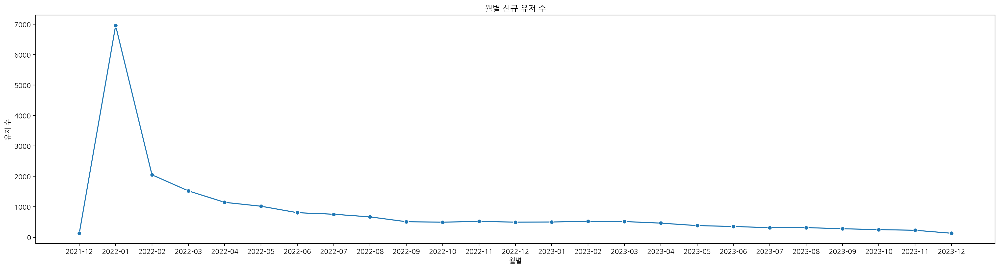

In [40]:
# 시각화
plt.figure(figsize=(25, 6))
sns.lineplot(data=monthly_users, x='year_month', y='count_new_users', marker='o')
plt.title('월별 신규 유저 수')
plt.xlabel('월별')
plt.ylabel('유저 수')
plt.show()

- 인사이트
    - 2021년 12월부터 2022년 1월 사이 신규 사용자 수가 급격히 증가했다. 이 시기는 대기업(예: 삼성, 현대 등)의 연말·연초 채용 시즌과 맞물렸을 가능성이 있으며, 이로 인해 채용 정보를 탐색하거나 지원하려는 사용자 유입이 크게 늘었을 것으로 추정된다.

### 기업이 첫 공고시점

In [41]:
first_company_register = company_df.groupby('company_uuid')['cdate'].min().reset_index()

In [42]:
first_company_register

,company_uuid,cdate
0,0000fda1-54e9-43ff-8c7b-8dcdf5efdb2a,2018-05-24 19:43:43
1,00027545-e75b-4b62-9d97-02eaa67618e7,2022-03-02 09:54:58
2,00034cb1-fd0f-497f-a53c-163e8e4f5b68,2018-06-01 00:15:00
3,00036983-4792-4737-92a8-463d424fbdf9,2022-12-08 13:43:43
4,00071b58-057a-4e1a-9265-cc6512e68f70,2015-08-03 17:27:59
...,...,...
41654,fffbb7a5-28dc-4ca5-88ea-938159536109,2019-10-08 06:45:10
41655,fffc54aa-6213-4d51-9ffc-5d7db523fe86,2020-04-20 07:11:17
41656,fffcc759-79b7-40be-aeee-47d6afce61cb,2016-03-21 15:24:51
41657,fffdf439-a33f-4fd3-8168-718d5cdf9bdc,2020-11-17 08:56:26


In [43]:
first_company_register['year_month'] = first_company_register['cdate'].dt.to_period('M')

In [44]:
monthly_company = first_company_register.groupby('year_month')['company_uuid'].nunique().reset_index()

In [45]:
monthly_company

,year_month,company_uuid
0,2013-01,120
1,2013-02,60
2,2013-03,22
3,2013-04,22
4,2013-05,41
...,...,...
127,2023-08,192
128,2023-09,154
129,2023-10,168
130,2023-11,172


In [46]:
# 위에서 구한 월별 신규 사용자 데이터랑 비교하기 위해 from 2021-12 to 2023-12 데이터만 필터링
filtered_df = monthly_company[(monthly_company['year_month'] >= '2021-12') & (monthly_company['year_month'] <= '2023-12')]

In [47]:
filtered_df.rename(columns={'company_uuid': 'monthly_registered_companies'}, inplace=True)

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/1380204514.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df.rename(columns={'company_uuid': 'monthly_registered_companies'}, inplace=True)


In [48]:
filtered_df['year_month'] = filtered_df['year_month'].astype(str)

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/1725394676.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  filtered_df['year_month'] = filtered_df['year_month'].astype(str)


In [49]:
filtered_df

,year_month,monthly_registered_companies
107,2021-12,425
108,2022-01,452
109,2022-02,382
110,2022-03,442
111,2022-04,406
112,2022-05,426
113,2022-06,427
114,2022-07,377
115,2022-08,322
116,2022-09,323


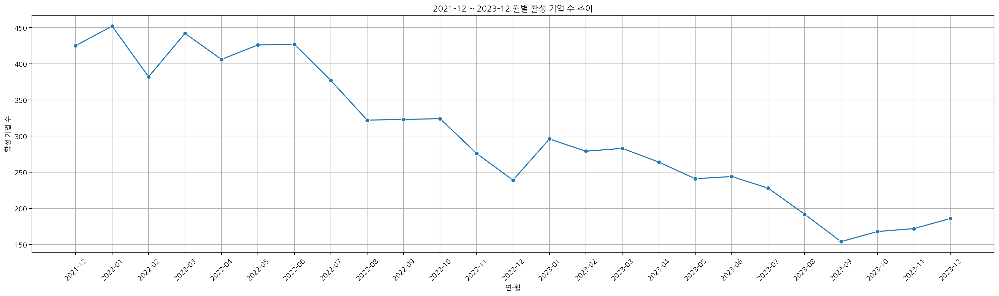

In [50]:
# 시각화
plt.figure(figsize=(20, 6))
sns.lineplot(
    data=filtered_df,
    x='year_month',
    y='monthly_registered_companies',
    marker='o'
)
plt.title('2021-12 ~ 2023-12 월별 활성 기업 수 추이')
plt.xlabel('연-월')
plt.ylabel('활성 기업 수')
plt.xticks(rotation=45)
plt.grid(True)
plt.tight_layout()
plt.show()

- 인사이트
    - 2021년 12월부터 2022년 1월 사이에 신규 방문한 구직자 수가 급격히 증가했으며, 같은 시기에 플랫폼에 등록한 기업 수 또한 크게 증가했다. 이로 미루어 볼 때, 해당 시기에 채용 수요가 집중된 채용 붐(boom)이 있었던 것으로 해석된다. 연말연시를 활용한 대규모 채용 시즌이 활발히 진행되었을 가능성이 높다.

### 채용 사이트 유입경로 분석

In [51]:
utm_df = log_df.copy()

In [52]:
utm_df['utm_source'] = utm_df['URL'].str.extract(r'utm_source=([^&]+)')
utm_df['utm_medium'] = utm_df['URL'].str.extract(r'utm_medium=([^&]+)')
utm_df['utm_campaign'] = utm_df['URL'].str.extract(r'utm_campaign=([^&]*)')

In [53]:
utm_filtered_df = utm_df[
    utm_df['utm_source'].notna() |
    utm_df['utm_medium'].notna() |
    utm_df['utm_campaign'].notna()
]

In [54]:
utm_filtered_df[['user_uuid', 'utm_source', 'utm_medium', 'utm_campaign']]

,user_uuid,utm_source,utm_medium,utm_campaign
20,8a7e70cd-1630-4a8a-8303-0706af3a7908,notification,email,friend_request
129,8a7e70cd-1630-4a8a-8303-0706af3a7908,notification,email,experience_verify
168,8a7e70cd-1630-4a8a-8303-0706af3a7908,google_jobs_apply,organic,google_jobs_apply
255,207a8876-2a6c-4137-9347-476ce719c541,notification,email,recommend_people
287,207a8876-2a6c-4137-9347-476ce719c541,notification,email,recommend_people
...,...,...,...,...
17241149,196c674b-f6fd-46a5-a122-4bc0128f9fb4,notification,email,update_company_member
17241431,accdcd8d-bf5e-4d1c-9d2f-b10726f94aeb,notification,email,new_user_alumni
17241801,31e774db-e214-43d5-908b-90cf17aa6886,notification,email,password_reset
17241805,f0cf23d1-9aba-4937-8966-af659f5a361c,notification,email,


In [55]:
utm_source_counts = utm_filtered_df['utm_source'].value_counts()

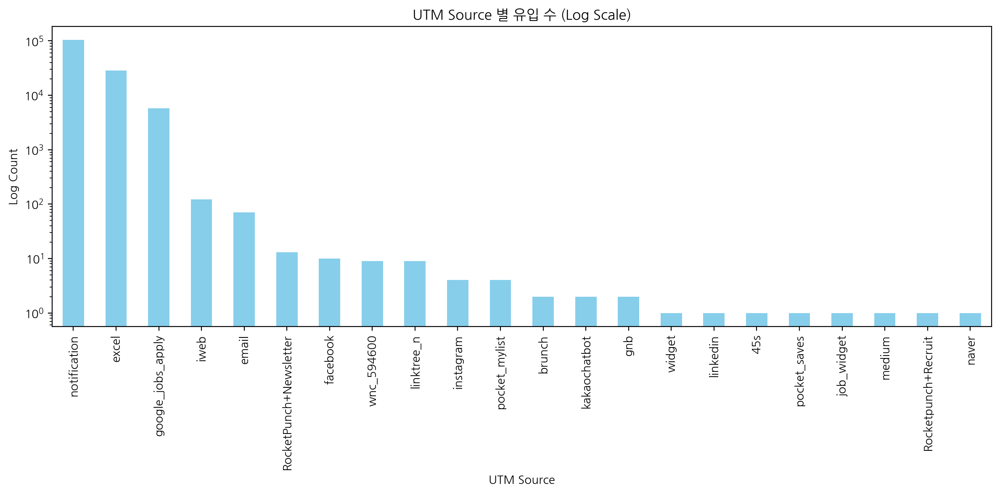

In [56]:
plt.figure(figsize=(12, 6))
utm_source_counts.plot(kind="bar", color='skyblue')
plt.yscale('log')
plt.title("UTM Source 별 유입 수 (Log Scale)")
plt.xlabel("UTM Source")
plt.ylabel("Log Count")
plt.tight_layout()
plt.show()

- 인사이트 💎
    - 유입 볼륨이 가장 높은 채널은 notification -> 알림 기능이 가장 강력한 유입원임.
    - excel, google_jobs_apply도 상당한 볼륨 -> 공유형/검색형 콘텐트도 강력함.
    - facebook, instagram등은 볼륨이 적음 -> SNS 광고 효과 재검토 필요.
    

In [57]:
utm_medium_counts = utm_filtered_df['utm_medium'].value_counts()
utm_medium_counts

utm_medium
email            101678
alink             28638
organic            5722
marketing           122
social               18
gamma                 9
click                 4
post                  4
widget                1
advertisement         1
Name: count, dtype: int64

In [58]:
# utm_source와 utm_medium의 조합 개수 세기
utm_combination_counts = utm_df.groupby(['utm_source', 'utm_medium']).size().reset_index(name='count')

top_10_utm_combinations = utm_combination_counts.sort_values(by='count', ascending=False).head(10)
top_10_utm_combinations

,utm_source,utm_medium,count
14,notification,email,101592
4,excel,alink,28638
7,google_jobs_apply,organic,5720
9,iweb,marketing,122
3,email,email,71
0,RocketPunch+Newsletter,email,13
13,linktree_n,social,9
16,wnc_594600,gamma,9
6,facebook,social,6
5,facebook,post,4


In [59]:
utm_combination_counts['utm_combined'] = utm_combination_counts['utm_source'] + ' / ' + utm_combination_counts['utm_medium']
utm_combination_counts = utm_combination_counts.sort_values('count', ascending=False)
utm_combination_counts

,utm_source,utm_medium,count,utm_combined
14,notification,email,101592,notification / email
4,excel,alink,28638,excel / alink
7,google_jobs_apply,organic,5720,google_jobs_apply / organic
9,iweb,marketing,122,iweb / marketing
3,email,email,71,email / email
0,RocketPunch+Newsletter,email,13,RocketPunch+Newsletter / email
13,linktree_n,social,9,linktree_n / social
16,wnc_594600,gamma,9,wnc_594600 / gamma
6,facebook,social,6,facebook / social
5,facebook,post,4,facebook / post


/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3245250271.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=utm_combination_counts, x='utm_combined', y='count', palette='Blues_d')


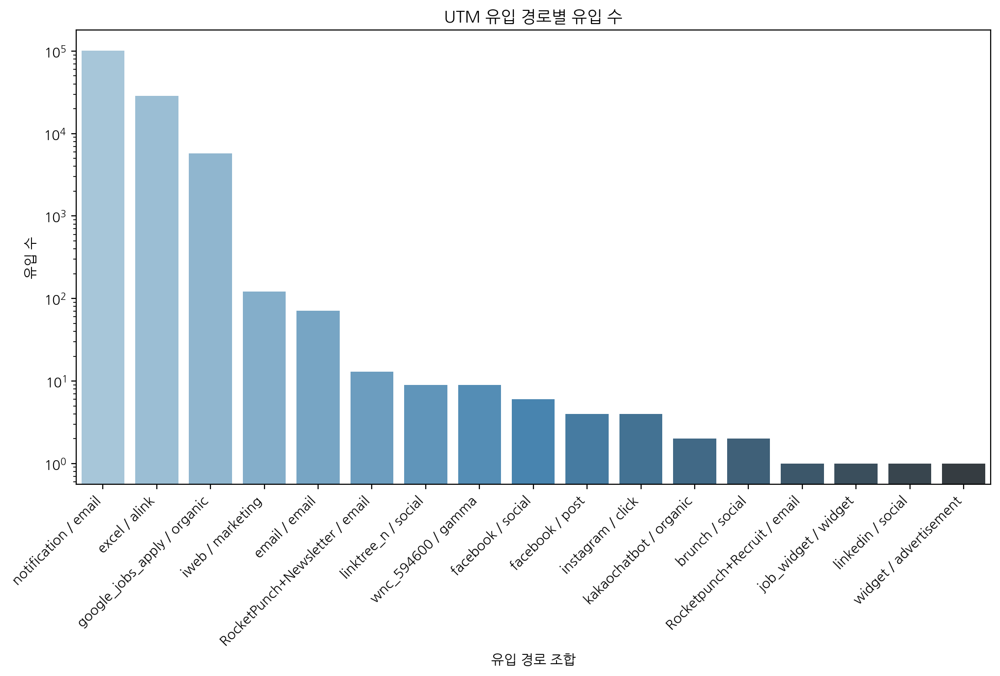

In [60]:
plt.figure(figsize=(12, 6))
sns.barplot(data=utm_combination_counts, x='utm_combined', y='count', palette='Blues_d')
plt.title('UTM 유입 경로별 유입 수')
plt.yscale('log')
plt.xlabel('유입 경로 조합')
plt.ylabel('유입 수')
plt.xticks(rotation=45, ha='right')
plt.show()

- 인사이트 💎
    - 가장 강력한 유입 경로는 notification + email, 즉 서비스 알림 이메일
    - excel + alink는 아마도 기업 또는 채용담당자가 엑셀 업로드로 등록한 공고를 통한 유입일 수 있음
    - google_jobs_apply + organic은 외부 검색 채널(구글)에서 자발적으로 유입된 사용자

In [61]:
utm_total_counts = utm_filtered_df.groupby(['utm_source', 'utm_medium', 'utm_campaign']).size().reset_index(name='count')
top10_utm_total = utm_total_counts.sort_values(by='count', ascending=False).head(10)

In [62]:
top10_utm_total

,utm_source,utm_medium,utm_campaign,count
41,notification,email,,36384
69,notification,email,job_matching,20655
16,excel,alink,jobs,17543
8,excel,alink,company,11037
82,notification,email,recommend_people,10666
35,google_jobs_apply,organic,google_jobs_apply,5720
60,notification,email,friend_request,4757
70,notification,email,job_offer,4321
47,notification,email,application_open,3916
57,notification,email,experience_verify,3399


In [63]:
top10_utm_total['combined'] = top10_utm_total['utm_source'] + ' / ' + top10_utm_total['utm_medium'] + ' / ' + top10_utm_total['utm_campaign']

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3347141653.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top10_utm_total, x='combined', y='count', palette='Blues_d')


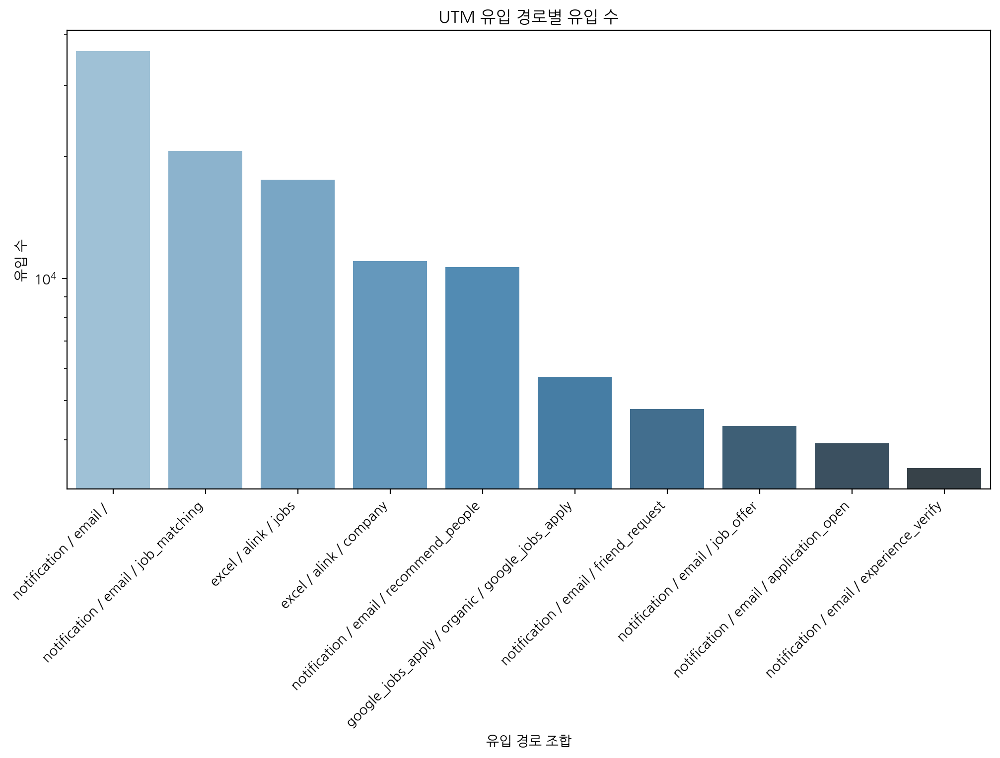

In [64]:
plt.figure(figsize=(12, 6))
sns.barplot(data=top10_utm_total, x='combined', y='count', palette='Blues_d')
plt.title('UTM 유입 경로별 유입 수')
plt.yscale('log')
plt.xlabel('유입 경로 조합')
plt.ylabel('유입 수')
plt.xticks(rotation=45, ha='right')
plt.show()

- 인사이트 💎
    - 메일 기반 유입이 가장 많았고, 개인화된 공고 알림이 효과적으로 작동했음 → 수신 동의를 유도하면 재방문 증가가 예상됨.
    - 엑셀을 통해 들어온 유저는 기업 내부 공유 또는 추천 리스트를 통한 유입으로 보임 → '공고 엑셀 내보내기' 기능 제공 시 추천 유입 확산 가능성 있음.
    - 구글 자연 검색을 통해 유입된 유저도 일정 비중 존재 → 공고 SEO 최적화를 통해 비용 없이 유입 증가를 기대할 수 있음.

### 최초 유입경로 탐색

In [65]:
first_visits = utm_df.sort_values('timestamp').groupby('user_uuid').first().reset_index()

In [66]:
first_visits

,user_uuid,URL,timestamp,date,response_code,method,utm_source,utm_medium,utm_campaign
0,0002535c-eacb-456b-a620-92c917332ba3,@user_id?action=request_approval_complete,2022-01-15 07:44:06.150657+00:00,2022-01-15,200,GET,notification,email,password_reset
1,0005769f-54b1-44ab-b6d3-bd9147c006a8,verify_phone?next_url=/companies/pyler,2022-11-07 04:42:24.760892+00:00,2022-11-07,200,GET,None,None,None
2,000681b4-bb66-4ccf-9786-f0066d13a34e,password_reset?code=d0308579-64c7-49b7-be8c-56...,2023-12-24 11:54:38.290138+00:00,2023-12-24,200,GET,notification,email,password_reset
3,000b55ad-5c86-438b-a5b0-9ea3a2917789,signup/detail,2023-06-21 11:01:34.663903+00:00,2023-06-21,302,GET,None,None,None
4,000d53f7-5ddd-48ba-8dab-bb77b157e13a,companies,2022-02-17 02:10:51.623535+00:00,2022-02-17,200,GET,None,None,None
...,...,...,...,...,...,...,...,...,...
21343,fff082bd-c063-4d10-be2d-b2b53f54527e,api/users/notifications/mark_read?id=4759532&_...,2022-12-22 08:07:12.244799+00:00,2022-12-22,200,GET,None,None,None
21344,fff3440e-7c0a-485b-a392-c41023060e96,continue?next=/jobs/139147/apply/step1,2023-01-02 03:16:13.747792+00:00,2023-01-02,302,GET,notification,email,email_verify
21345,fff45252-3c40-4805-99e9-6b650c1fca80,signup/detail?next_url=/signup/detail,2022-12-27 01:01:21.130353+00:00,2022-12-27,302,GET,notification,email,email_verify
21346,fff8a5c0-c85b-4e30-a22d-ed61b4480615,signup/detail,2022-03-23 11:57:34.460373+00:00,2022-03-23,302,GET,None,None,None


In [67]:
first_visits_utm = first_visits[['user_uuid', 'utm_source', 'utm_medium', 'utm_campaign']]
first_visits_utm

,user_uuid,utm_source,utm_medium,utm_campaign
0,0002535c-eacb-456b-a620-92c917332ba3,notification,email,password_reset
1,0005769f-54b1-44ab-b6d3-bd9147c006a8,None,None,None
2,000681b4-bb66-4ccf-9786-f0066d13a34e,notification,email,password_reset
3,000b55ad-5c86-438b-a5b0-9ea3a2917789,None,None,None
4,000d53f7-5ddd-48ba-8dab-bb77b157e13a,None,None,None
...,...,...,...,...
21343,fff082bd-c063-4d10-be2d-b2b53f54527e,None,None,None
21344,fff3440e-7c0a-485b-a392-c41023060e96,notification,email,email_verify
21345,fff45252-3c40-4805-99e9-6b650c1fca80,notification,email,email_verify
21346,fff8a5c0-c85b-4e30-a22d-ed61b4480615,None,None,None


In [68]:
# utm 컬럼에서 모두 null 값이면 제거
filtered_first_utm = first_visits_utm.dropna(subset=['utm_source', 'utm_medium', 'utm_campaign'], how='all')

In [69]:
filtered_first_utm

,user_uuid,utm_source,utm_medium,utm_campaign
0,0002535c-eacb-456b-a620-92c917332ba3,notification,email,password_reset
2,000681b4-bb66-4ccf-9786-f0066d13a34e,notification,email,password_reset
5,000e8610-16d3-4e9e-bf50-202d191ffac4,notification,email,recommend_people
6,0017a738-4fcc-441e-983b-a6033890a9db,notification,email,job_matching
9,002d8b33-d2bd-45cb-8485-6b761dbc9449,notification,email,
...,...,...,...,...
21341,ffee959d-51e1-41d1-b662-1e55c7c379bf,notification,None,None
21342,ffef51e0-b3b2-425c-9f29-2165dada54f0,notification,email,recommend_people
21344,fff3440e-7c0a-485b-a392-c41023060e96,notification,email,email_verify
21345,fff45252-3c40-4805-99e9-6b650c1fca80,notification,email,email_verify


In [70]:
first_visits_utm_count = filtered_first_utm.groupby(['utm_source', 'utm_medium', 'utm_campaign']).size().reset_index(name='count')
top_20_first_visits_utm = first_visits_utm_count.sort_values(by='count', ascending=False).head(20)
top_20_first_visits_utm

,utm_source,utm_medium,utm_campaign,count
29,notification,email,email_verify,1768
19,notification,email,,1611
30,notification,email,experience_verify,1523
52,notification,email,recommend_people,1371
39,notification,email,job_matching,1020
11,google_jobs_apply,organic,google_jobs_apply,782
32,notification,email,friend_request,685
49,notification,email,password_reset,477
40,notification,email,job_offer,440
24,notification,email,application_open,434


In [71]:
top_20_first_visits_utm['combine_utm'] = top_20_first_visits_utm['utm_source'] + ' / ' + top_20_first_visits_utm['utm_medium'] + ' / ' + top_20_first_visits_utm['utm_campaign']

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/2421998502.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=top_20_first_visits_utm, x='combine_utm', y='count', palette='Blues_d')


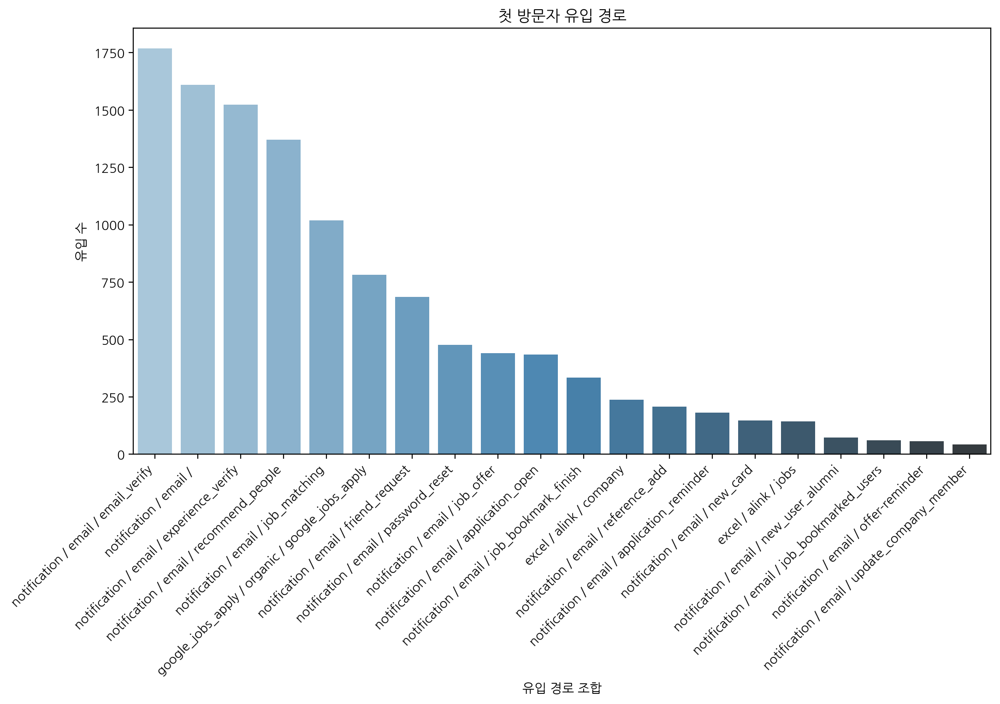

In [72]:
plt.figure(figsize=(12, 6))
sns.barplot(data=top_20_first_visits_utm, x='combine_utm', y='count', palette='Blues_d')
plt.title('첫 방문자 유입 경로')
plt.xlabel('유입 경로 조합')
plt.ylabel('유입 수')
plt.xticks(rotation=45, ha='right')
plt.show()

- 인사이트 💎
    - 이메일을 통해서 유입된 유저 수가 많음
        - 그중 가장 많은 이메일은 회원가입을 할 때 이메일을 기입하고 인증번호를 받는 경로로 들어간 유저가 많음
        - recommend_people 또한 큰 비중을 차지하는데 추천 메일을 통해 들어온 유저이며 질 높은 유저일 가능성이 높음 -> 추천을 많이 하는 유저에게는 보상을 제공 하는 이벤트 등을 진행시켜 신규 사용자들을 유입 시킬수 있다

## Activation

- 구직자: 첫 상세페이지 확인한 시점
- 기업: 첫 채용공고 등록 시점

### 기업의 공고 전환율

In [73]:
job_df.head()

,cdate,mdate,job_field,career_type_string,start_date,end_date,allow_remote,can_show_salary,job_uuid,company_uuid
0,2020-11-25 10:32:10,2020-11-25 10:32:10,SW 개발,"신입,경력,인턴",NaT,2020-11-25,1,0,764292b0-53f8-4f14-ac83-6eafc7a6a18d,daa34559-fc42-47f6-b5c6-cc6171404f37
1,2020-12-03 16:24:16,2020-12-03 16:24:16,HW 개발,인턴,2020-12-03,2020-12-04,1,0,b2b598d6-9ca3-4eb4-ac9c-bb57a6dad2ad,daa34559-fc42-47f6-b5c6-cc6171404f37
2,2019-06-13 08:47:25,2019-06-13 08:47:25,디자인,"신입,경력,인턴",2019-06-13,2019-06-21,0,0,017f4d7d-91a9-4ef7-9dd7-afabf7cbd26d,d4e7e647-8f85-4e7f-8609-7173cc240e18
3,2019-06-14 01:34:45,2019-07-02 00:28:35,마케팅,경력,2019-06-14,2019-07-15,0,0,41707ef1-f733-4f58-bb29-0b2e6175cf5e,d4e7e647-8f85-4e7f-8609-7173cc240e18
4,2019-07-02 00:28:58,2019-07-16 13:03:08,운영,"신입,경력",2019-07-02,2019-08-31,0,0,d0aa0eef-65d2-4e00-8177-968a2dc52009,d4e7e647-8f85-4e7f-8609-7173cc240e18


In [74]:
first_posting_df = job_df.copy()

In [75]:
first_posting_df = first_posting_df.groupby('company_uuid')['cdate'].min().reset_index()
first_posting_df.rename(columns={'cdate': 'first_posting_date'}, inplace=True)

In [76]:
first_posting_df['first_posting_date'] = first_posting_df['first_posting_date'].dt.to_period('M')
first_posting_df.head()

,company_uuid,first_posting_date
0,0000fda1-54e9-43ff-8c7b-8dcdf5efdb2a,2018-07
1,00027545-e75b-4b62-9d97-02eaa67618e7,2022-03
2,00071b58-057a-4e1a-9265-cc6512e68f70,2015-08
3,00093c2d-5734-4162-82e8-1def2a831408,2022-06
4,0009c5b4-eca5-482a-a9a0-3d08e106909d,2020-12


In [77]:
monthly_first_posting = first_posting_df.groupby('first_posting_date')['company_uuid'].size().reset_index(name='count')
monthly_first_posting

,first_posting_date,count
0,2013-01,62
1,2013-02,21
2,2013-03,22
3,2013-04,32
4,2013-05,27
...,...,...
127,2023-08,18
128,2023-09,21
129,2023-10,21
130,2023-11,23


In [78]:
monthly_first_posting['first_posting_date'] = monthly_first_posting['first_posting_date'].astype(str)

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3577050242.py:3: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.lineplot(data=monthly_first_posting, x='first_posting_date', y='count', palette='Blues_d')


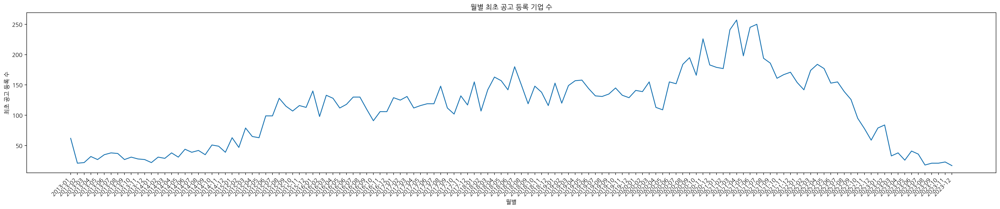

In [79]:
# 시각화
plt.figure(figsize=(30, 5))
sns.lineplot(data=monthly_first_posting, x='first_posting_date', y='count', palette='Blues_d')
plt.title('월별 최초 공고 등록 기업 수')
plt.xlabel('월별')
plt.ylabel('최초 공고 등록 수')
plt.xticks(rotation=45, ha='right')
plt.show()

In [80]:
# 고유한 기업 수
total_company = company_df['company_uuid'].nunique()

# 공고 등록 이력이 있는 기업: 중복 없이 company_id 기준으로
company_job_merge = pd.merge(company_df, job_df, on='company_uuid', how='inner')
active_company = company_job_merge['company_uuid'].nunique()
# 전환율
activation_rate_company = active_company / total_company
print(f"기업 공고 등록 전환율: {activation_rate_company:.2%}")

기업 공고 등록 전환율: 30.59%


- 전환율이 30.59%으로 낮은 값을 가짐
- 가입은 했는데 공고까지 안 올리는 기업이 69.41%
- 공고 등록 안 한 기업 속성 분석이 필요  

### 구직자의 상세페이지 진입 전환율

In [81]:
total_users = log_df['user_uuid'].nunique()
total_users

21348

In [82]:
job_detail_logs = log_df[log_df['URL'].str.contains(r'jobs/id/id_title')]
unique_users = job_detail_logs['user_uuid'].nunique()
print("공고 상세 페이지 진입 유저 수:", unique_users)

공고 상세 페이지 진입 유저 수: 16413


In [83]:
activation_rate_users = unique_users / total_users
print(f"상세페이지 진입 전환율: {activation_rate_users:.2%}")

상세페이지 진입 전환율: 76.88%


- 상세 페이지 진입 전환율이 76.88%가 나왔음
- 높은 전환율을 가지고 있다.
- 다음 단계 상세페이지를 진입하고 북마크를 한 유저의 전환율을 분석하는 단계가 필요!

### 구직자의 지원율

In [84]:
log_df_copy = log_df.copy()

In [85]:
# 방문자 수 집계
log_df_copy['year_month'] = log_df_copy['timestamp'].dt.to_period('M')
monthly_visitors = log_df_copy.groupby('year_month')['user_uuid'].nunique().reset_index()
monthly_visitors.columns = ['year_month', 'monthly_visitors']

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/879955103.py:2: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  log_df_copy['year_month'] = log_df_copy['timestamp'].dt.to_period('M')


In [86]:
monthly_visitors

,year_month,monthly_visitors
0,2021-12,133
1,2022-01,7078
2,2022-02,6481
3,2022-03,6644
4,2022-04,6359
5,2022-05,6553
6,2022-06,6323
7,2022-07,6291
8,2022-08,6254
9,2022-09,5670


In [87]:
application_df_copy = application_df.copy()

In [88]:
application_df_copy.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid
0,2017-02-25 23:45:01,2017,2,de4b3596-b4ab-47cd-b8ea-6f9e14170064,459e461d-a571-4ed3-8751-8f4cb5b9ff37,b0329bd7-fc45-4e83-993a-b73bd9d3549c,59c42363-f764-4cbd-aafd-20eb663ea5d7


In [89]:
# 지원자 수 집계
application_df_copy['year_month'] = application_df_copy['cdate'].dt.to_period('M')
monthly_applicants = application_df_copy.groupby('year_month')['user_uuid'].nunique().reset_index()
monthly_applicants.columns = ['year_month', 'monthly_applicants']

In [90]:
monthly_applicants = monthly_applicants[(monthly_applicants['year_month'] >= '2021-12') & (monthly_applicants['year_month'] <= '2023-12')]

In [91]:
monthly_applicants

,year_month,monthly_applicants
80,2021-12,889
81,2022-01,866
82,2022-02,818
83,2022-03,865
84,2022-04,865
85,2022-05,835
86,2022-06,741
87,2022-07,690
88,2022-08,728
89,2022-09,633


In [92]:
activation_apply_df = pd.merge(monthly_visitors, monthly_applicants, on='year_month', how='left')

In [93]:
activation_apply_df

,year_month,monthly_visitors,monthly_applicants
0,2021-12,133,889
1,2022-01,7078,866
2,2022-02,6481,818
3,2022-03,6644,865
4,2022-04,6359,865
5,2022-05,6553,835
6,2022-06,6323,741
7,2022-07,6291,690
8,2022-08,6254,728
9,2022-09,5670,633


In [94]:
# 지원 전환율 구하기
activation_apply_df['apply_conversion_rate'] = activation_apply_df['monthly_applicants'] / activation_apply_df['monthly_visitors'] * 100

In [95]:
activation_apply_df

,year_month,monthly_visitors,monthly_applicants,apply_conversion_rate
0,2021-12,133,889,668.421053
1,2022-01,7078,866,12.235095
2,2022-02,6481,818,12.621509
3,2022-03,6644,865,13.019266
4,2022-04,6359,865,13.602768
5,2022-05,6553,835,12.742255
6,2022-06,6323,741,11.719121
7,2022-07,6291,690,10.968050
8,2022-08,6254,728,11.640550
9,2022-09,5670,633,11.164021


- 2021-12은 방문자가 133명 밖에 안되서 전환율이 엄청 크게 나옴
- 2021-12 log 데이터가 일부 누락이 되었거나 12월 마지막 주를 시작으로 한 데이터일 수도 있음
- 2021-12 데이터는 분석에서 제외

In [96]:
activation_apply_df = activation_apply_df[activation_apply_df['year_month'] != '2021-12']

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/937646108.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  activation_apply_df['year_month_str'] = activation_apply_df['year_month'].astype(str)


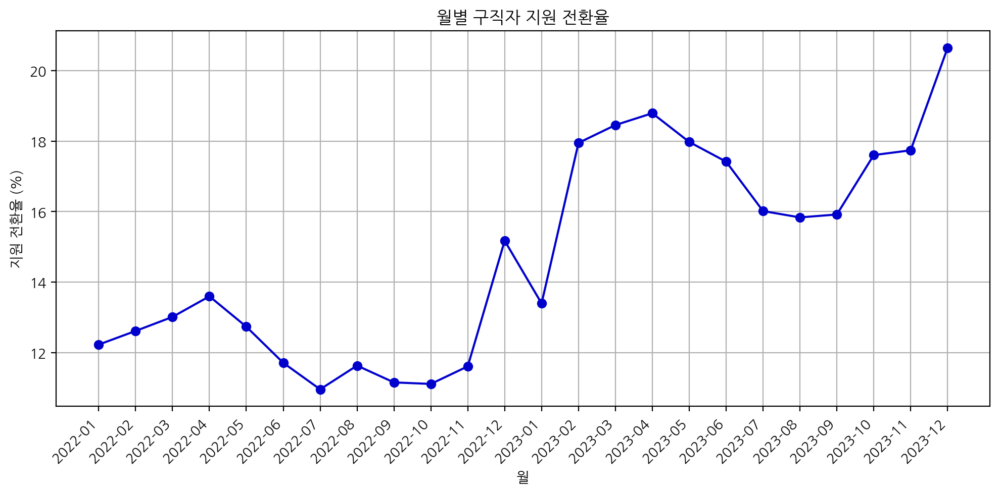

In [97]:
# 시각화
activation_apply_df['year_month_str'] = activation_apply_df['year_month'].astype(str)

plt.figure(figsize=(10, 5))
plt.plot(activation_apply_df['year_month_str'], activation_apply_df['apply_conversion_rate'], marker='o', color='mediumblue')
plt.title('월별 구직자 지원 전환율')
plt.xlabel('월')
plt.ylabel('지원 전환율 (%)')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

In [98]:
# 전체 지원율
total_visitors = activation_apply_df['monthly_visitors'].sum()
total_applicants = activation_apply_df['monthly_applicants'].sum()

total_apply_conversion_rate = total_applicants / total_visitors * 100
print(f'전체 지원 전환율: {total_apply_conversion_rate:.2f}')

전체 지원 전환율: 14.50


## Retention

### 재방문 EDA

In [99]:
log_df.head(1)

,user_uuid,URL,timestamp,date,response_code,method
0,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/search/language?name=한국어&_=1655915651225,2022-06-22 16:42:48.247454+00:00,2022-06-23,200,GET


In [100]:
retention_eda_df = log_df.copy()

In [101]:
monthly_visitors

,year_month,monthly_visitors
0,2021-12,133
1,2022-01,7078
2,2022-02,6481
3,2022-03,6644
4,2022-04,6359
5,2022-05,6553
6,2022-06,6323
7,2022-07,6291
8,2022-08,6254
9,2022-09,5670


In [102]:
retention_eda_df['timestamp'].min()

Timestamp('2021-12-31 15:00:00.532205+0000', tz='UTC')

In [103]:
retention_eda_df['timestamp'].max()

Timestamp('2023-12-31 14:55:13.117138+0000', tz='UTC')

- 로그 데이터가 2021-12-31 시작하여 12월달은 데이터의 샘플수가 작아 방문자 수가 적게 나왔음
- 2021-12은 분석에서 제외

In [104]:
monthly_visitors = monthly_visitors[monthly_visitors['year_month'] != '2021-12']
monthly_visitors

,year_month,monthly_visitors
1,2022-01,7078
2,2022-02,6481
3,2022-03,6644
4,2022-04,6359
5,2022-05,6553
6,2022-06,6323
7,2022-07,6291
8,2022-08,6254
9,2022-09,5670
10,2022-10,5620


In [105]:
monthly_visitors['year_month'] = monthly_visitors['year_month'].astype(str)

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3668054142.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  monthly_visitors['year_month'] = monthly_visitors['year_month'].astype(str)


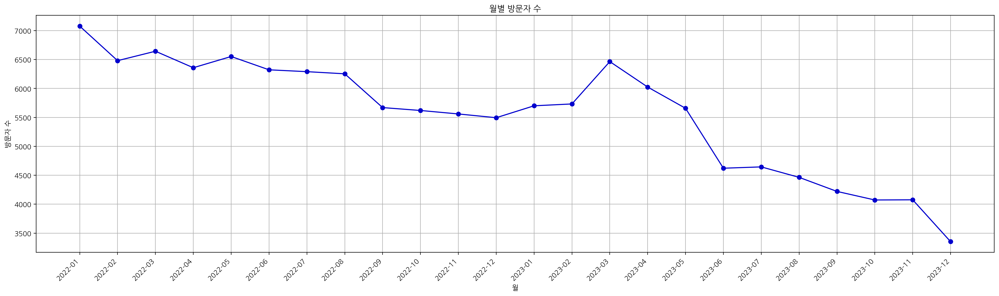

In [106]:
# 시각화
plt.figure(figsize=(20, 6))
plt.plot(monthly_visitors['year_month'].astype(str), monthly_visitors['monthly_visitors'], marker='o', color='mediumblue')
plt.title('월별 방문자 수')
plt.xlabel('월')
plt.ylabel('방문자 수')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

In [107]:
# 2022년 방문자 수
monthly_visitors['year_month'] = pd.to_datetime(monthly_visitors['year_month'])
visitors_2022 =  monthly_visitors[(monthly_visitors['year_month'] >= '2022-01') & (monthly_visitors['year_month'] <= '2022-12')]
visitors_2022

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/1378093940.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  monthly_visitors['year_month'] = pd.to_datetime(monthly_visitors['year_month'])


,year_month,monthly_visitors
1,2022-01-01,7078
2,2022-02-01,6481
3,2022-03-01,6644
4,2022-04-01,6359
5,2022-05-01,6553
6,2022-06-01,6323
7,2022-07-01,6291
8,2022-08-01,6254
9,2022-09-01,5670
10,2022-10-01,5620


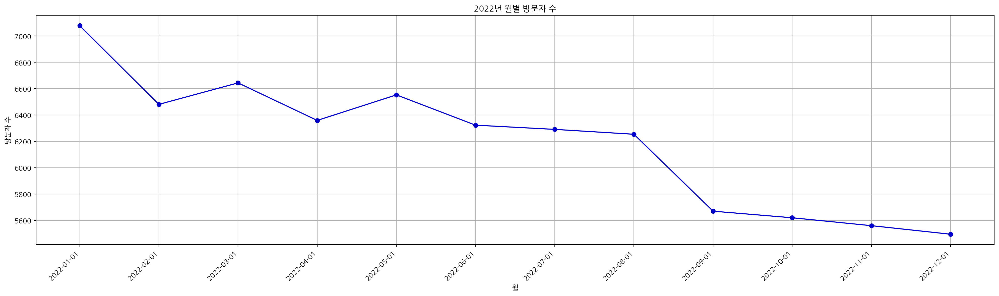

In [108]:
# 시각화
plt.figure(figsize=(20, 6))
plt.plot(visitors_2022['year_month'].astype(str), visitors_2022['monthly_visitors'], marker='o', color='mediumblue')
plt.title('2022년 월별 방문자 수')
plt.xlabel('월')
plt.ylabel('방문자 수')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

- 1~3월: 6600~7100명대 -> 비교적 높음
- 4~6월: 6300명대 -> 점차 안정화
- 7월 이후: 6000명 이하로 감소하고 계속 감소세

In [109]:
# 2023 방문자 수
visitors_2023 = monthly_visitors[(monthly_visitors['year_month'] >= '2023-01') & (monthly_visitors['year_month'] <= '2023-12')]
visitors_2023

,year_month,monthly_visitors
13,2023-01-01,5701
14,2023-02-01,5733
15,2023-03-01,6465
16,2023-04-01,6025
17,2023-05-01,5658
18,2023-06-01,4622
19,2023-07-01,4645
20,2023-08-01,4464
21,2023-09-01,4221
22,2023-10-01,4073


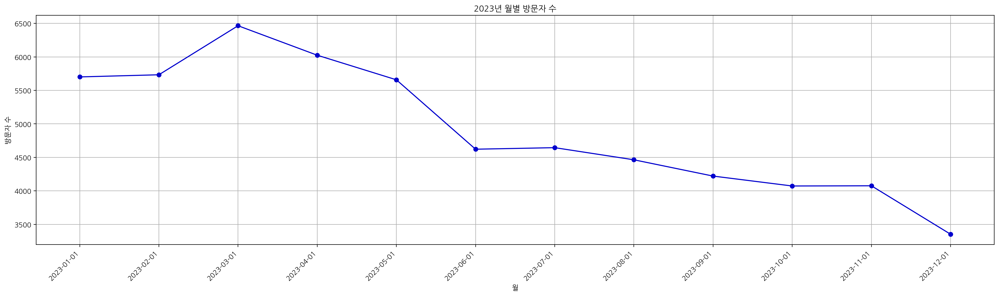

In [110]:
# 시각화
plt.figure(figsize=(20, 6))
plt.plot(visitors_2023['year_month'].astype(str), visitors_2023['monthly_visitors'], marker='o', color='mediumblue')
plt.title('2023년 월별 방문자 수')
plt.xlabel('월')
plt.ylabel('방문자 수')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

- 1~3월: 방문자 수 평균 약 6000명 내외
- 4월~12월: 지속적인 감소 → 6월 이후부터 5000명 미만 유지, 12월에는 3300명대

- 2~4월에는 방문자 수가 많음
- 코호트는 2~4월 기준으로 12월까지 리텐션 기간을 설정한다.

### 지원서 작성 EDA

In [111]:
monthly_applicants

,year_month,monthly_applicants
80,2021-12,889
81,2022-01,866
82,2022-02,818
83,2022-03,865
84,2022-04,865
85,2022-05,835
86,2022-06,741
87,2022-07,690
88,2022-08,728
89,2022-09,633


In [112]:
# 2022년 월별 지원서 작성 수
monthly_applicants_2022 = monthly_applicants[(monthly_applicants['year_month'] >= '2022-01') & (monthly_applicants['year_month'] <= '2022-12')]
monthly_applicants_2022

,year_month,monthly_applicants
81,2022-01,866
82,2022-02,818
83,2022-03,865
84,2022-04,865
85,2022-05,835
86,2022-06,741
87,2022-07,690
88,2022-08,728
89,2022-09,633
90,2022-10,625


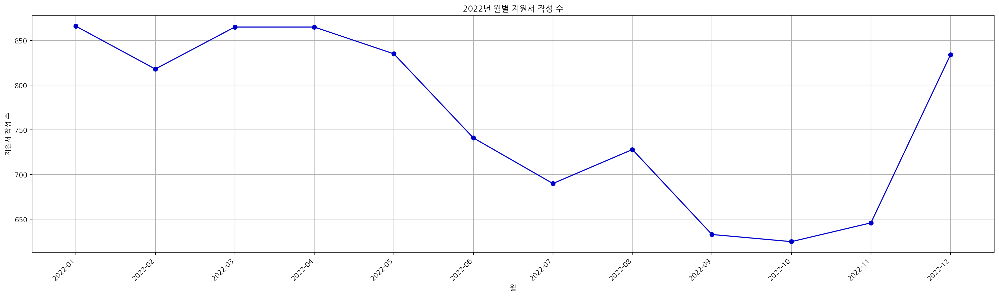

In [113]:
# 시각화
plt.figure(figsize=(20, 6))
plt.plot(monthly_applicants_2022['year_month'].astype(str), monthly_applicants_2022['monthly_applicants'], marker='o', color='mediumblue')
plt.title('2022년 월별 지원서 작성 수')
plt.xlabel('월')
plt.ylabel('지원서 작성 수')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

In [114]:
application_df_copy

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,year_month
0,2017-02-25 23:45:01.000000,2017,2,de4b3596-b4ab-47cd-b8ea-6f9e14170064,459e461d-a571-4ed3-8751-8f4cb5b9ff37,b0329bd7-fc45-4e83-993a-b73bd9d3549c,59c42363-f764-4cbd-aafd-20eb663ea5d7,2017-02
1,2020-11-23 14:46:07.329731,2020,11,f6156b12-d4d7-469f-84be-31799c765211,e5ed4f4a-08aa-4f2d-9042-1e9bbd36803f,b0329bd7-fc45-4e83-993a-b73bd9d3549c,425db0e8-87f8-4b4d-8248-7f24c31d49d3,2020-11
2,2017-10-28 22:30:10.631568,2017,10,2ed05b18-c735-474a-9faa-02095b25729a,0f636d7a-53f7-485e-8a08-33253ddab380,b0329bd7-fc45-4e83-993a-b73bd9d3549c,be4d9e85-dc53-4e70-90af-64d2d6b117d2,2017-10
3,2017-07-03 17:40:05.317255,2017,7,3d6730ee-b869-47b7-90c6-1e074e4eb15b,3cade56a-6354-411a-82a6-f2c7774539c1,b0329bd7-fc45-4e83-993a-b73bd9d3549c,d43879d1-c424-4192-9eae-4537fa6687cb,2017-07
4,2017-02-10 10:53:39.000000,2017,2,de4b3596-b4ab-47cd-b8ea-6f9e14170064,459e461d-a571-4ed3-8751-8f4cb5b9ff37,a7593a15-b93e-4bc3-91bf-e4074c931d33,61873fd7-f075-44c0-90fe-f6521226550d,2017-02
...,...,...,...,...,...,...,...,...
340725,2021-05-09 16:48:46.908545,2021,5,214c0ee9-4fc9-46be-ba8a-2a0368510e80,201fda38-4fbd-4541-aa27-c0a529e26c83,e5cb061e-3ca1-438a-8eb2-e50bd4f133e0,ecd4d247-8e03-4830-a4e8-c1ecb68ddf74,2021-05
340726,2022-03-20 22:21:29.175182,2022,3,214c0ee9-4fc9-46be-ba8a-2a0368510e80,a82d7bd3-87ee-4eaf-9519-1b60a331a474,dc1fb548-59dd-47bc-82aa-99d92e70f793,0ab0adef-da09-4381-baf7-a3fb017c19ea,2022-03
340727,2022-04-07 09:41:05.036134,2022,4,565e7499-1070-49c5-a3b9-a27e5ca27a9e,744ab632-8193-406a-bd51-3e2c9ddd4544,1e311075-359d-40fd-b606-f74cb1819499,bbd1050f-3729-45d9-8404-c8ad75dc5131,2022-04
340728,2022-07-15 04:22:09.138346,2022,7,79d4e2b6-e8df-4605-9c2c-b00e73698b61,5faf63f9-848e-4286-a07c-992c0883115d,7ba43545-bf1c-465e-8996-e55231b020c6,43107da9-ff4d-4e62-9dd2-1b2df5a9ae78,2022-07


In [115]:
# 주차기준 지원서 작성 수
application_2022_df = application_df_copy[application_df_copy['Year'] == 2022]
application_2022_df['week'] = application_2022_df['cdate'].dt.to_period('W')
weekly_applicants = application_2022_df.groupby('week')['user_uuid'].nunique().reset_index(name='weekly_applicants')

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/339164214.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  application_2022_df['week'] = application_2022_df['cdate'].dt.to_period('W')


In [116]:
weekly_applicants

,week,weekly_applicants
0,2021-12-27/2022-01-02,52
1,2022-01-03/2022-01-09,283
2,2022-01-10/2022-01-16,290
3,2022-01-17/2022-01-23,289
4,2022-01-24/2022-01-30,271
5,2022-01-31/2022-02-06,222
6,2022-02-07/2022-02-13,316
7,2022-02-14/2022-02-20,270
8,2022-02-21/2022-02-27,287
9,2022-02-28/2022-03-06,262


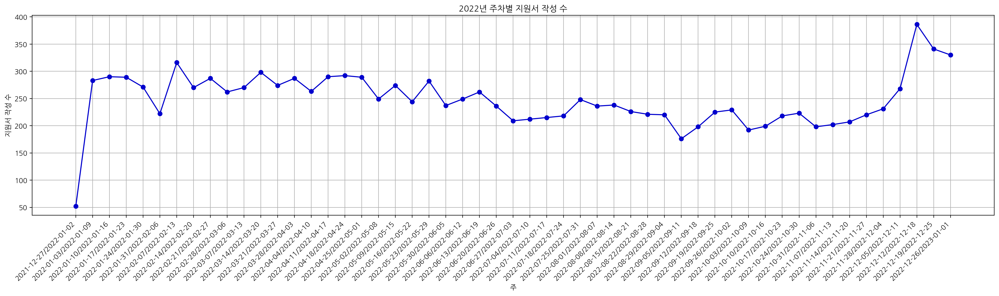

In [117]:
# 시각화
plt.figure(figsize=(20, 6))
plt.plot(weekly_applicants['week'].astype(str), weekly_applicants['weekly_applicants'], marker='o', color='mediumblue')
plt.title('2022년 주차별 지원서 작성 수')
plt.xlabel('주')
plt.ylabel('지원서 작성 수')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

In [118]:
application_2022_df.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,year_month,week
163,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01-17/2022-01-23


In [119]:
# 분기별 지원서 작성 수
application_2022_df['quarter'] = application_2022_df['cdate'].dt.to_period('Q')
quarterly_applicants = application_2022_df.groupby('quarter')['user_uuid'].nunique().reset_index(name='quarterly_applicants')

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/4225847397.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  application_2022_df['quarter'] = application_2022_df['cdate'].dt.to_period('Q')


In [120]:
quarterly_applicants

,quarter,quarterly_applicants
0,2022Q1,2023
1,2022Q2,1973
2,2022Q3,1618
3,2022Q4,1682


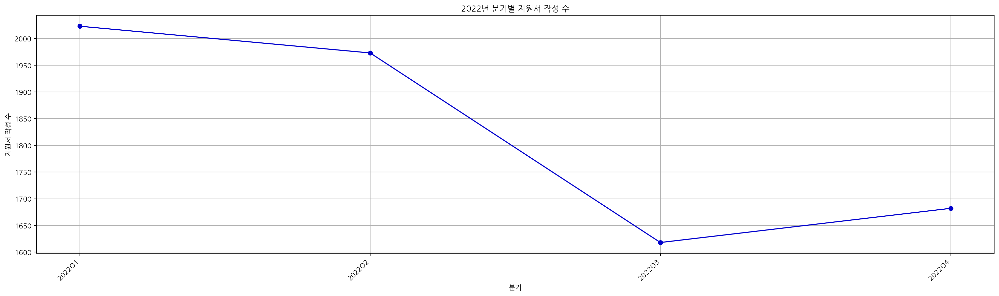

In [121]:
# 시각화
plt.figure(figsize=(20, 6))
plt.plot(quarterly_applicants['quarter'].astype(str), quarterly_applicants['quarterly_applicants'], marker='o', color='mediumblue')
plt.title('2022년 분기별 지원서 작성 수')
plt.xlabel('분기')
plt.ylabel('지원서 작성 수')
plt.xticks(rotation=45, ha='right')
plt.grid(True)
plt.tight_layout()
plt.show()

In [122]:
# 사용자별로 지원서 작성 정렬
application_2022_df = application_2022_df.sort_values(by=['user_uuid', 'cdate'])

In [123]:
# 사용자별 application_date 간격 계산
application_2022_df['prev_application'] = application_2022_df.groupby('user_uuid')['cdate'].shift() # 이전 행의 날짜를 가져오는 코드
application_2022_df['days_between'] = (application_2022_df['cdate'] - application_2022_df['prev_application']).dt.days

In [124]:
application_2022_df.head(5)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,year_month,week,quarter,prev_application,days_between
101433,2022-07-23 04:08:40.218854,2022,7,e0cc5e3e-ed0c-46a2-aa02-8b77cbdc3238,137ac7a7-0594-47c1-bceb-e5358392b534,0002535c-eacb-456b-a620-92c917332ba3,87baa2e7-de55-4a8e-95e5-a8589d76d6c1,2022-07,2022-07-18/2022-07-24,2022Q3,NaT,NaN
101434,2022-10-19 01:35:40.771329,2022,10,6288901e-ba08-4b3e-8879-c05bab6001bb,e0dcb7c5-07a8-4e04-a080-7656a63c77f8,0002535c-eacb-456b-a620-92c917332ba3,78fcaf3e-a89f-4b54-aae9-6f65ef229438,2022-10,2022-10-17/2022-10-23,2022Q4,2022-07-23 04:08:40.218854,87.0
337222,2022-04-19 08:19:39.676488,2022,4,8edc9504-11c5-4ee2-814b-4c21d324f21e,f5fcff9a-4aab-4c56-bf78-2ec31a418175,0017a738-4fcc-441e-983b-a6033890a9db,148a0011-3f0c-4e4b-ae8e-ef2b1a5fa695,2022-04,2022-04-18/2022-04-24,2022Q2,NaT,NaN
303042,2022-08-17 08:33:34.811125,2022,8,4c73e845-f0bf-45f2-bf5e-c681ee065bc8,a080da3f-8059-44db-b82c-7cc830e0c52f,003a83bd-6cb7-4f99-ab3a-66904df762e2,5b107b98-acff-4beb-aca1-9c6e1d782968,2022-08,2022-08-15/2022-08-21,2022Q3,NaT,NaN
336852,2022-01-14 08:34:45.113458,2022,1,250c32ff-25bd-4f51-9343-bf7e870b995e,44ef2c7a-6def-49e3-a19b-8b53f836612e,00495153-f908-4523-9d0d-5b93a57196a4,5995982d-264d-4802-bc91-0a2250e3bb0f,2022-01,2022-01-10/2022-01-16,2022Q1,NaT,NaN


In [125]:
# 유저별 평균 지원 간격 계산
user_gap_df = application_2022_df.groupby('user_uuid')['days_between'].mean().reset_index()
user_gap_df.columns = ['user_uuid', 'avg_days_between']

In [126]:
user_gap_df

,user_uuid,avg_days_between
0,0002535c-eacb-456b-a620-92c917332ba3,87.000000
1,0017a738-4fcc-441e-983b-a6033890a9db,NaN
2,003a83bd-6cb7-4f99-ab3a-66904df762e2,NaN
3,00495153-f908-4523-9d0d-5b93a57196a4,20.500000
4,004a89cc-d69b-4336-9905-4fd306e3ef80,0.485714
...,...,...
5840,ffbcbc12-a9f9-4605-83b4-b5d8af393533,0.166667
5841,ffc31c75-38c5-4574-906f-4efee3e9b319,NaN
5842,ffd75368-f7ed-4eaf-9db9-0f76ef80af31,1.500000
5843,ffde47f8-497e-4385-b708-31f22417b2cd,0.000000


In [127]:
# 전체 유저 평균
overall_avg = user_gap_df['avg_days_between'].mean()
overall_avg

12.358771090397513

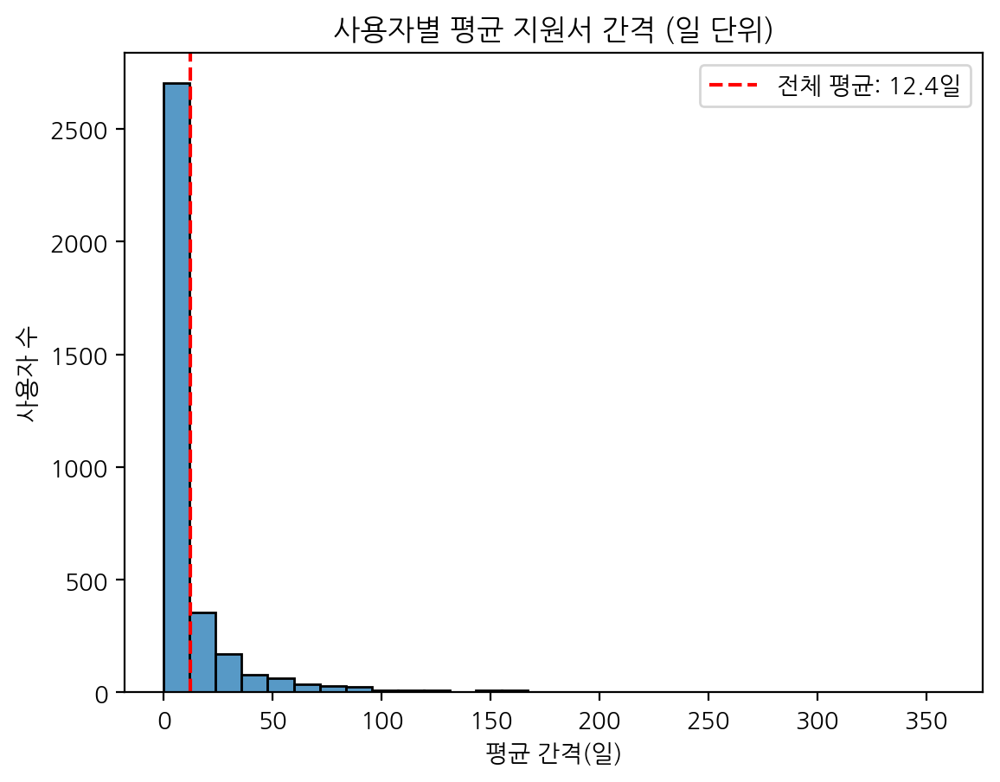

In [128]:
sns.histplot(user_gap_df['avg_days_between'], bins=30)
plt.axvline(overall_avg, color='red', linestyle='--', label=f'전체 평균: {overall_avg:.1f}일')
plt.title("사용자별 평균 지원서 간격 (일 단위)")
plt.xlabel("평균 간격(일)")
plt.ylabel("사용자 수")
plt.legend()
plt.show()

- 평균 12.4일 -> 한 달을 기준으로 하면, 중간에 이탈한 유저도 많아질 수 있음
- 주차 또는 격주 단위로 리텐션 분석이 적합

### 격주별 지원서 작성 리텐션(2022년)

- Step 1: 사용자별 최초 지원일 추출 & Cohort 설정

In [129]:
application_2022_df.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,year_month,week,quarter,prev_application,days_between
101433,2022-07-23 04:08:40.218854,2022,7,e0cc5e3e-ed0c-46a2-aa02-8b77cbdc3238,137ac7a7-0594-47c1-bceb-e5358392b534,0002535c-eacb-456b-a620-92c917332ba3,87baa2e7-de55-4a8e-95e5-a8589d76d6c1,2022-07,2022-07-18/2022-07-24,2022Q3,NaT,NaN


In [130]:
application_2022_df['date'] = application_2022_df['cdate'].dt.to_period('D')

In [131]:
# 유저 별 최초 지원일
user_first_apply = application_2022_df.groupby('user_uuid')['date'].min().reset_index()
user_first_apply.columns = ['user_uuid', 'cohort_date']

In [132]:
application_2022_df = application_2022_df.merge(user_first_apply, on='user_uuid')

In [133]:
application_2022_df[['user_uuid', 'date', 'cohort_date']].head()

,user_uuid,date,cohort_date
0,0002535c-eacb-456b-a620-92c917332ba3,2022-07-23,2022-07-23
1,0002535c-eacb-456b-a620-92c917332ba3,2022-10-19,2022-07-23
2,0017a738-4fcc-441e-983b-a6033890a9db,2022-04-19,2022-04-19
3,003a83bd-6cb7-4f99-ab3a-66904df762e2,2022-08-17,2022-08-17
4,00495153-f908-4523-9d0d-5b93a57196a4,2022-01-14,2022-01-14


- cohort_date: 각 유저의 리텐션 기준일. 이 기준일을 기준으로 이후 활동을 추적

- Step 2: 기준일로부터 경과일 계산 -> 리텐션 주기 분류

In [134]:
application_2022_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42604 entries, 0 to 42603
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   cdate             42604 non-null  datetime64[ns]
 1   Year              42604 non-null  int64         
 2   Month             42604 non-null  int64         
 3   company_uuid      42604 non-null  object        
 4   job_uuid          42604 non-null  object        
 5   user_uuid         42604 non-null  object        
 6   application_uuid  42604 non-null  object        
 7   year_month        42604 non-null  period[M]     
 8   week              42604 non-null  period[W-SUN] 
 9   quarter           42604 non-null  period[Q-DEC] 
 10  prev_application  36759 non-null  datetime64[ns]
 11  days_between      36759 non-null  float64       
 12  date              42604 non-null  period[D]     
 13  cohort_date       42604 non-null  period[D]     
dtypes: datetime64[ns](2), 

In [135]:
application_2022_df['date'] = application_2022_df['date'].dt.to_timestamp()
application_2022_df['cohort_date'] = application_2022_df['cohort_date'].dt.to_timestamp()

In [136]:
# 경과일 계산
application_2022_df['days_since_first'] = (application_2022_df['date'] - application_2022_df['cohort_date']).dt.days

# 14일 단위 리텐션 그룹 (0~13일: week 1, 14~27일: week 2, ...)
application_2022_df['retention_period'] = (application_2022_df['days_since_first'] // 14).astype(int)

- Step 3: 리텐션 매트릭스 만들기

In [137]:
retention_counts = (application_2022_df.groupby(['cohort_date', 'retention_period'])['user_uuid'].nunique().reset_index())

In [138]:
retention_counts

,cohort_date,retention_period,user_uuid
0,2022-01-01,0,26
1,2022-01-01,1,11
2,2022-01-01,2,7
3,2022-01-01,3,6
4,2022-01-01,4,4
...,...,...,...
2693,2022-12-27,0,14
2694,2022-12-28,0,13
2695,2022-12-29,0,11
2696,2022-12-30,0,21


In [139]:
# 피벗 테이블로 정리 (row: cohort_date, column: retention_period)
retention_matrix = retention_counts.pivot(
    index='cohort_date',
    columns='retention_period',
    values='user_uuid'
).fillna(0).astype(int)

retention_matrix

retention_period,0,1,2,3,4,5,6,7,8,9,...,17,18,19,20,21,22,23,24,25,26
cohort_date,,,,,,,,,,,,,,,,,,,,,
2022-01-01,26,11,7,6,4,4,4,3,5,1,...,3,3,3,3,3,3,3,3,2,1
2022-01-02,26,7,8,4,2,3,1,1,4,1,...,1,1,1,3,0,1,1,1,0,0
2022-01-03,59,17,10,6,5,5,6,4,5,4,...,2,2,1,2,0,1,0,0,1,0
2022-01-04,47,15,10,6,9,7,3,2,1,1,...,3,2,1,1,0,2,1,2,3,0
2022-01-05,37,8,8,6,6,5,4,3,6,4,...,4,5,2,4,4,4,1,4,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-27,14,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2022-12-28,13,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2022-12-29,11,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


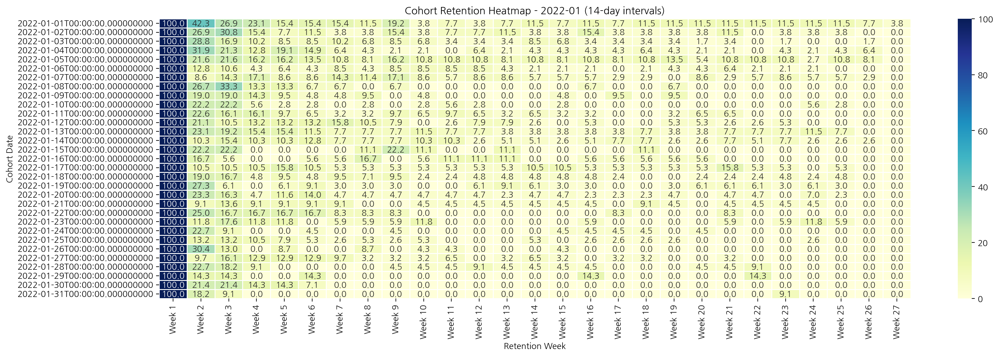

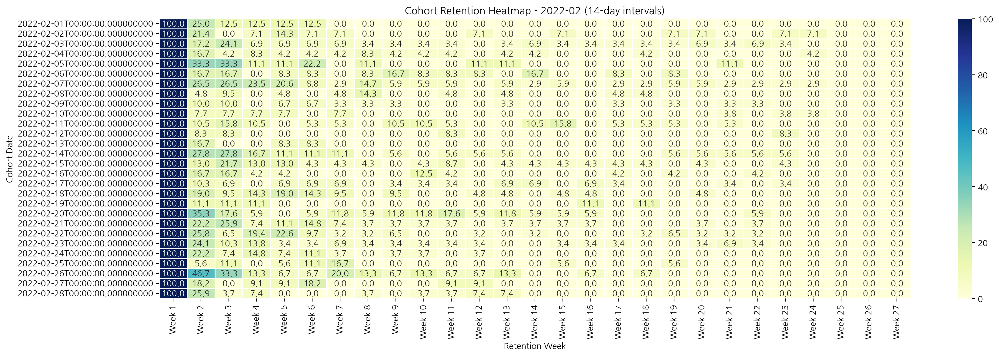

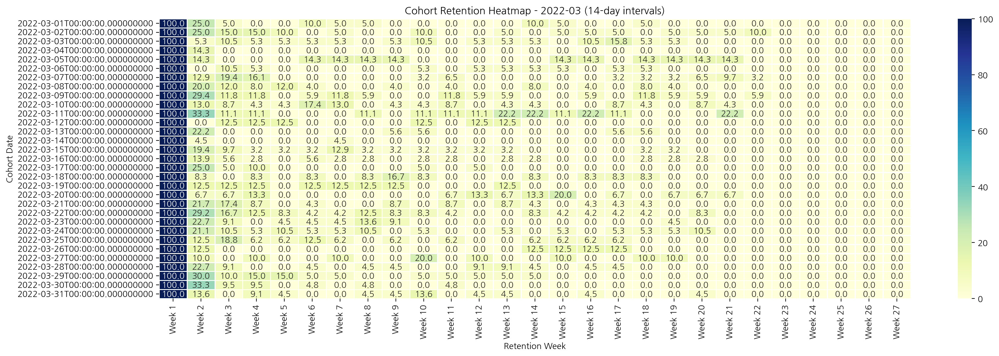

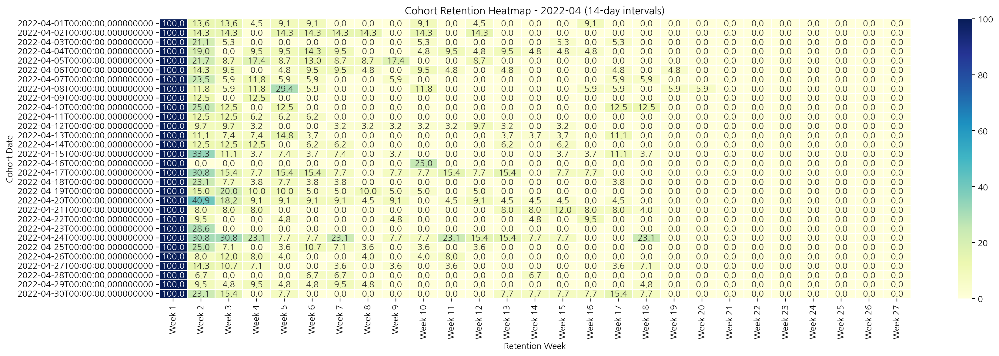

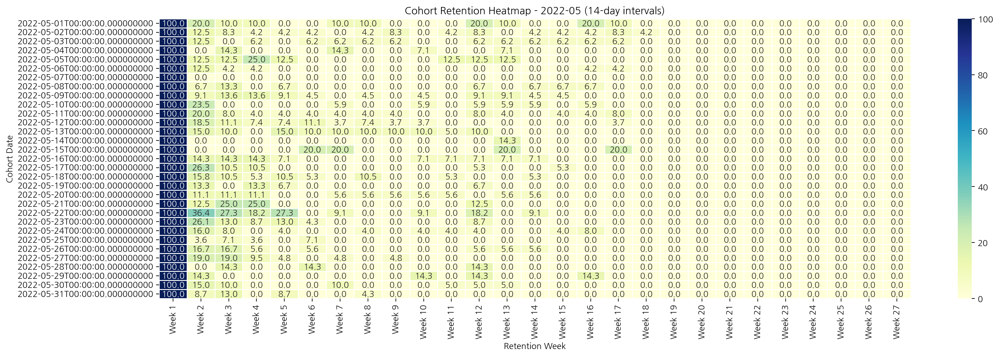

...

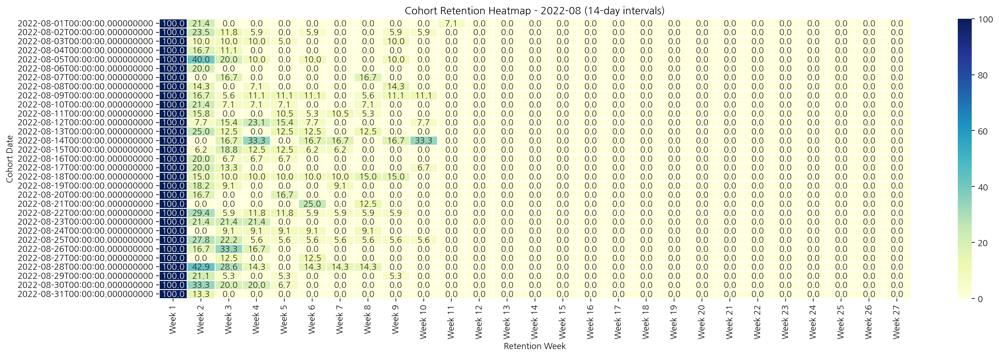

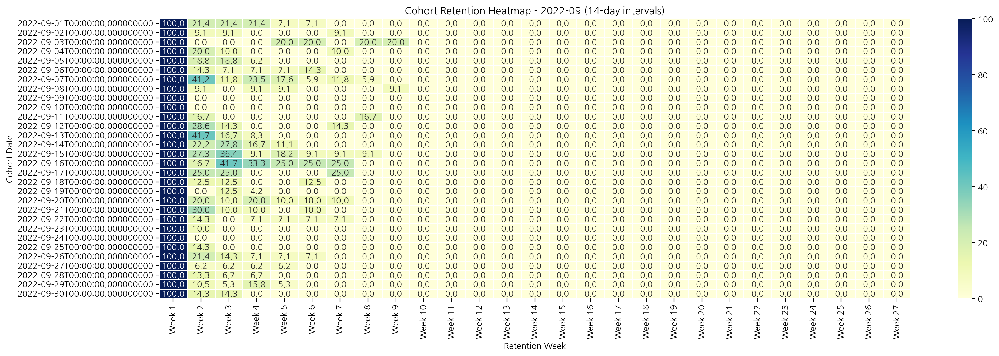

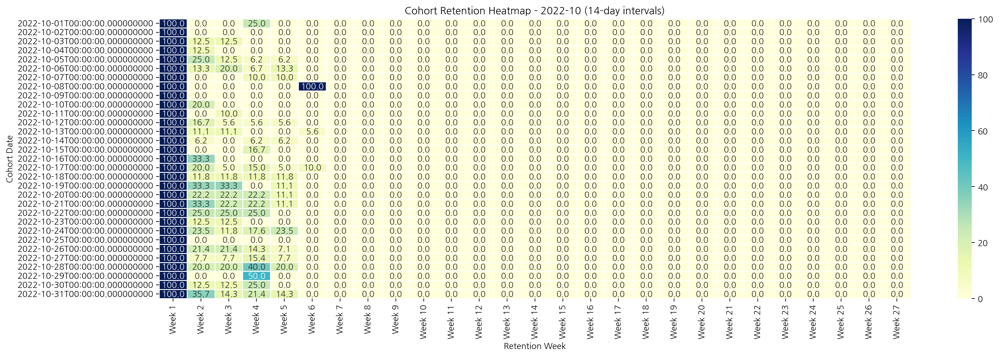

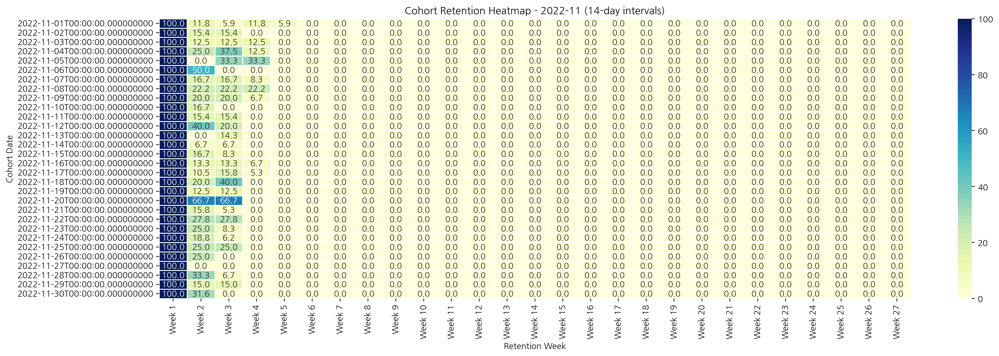

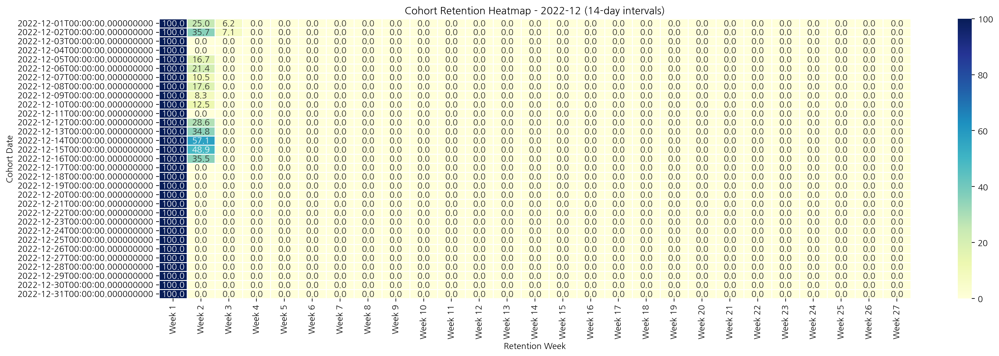

In [140]:
# 1. 코호트 크기 계산 및 리텐션 비율 변환
cohort_size = retention_matrix.iloc[:, 0]
retention_matrix_pct = (retention_matrix.div(cohort_size, axis=0)) * 100
retention_matrix_pct.iloc[:, 0] = 100.0  # 첫 주 100% 설정

# 2. 열 이름 직관적으로 변경
retention_matrix_pct.columns = [f"Week {i+1}" for i in retention_matrix_pct.columns]

# 3. 월별 그룹화 및 시각화
monthly_groups = retention_matrix_pct.groupby(lambda x: x.strftime('%Y-%m'))

for month, cohort_data in monthly_groups:
    plt.figure(figsize=(20, 6))
    sns.heatmap(
        cohort_data,
        cmap="YlGnBu",
        annot=True,
        fmt=".1f",
        vmin=0,
        vmax=100,
        linewidths=0.5
    )
    plt.title(f"Cohort Retention Heatmap - {month} (14-day intervals)")
    plt.xlabel("Retention Week")
    plt.ylabel("Cohort Date")
    plt.show()

### 월별 지원서 작성 리텐션(2022년)

In [141]:
application_2022_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42604 entries, 0 to 42603
Data columns (total 16 columns):
 #   Column            Non-Null Count  Dtype         
---  ------            --------------  -----         
 0   cdate             42604 non-null  datetime64[ns]
 1   Year              42604 non-null  int64         
 2   Month             42604 non-null  int64         
 3   company_uuid      42604 non-null  object        
 4   job_uuid          42604 non-null  object        
 5   user_uuid         42604 non-null  object        
 6   application_uuid  42604 non-null  object        
 7   year_month        42604 non-null  period[M]     
 8   week              42604 non-null  period[W-SUN] 
 9   quarter           42604 non-null  period[Q-DEC] 
 10  prev_application  36759 non-null  datetime64[ns]
 11  days_between      36759 non-null  float64       
 12  date              42604 non-null  datetime64[ns]
 13  cohort_date       42604 non-null  datetime64[ns]
 14  days_since_first  4260

In [142]:
application_2022_df.head()

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,year_month,week,quarter,prev_application,days_between,date,cohort_date,days_since_first,retention_period
0,2022-07-23 04:08:40.218854,2022,7,e0cc5e3e-ed0c-46a2-aa02-8b77cbdc3238,137ac7a7-0594-47c1-bceb-e5358392b534,0002535c-eacb-456b-a620-92c917332ba3,87baa2e7-de55-4a8e-95e5-a8589d76d6c1,2022-07,2022-07-18/2022-07-24,2022Q3,NaT,NaN,2022-07-23,2022-07-23,0,0
1,2022-10-19 01:35:40.771329,2022,10,6288901e-ba08-4b3e-8879-c05bab6001bb,e0dcb7c5-07a8-4e04-a080-7656a63c77f8,0002535c-eacb-456b-a620-92c917332ba3,78fcaf3e-a89f-4b54-aae9-6f65ef229438,2022-10,2022-10-17/2022-10-23,2022Q4,2022-07-23 04:08:40.218854,87.0,2022-10-19,2022-07-23,88,6
2,2022-04-19 08:19:39.676488,2022,4,8edc9504-11c5-4ee2-814b-4c21d324f21e,f5fcff9a-4aab-4c56-bf78-2ec31a418175,0017a738-4fcc-441e-983b-a6033890a9db,148a0011-3f0c-4e4b-ae8e-ef2b1a5fa695,2022-04,2022-04-18/2022-04-24,2022Q2,NaT,NaN,2022-04-19,2022-04-19,0,0
3,2022-08-17 08:33:34.811125,2022,8,4c73e845-f0bf-45f2-bf5e-c681ee065bc8,a080da3f-8059-44db-b82c-7cc830e0c52f,003a83bd-6cb7-4f99-ab3a-66904df762e2,5b107b98-acff-4beb-aca1-9c6e1d782968,2022-08,2022-08-15/2022-08-21,2022Q3,NaT,NaN,2022-08-17,2022-08-17,0,0
4,2022-01-14 08:34:45.113458,2022,1,250c32ff-25bd-4f51-9343-bf7e870b995e,44ef2c7a-6def-49e3-a19b-8b53f836612e,00495153-f908-4523-9d0d-5b93a57196a4,5995982d-264d-4802-bc91-0a2250e3bb0f,2022-01,2022-01-10/2022-01-16,2022Q1,NaT,NaN,2022-01-14,2022-01-14,0,0


In [143]:
application_2022_df['cohort_month'] = application_2022_df['cohort_date'].dt.to_period('M')
application_2022_df['activity_month'] = application_2022_df['date'].dt.to_period('M')

In [144]:
application_2022_df['retention_month'] = ((application_2022_df['activity_month'] - application_2022_df['cohort_month']).apply(lambda x: x.n))

In [145]:
retention_month_counts = application_2022_df.groupby(['cohort_month', 'retention_month'])['user_uuid'].nunique().reset_index()

In [146]:
retention_month_counts

,cohort_month,retention_month,user_uuid
0,2022-01,0,866
1,2022-01,1,242
2,2022-01,2,128
3,2022-01,3,95
4,2022-01,4,82
...,...,...,...
73,2022-10,1,70
74,2022-10,2,40
75,2022-11,0,344
76,2022-11,1,90


In [147]:
retention_month_matrix = retention_month_counts.pivot(
    index='cohort_month',
    columns='retention_month',
    values='user_uuid'
).fillna(0).astype(int)

retention_month_matrix

retention_month,0,1,2,3,4,5,6,7,8,9,10,11
cohort_month,,,,,,,,,,,,
2022-01,866,242,128,95,82,60,56,49,47,46,42,40
2022-02,576,156,77,58,29,31,31,21,16,20,18,0
2022-03,581,128,49,37,35,37,30,28,26,23,0,0
2022-04,565,128,60,30,31,22,21,22,19,0,0,0
2022-05,518,101,47,30,18,27,21,18,0,0,0,0
2022-06,454,101,52,30,17,20,30,0,0,0,0,0
2022-07,390,95,39,27,22,20,0,0,0,0,0,0
2022-08,403,89,39,27,22,0,0,0,0,0,0,0
2022-09,337,87,32,20,0,0,0,0,0,0,0,0


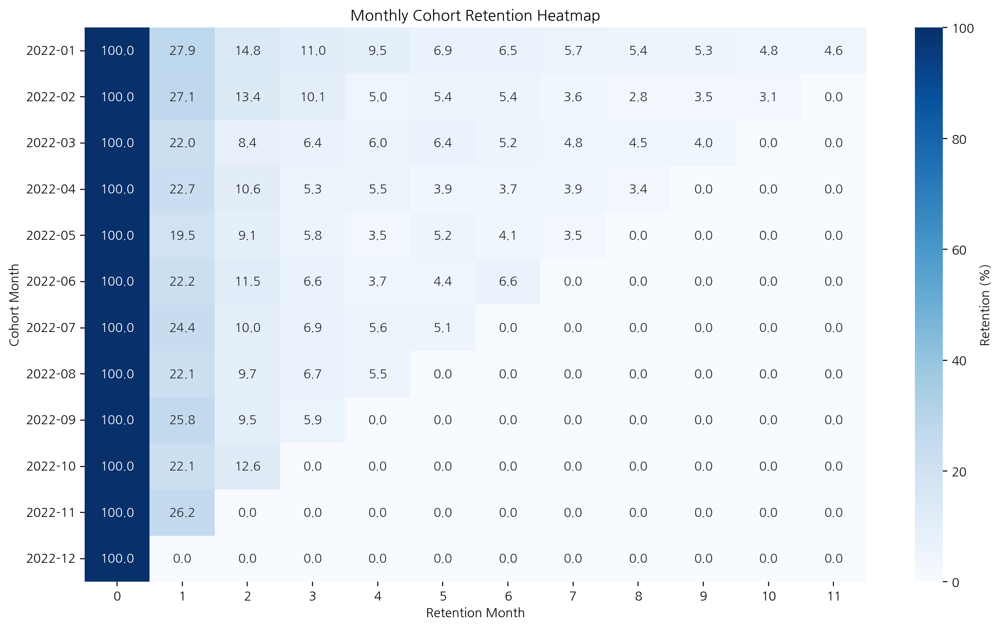

In [148]:
# 퍼센트 단위로 변경 (0개월차 기준으로 나누기)
cohort_sizes = retention_month_matrix[0]
retention = retention_month_matrix.divide(cohort_sizes, axis=0) * 100

# 히트맵 시각화
plt.figure(figsize=(14, 8))
sns.heatmap(retention, annot=True, fmt=".1f", cmap="Blues", cbar_kws={'label': 'Retention (%)'})
plt.title("Monthly Cohort Retention Heatmap")
plt.xlabel("Retention Month")
plt.ylabel("Cohort Month")
plt.yticks(rotation=0)
plt.show()


### 격주별 지원서 작성 리텐션(2023년)

In [149]:
application_2023_df = application_df[application_df['Year'] == 2023]
application_2023_df.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid
209,2023-01-27 05:17:52.082943,2023,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,76672866-64ce-4f48-bdf2-54ddca4cb6ff,2ece8d7d-79b6-4522-928b-8dbae8843fab,916d2bfb-faff-4ad2-ac25-b6fff87b5989


In [150]:
application_2023_df['date'] = application_2023_df['cdate'].dt.to_period('D')

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3704680180.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  application_2023_df['date'] = application_2023_df['cdate'].dt.to_period('D')


In [151]:
# 유저 별 최초 지원일
user_first_apply = application_2023_df.groupby('user_uuid')['date'].min().reset_index()
user_first_apply.columns = ['user_uuid', 'cohort_date']

In [152]:
application_2023_df = application_2023_df.merge(user_first_apply, on='user_uuid')

In [153]:
application_2023_df[['user_uuid', 'date', 'cohort_date']].head()

,user_uuid,date,cohort_date
0,2ece8d7d-79b6-4522-928b-8dbae8843fab,2023-01-27,2023-01-02
1,2ece8d7d-79b6-4522-928b-8dbae8843fab,2023-02-14,2023-01-02
2,2ece8d7d-79b6-4522-928b-8dbae8843fab,2023-01-26,2023-01-02
3,2ece8d7d-79b6-4522-928b-8dbae8843fab,2023-02-26,2023-01-02
4,2ece8d7d-79b6-4522-928b-8dbae8843fab,2023-02-06,2023-01-02


In [154]:
application_2023_df['date'] = application_2023_df['date'].dt.to_timestamp()
application_2023_df['cohort_date'] = application_2023_df['cohort_date'].dt.to_timestamp()

In [155]:
# 경과일 계산
application_2023_df['days_since_first'] = (application_2023_df['date'] - application_2023_df['cohort_date']).dt.days

# 14일 단위 리텐션 그룹 (0~13일: week 1, 14~27일: week 2, ...)
application_2023_df['retention_period'] = (application_2023_df['days_since_first'] // 14).astype(int)

In [156]:
retention_week_counts = (application_2023_df.groupby(['cohort_date', 'retention_period'])['user_uuid'].nunique().reset_index())

In [157]:
# 피벗 테이블로 정리 (row: cohort_date, column: retention_period)
retention_week_matrix = retention_week_counts.pivot(
    index='cohort_date',
    columns='retention_period',
    values='user_uuid'
).fillna(0).astype(int)

retention_week_matrix

retention_period,0,1,2,3,4,5,6,7,8,9,...,16,17,18,19,20,21,22,23,24,25
cohort_date,,,,,,,,,,,,,,,,,,,,,
2023-01-01,30,9,11,11,11,8,7,4,5,5,...,3,3,3,2,2,2,3,1,3,3
2023-01-02,53,18,18,18,12,12,10,11,9,8,...,8,5,4,5,4,5,6,6,7,6
2023-01-03,52,13,19,16,9,10,10,3,4,6,...,2,1,4,2,2,2,3,2,2,2
2023-01-04,48,12,18,14,9,9,7,3,4,4,...,1,1,1,0,0,2,0,0,1,2
2023-01-05,54,16,17,17,14,11,12,5,2,6,...,3,4,2,0,3,0,1,2,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-12-27,10,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2023-12-28,10,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2023-12-29,7,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


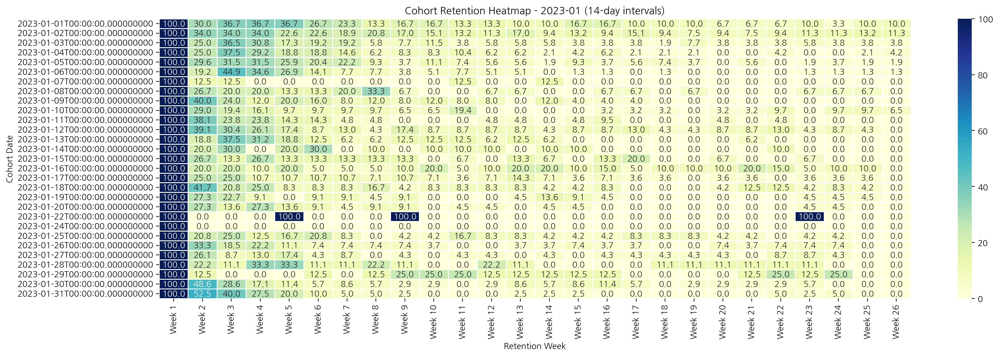

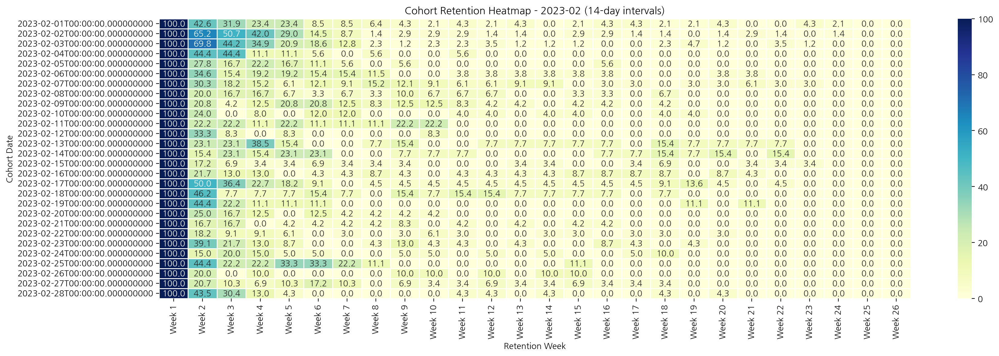

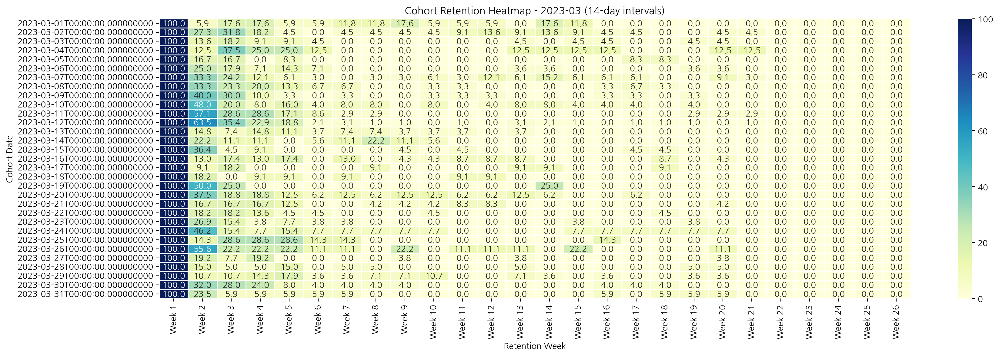

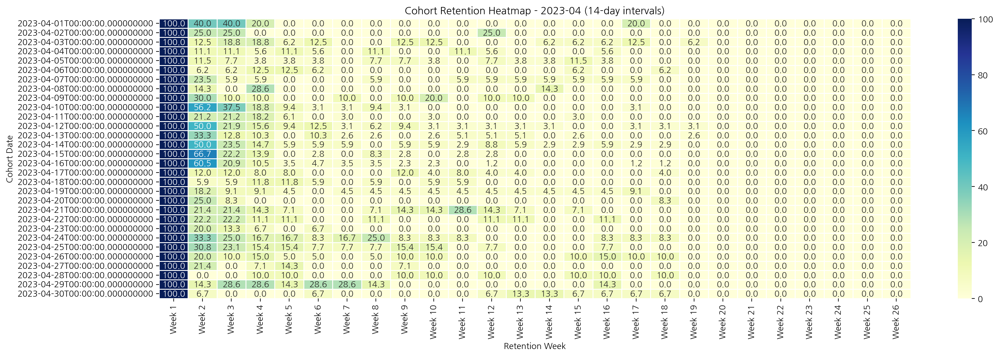

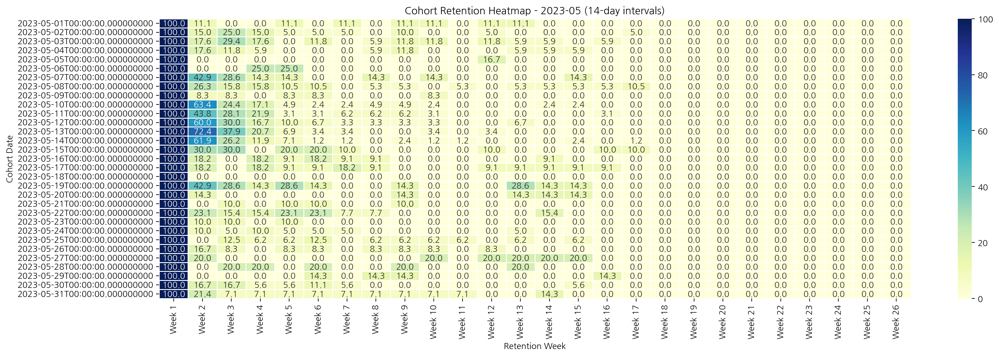

...

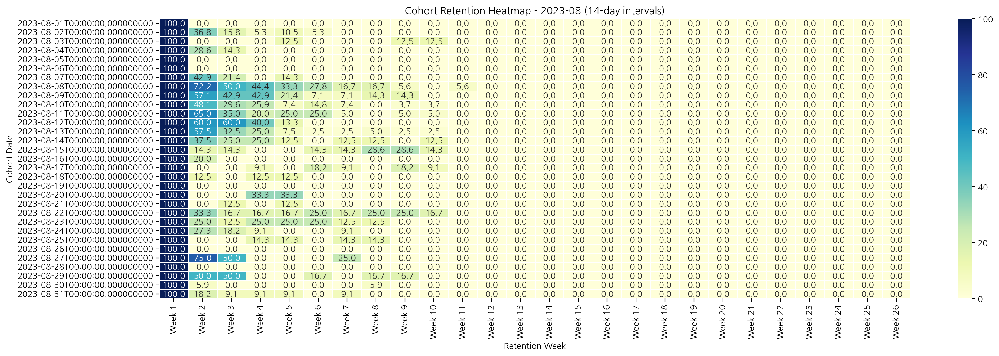

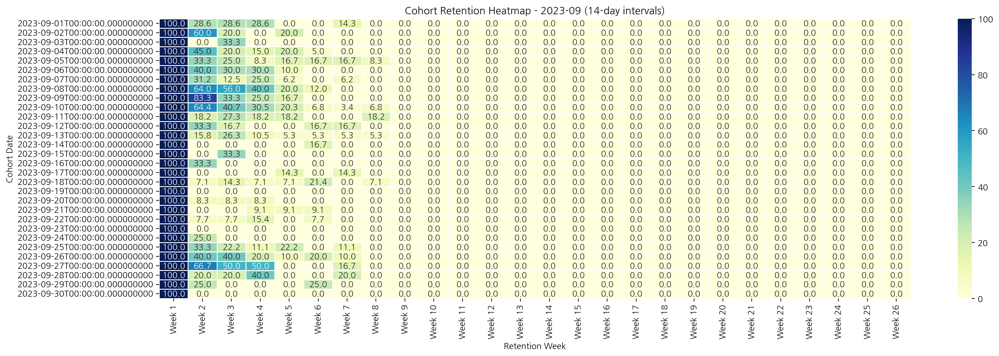

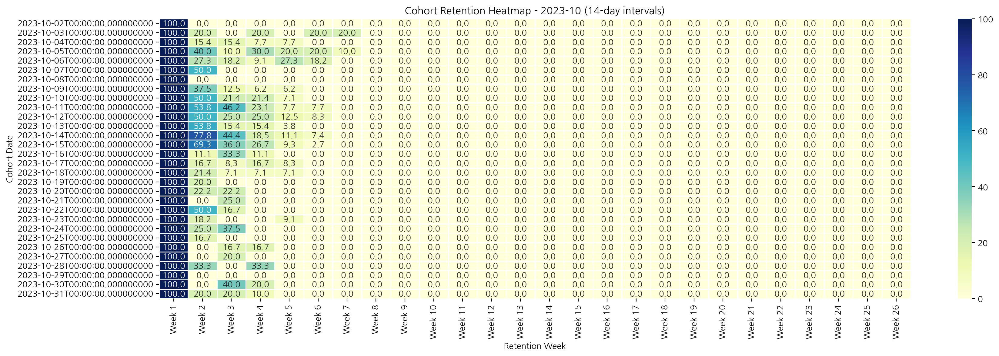

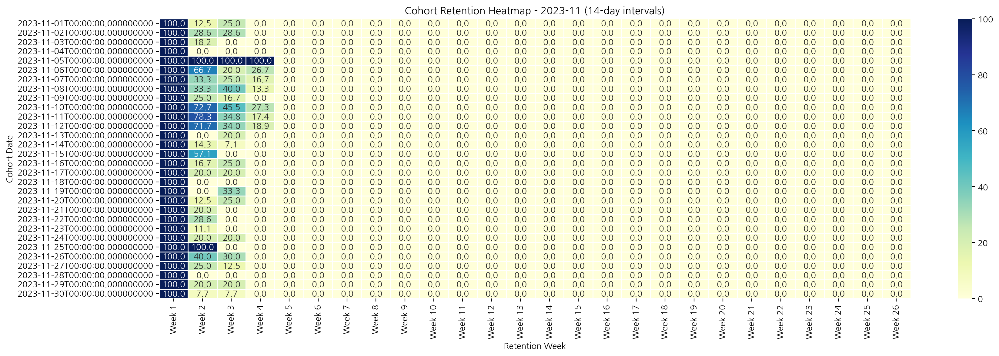

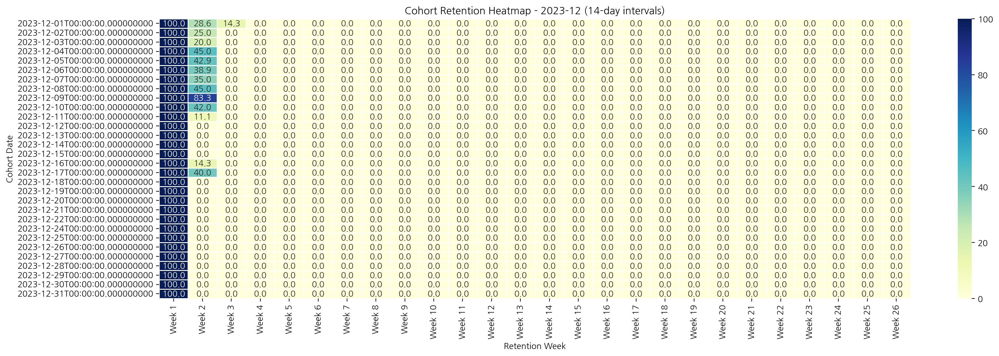

In [158]:
# 1. 코호트 크기 계산 및 리텐션 비율 변환
cohort_size = retention_week_matrix.iloc[:, 0]
retention_matrix_pct = (retention_week_matrix.div(cohort_size, axis=0)) * 100
retention_matrix_pct.iloc[:, 0] = 100.0  # 첫 주 100% 설정

# 2. 열 이름 직관적으로 변경
retention_matrix_pct.columns = [f"Week {i+1}" for i in retention_matrix_pct.columns]

# 3. 월별 그룹화 및 시각화
monthly_groups = retention_matrix_pct.groupby(lambda x: x.strftime('%Y-%m'))

for month, cohort_data in monthly_groups:
    plt.figure(figsize=(20, 6))
    sns.heatmap(
        cohort_data,
        cmap="YlGnBu",
        annot=True,
        fmt=".1f",
        vmin=0,
        vmax=100,
        linewidths=0.5
    )
    plt.title(f"Cohort Retention Heatmap - {month} (14-day intervals)")
    plt.xlabel("Retention Week")
    plt.ylabel("Cohort Date")
    plt.show()

### 월별 지원서 작성 리텐션(2023년)

In [159]:
application_2023_df['cohort_month'] = application_2023_df['cohort_date'].dt.to_period('M')
application_2023_df['activity_month'] = application_2023_df['date'].dt.to_period('M')

In [160]:
application_2023_df['retention_month'] = ((application_2023_df['activity_month'] - application_2023_df['cohort_month']).apply(lambda x: x.n))

In [161]:
retention_month_counts = application_2023_df.groupby(['cohort_month', 'retention_month'])['user_uuid'].nunique().reset_index()

In [162]:
retention_month_matrix = retention_month_counts.pivot(
    index='cohort_month',
    columns='retention_month',
    values='user_uuid'
).fillna(0).astype(int)

retention_month_matrix

retention_month,0,1,2,3,4,5,6,7,8,9,10,11
cohort_month,,,,,,,,,,,,
2023-01,764,315,200,133,93,76,70,64,39,39,54,50
2023-02,714,286,137,75,49,38,32,30,33,25,15,0
2023-03,707,246,111,49,32,34,35,21,25,19,0,0
2023-04,616,225,72,42,40,30,25,23,18,0,0,0
2023-05,513,184,67,38,26,18,20,17,0,0,0,0
2023-06,375,128,55,20,23,16,10,0,0,0,0,0
2023-07,367,105,44,27,19,14,0,0,0,0,0,0
2023-08,339,121,55,27,22,0,0,0,0,0,0,0
2023-09,327,118,60,23,0,0,0,0,0,0,0,0


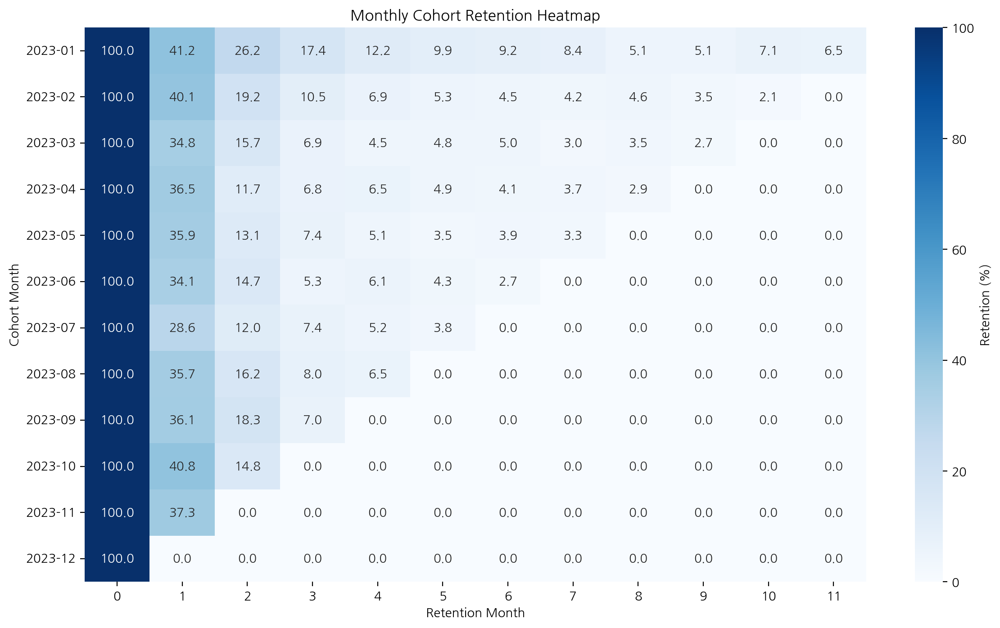

In [163]:
# 퍼센트 단위로 변경 (0개월차 기준으로 나누기)
cohort_sizes = retention_month_matrix[0]
retention = retention_month_matrix.divide(cohort_sizes, axis=0) * 100

# 히트맵 시각화
plt.figure(figsize=(14, 8))
sns.heatmap(retention, annot=True, fmt=".1f", cmap="Blues", cbar_kws={'label': 'Retention (%)'})
plt.title("Monthly Cohort Retention Heatmap")
plt.xlabel("Retention Month")
plt.ylabel("Cohort Month")
plt.yticks(rotation=0)
plt.show()

## Revenue

In [164]:
passed_filtered_df = log_2023_df[log_2023_df['URL'].str.contains('status=passed', na=False)]

In [165]:
# user_uuid가 2개 이상 중복되는 데이터만 필터링
duplicated_users = passed_filtered_df.groupby('user_uuid').filter(lambda x: len(x) > 1)

duplicated_users

,Unnamed: 0,user_uuid,URL,timestamp,date,response_code,method
49298,49298,aeb6a328-ad88-4f4e-acf7-2d7cb5259a95,@user_id/applications?status=passed,2023-03-20 11:03:51.952349 UTC,2023-03-20,200,GET
49309,49309,aeb6a328-ad88-4f4e-acf7-2d7cb5259a95,@user_id/applications?status=passed,2023-03-20 11:03:32.976886 UTC,2023-03-20,200,GET
129641,129641,f3b943f6-952f-4955-84e3-1f68268fdae7,@user_id/applications?status=passed,2023-03-28 07:43:40.93081 UTC,2023-03-28,200,GET
131325,131325,f3b943f6-952f-4955-84e3-1f68268fdae7,@user_id/applications?status=passed,2023-03-28 23:58:06.1635 UTC,2023-03-29,200,GET
199324,199324,3172b511-1170-49b7-b2c1-e1a099703dd9,@user_id/applications?status=passed,2023-11-09 15:20:46.510494 UTC,2023-11-10,200,GET
...,...,...,...,...,...,...,...
6986721,6986721,af710aae-4340-4981-a55c-6757d6ab67c6,@user_id/applications?status=passed,2023-03-28 04:15:54.733031 UTC,2023-03-28,200,GET
7168535,7168535,c36a6ce1-e32c-4bc0-beee-a189fd186523,@user_id/applications?status=passed,2023-04-11 16:35:40.535956 UTC,2023-04-12,200,GET
7168549,7168549,c36a6ce1-e32c-4bc0-beee-a189fd186523,@user_id/applications?status=passed,2023-04-11 16:35:32.450794 UTC,2023-04-12,200,GET
7168555,7168555,c36a6ce1-e32c-4bc0-beee-a189fd186523,@user_id/applications?status=passed,2023-04-11 15:39:14.328127 UTC,2023-04-12,200,GET


In [166]:
duplicated_users['timestamp'] = pd.to_datetime(duplicated_users['timestamp'])
duplicated_users['month'] = duplicated_users['timestamp'].dt.to_period('M')
monthly_counts = duplicated_users.groupby('month').size().reset_index()

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/514915138.py:2: UserWarning: Converting to PeriodArray/Index representation will drop timezone information.
  duplicated_users['month'] = duplicated_users['timestamp'].dt.to_period('M')


In [167]:
monthly_counts.rename(columns={0: 'passed_users'}, inplace=True)
monthly_counts


,month,passed_users
0,2023-01,63
1,2023-02,47
2,2023-03,84
3,2023-04,77
4,2023-05,61
5,2023-06,76
6,2023-07,70
7,2023-08,26
8,2023-09,35
9,2023-10,27


In [168]:
# 2023년 월별 예상 수익
monthly_counts['expected_revenue'] = monthly_counts['passed_users'] * 33000000 * 0.033
monthly_counts

,month,passed_users,expected_revenue
0,2023-01,63,68607000.0
1,2023-02,47,51183000.0
2,2023-03,84,91476000.0
3,2023-04,77,83853000.0
4,2023-05,61,66429000.0
5,2023-06,76,82764000.0
6,2023-07,70,76230000.0
7,2023-08,26,28314000.0
8,2023-09,35,38115000.0
9,2023-10,27,29403000.0


In [169]:
revenue_2023 = monthly_counts.drop(columns='passed_users')
revenue_2023

,month,expected_revenue
0,2023-01,68607000.0
1,2023-02,51183000.0
2,2023-03,91476000.0
3,2023-04,83853000.0
4,2023-05,66429000.0
5,2023-06,82764000.0
6,2023-07,76230000.0
7,2023-08,28314000.0
8,2023-09,38115000.0
9,2023-10,29403000.0


## Referral

### Referral Signup Conversion Rate

- 추천 유입 로그만 필터링

In [170]:
referral_logs_2023 = log_2023_df[log_2023_df['URL'].str.contains('utm_campaign=recommend_people', na=False)].dropna(subset=['user_uuid', 'timestamp'])

# 추천 유입 시점 중 첫 방문 기준
referral_first_2023 = referral_logs_2023.groupby('user_uuid')['timestamp'].min().reset_index()
referral_first_2023.columns = ['user_uuid', 'referral_time']

In [171]:
referral_first_2023

,user_uuid,referral_time
0,0017a738-4fcc-441e-983b-a6033890a9db,2023-01-15 00:56:04.212471 UTC
1,008314c3-4837-40fc-be5a-b38d1072db30,2023-03-08 01:16:05.46943 UTC
2,00bcd13a-391c-4745-8b7e-e24517e91c1d,2023-05-23 19:58:16.408841 UTC
3,00edb39b-805e-44a8-9fea-4171f5cd13f3,2023-02-28 01:09:07.794858 UTC
4,01363189-00a0-4f19-8753-eed03e19b3da,2023-04-25 08:14:58.206197 UTC
...,...,...
1094,fe6a3fb9-a017-4f18-8f39-4a0b2beba77c,2023-02-22 13:39:05.570736 UTC
1095,fee4f944-2182-4a50-ba5d-1197070d357f,2023-07-06 23:39:26.435311 UTC
1096,ff0f81ec-d2c5-4fff-aee1-5bc60c43658d,2023-04-08 11:23:30.427403 UTC
1097,ffc31c75-38c5-4574-906f-4efee3e9b319,2023-02-20 08:23:47.105578 UTC


- 회원가입 로그 추출

In [172]:
signup_logs_2023 = log_2023_df[log_2023_df['URL'] == 'signup'].dropna(subset=['user_uuid', 'timestamp'])

- 추천 유입 시점 이후에 가입한 유저만 필터링

In [173]:
referral_signup_2023 = pd.merge(referral_first_2023, signup_logs_2023, on='user_uuid', how='left')

# 추천 시점 이후에 가입한 유저
referral_signup_after_2023 = referral_signup_2023[
    referral_signup_2023['timestamp'] > referral_signup_2023['referral_time']
]

In [174]:
referral_signup_after_2023

,user_uuid,referral_time,Unnamed: 0,URL,timestamp,date,response_code,method
26,06df0843-5631-427d-9909-95b5f5bc1170,2023-03-03 12:51:57.362701 UTC,9575.0,signup,2023-09-12 02:54:47.589701 UTC,2023-09-12,302.0,GET
27,06df0843-5631-427d-9909-95b5f5bc1170,2023-03-03 12:51:57.362701 UTC,9768.0,signup,2023-08-03 01:20:05.662017 UTC,2023-08-03,302.0,GET
33,084eec92-b028-4501-8c1e-5faa63c84a61,2023-01-06 05:29:50.540468 UTC,1639682.0,signup,2023-11-29 10:15:52.385406 UTC,2023-11-29,302.0,GET
34,084eec92-b028-4501-8c1e-5faa63c84a61,2023-01-06 05:29:50.540468 UTC,1640153.0,signup,2023-05-29 03:40:11.786208 UTC,2023-05-29,302.0,GET
35,084eec92-b028-4501-8c1e-5faa63c84a61,2023-01-06 05:29:50.540468 UTC,1641445.0,signup,2023-10-22 07:15:11.510259 UTC,2023-10-22,302.0,GET
...,...,...,...,...,...,...,...,...
1132,f93ae4c1-d35d-4c57-a8c8-ec7b3e308177,2023-03-11 21:06:04.319506 UTC,4211444.0,signup,2023-04-19 01:36:13.672911 UTC,2023-04-19,302.0,GET
1139,fae9a883-d287-44d3-899b-4d5ac4fe5991,2023-03-16 23:56:13.842696 UTC,4006673.0,signup,2023-12-22 03:10:53.38274 UTC,2023-12-22,302.0,GET
1148,fcbc4137-f356-4d71-8d64-f14107f99b8a,2023-01-06 12:15:58.741003 UTC,1948366.0,signup,2023-02-24 08:41:35.203719 UTC,2023-02-24,302.0,GET
1149,fd05fa88-5124-4e2f-885d-3f215bef0c77,2023-04-13 04:07:32.265983 UTC,1223941.0,signup,2023-11-29 01:18:25.856362 UTC,2023-11-29,302.0,GET


In [175]:
## 최종 전환율 계산
converted_2023 = referral_signup_after_2023['user_uuid'].nunique()
total_referred_2023 = referral_first_2023['user_uuid'].nunique()

conversion_rate_2023 = converted_2023 / total_referred_2023 * 100
print(f"Referral Signup Conversion Rate: {conversion_rate_2023:.2f}%")

Referral Signup Conversion Rate: 6.55%


- 2022년 log 데이터도 위와 같이 진행

In [176]:
referral_logs_2022 = log_2022_df[log_2022_df['URL'].str.contains('utm_campaign=recommend_people', na=False)].dropna(subset=['user_uuid', 'timestamp'])

# 추천 유입 시점 중 첫 방문 기준
referral_first_2022 = referral_logs_2022.groupby('user_uuid')['timestamp'].min().reset_index()
referral_first_2022.columns = ['user_uuid', 'referral_time']

In [177]:
referral_first_2022

,user_uuid,referral_time
0,000e8610-16d3-4e9e-bf50-202d191ffac4,2022-03-23 00:58:14.445993 UTC
1,0017a738-4fcc-441e-983b-a6033890a9db,2022-05-28 23:32:34.848539 UTC
2,00495153-f908-4523-9d0d-5b93a57196a4,2022-10-21 04:47:12.96653 UTC
3,00698c5f-963a-45b7-8edb-3d32c9b704b8,2022-01-12 00:21:49.104254 UTC
4,006b94a2-9f2c-41e8-aeac-ac5a32c5b7f2,2022-06-29 14:35:53.901823 UTC
...,...,...
2330,ffa9a6fd-73be-4c4d-ae0b-322635a2859d,2022-05-29 13:06:21.682276 UTC
2331,ffba7f3a-64f6-424d-9e31-3d82242162b1,2022-11-26 07:13:44.352722 UTC
2332,ffc31c75-38c5-4574-906f-4efee3e9b319,2022-04-04 13:01:47.769995 UTC
2333,ffc9d2c0-5f6e-40b7-9569-85d46bd30ab0,2022-02-07 03:47:25.120674 UTC


In [178]:
signup_logs_2022 = log_2022_df[log_2022_df['URL'] == 'signup'].dropna(subset=['user_uuid', 'timestamp'])

In [179]:
referral_signup_2022 = pd.merge(referral_first_2022, signup_logs_2022, on='user_uuid', how='left')

# 추천 시점 이후에 가입한 유저
referral_signup_after_2022 = referral_signup_2022[
    referral_signup_2022['timestamp'] > referral_signup_2022['referral_time']
]

In [180]:
## 최종 전환율 계산
converted_2022 = referral_signup_after_2022['user_uuid'].nunique()
total_referred_2022 = referral_first_2022['user_uuid'].nunique()

conversion_rate_2022 = converted_2022 / total_referred_2022 * 100

print(f"Referral Signup Conversion Rate: {conversion_rate_2022:.2f}%")

Referral Signup Conversion Rate: 5.95%


# 지원서 작성률이랑 관련된 요인 분석분석 🧐

## 기업 규모에 따른 지원서 작성율

In [181]:
# 예시 값: '1-10명', '11-50명', '51-100명' 등
def parse_emp_count(x):
    if '1-10' in x:
        return '1-10'
    elif '11-50' in x:
        return '11-50'
    elif '51-100' in x:
        return '51-100'
    elif '101-200' in x:
        return '101-200'
    elif '201-500' in x:
        return '201-500'
    elif '501-1000' in x:
        return '501-1000'
    else:
        return '1000+'

company_df['emp_group'] = company_df['employee_count'].apply(parse_emp_count)


In [182]:
analyze_app_2022 = application_df.copy()

In [183]:
analyze_app_2022 = analyze_app_2022[analyze_app_2022['Year'] == 2022]

In [184]:
analyze_app_2022

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid
163,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a
176,2022-01-10 06:27:37.459987,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,332926ba-57aa-4b8f-ad55-316f56911c5a
177,2022-01-10 07:19:30.924181,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,dd4a186d-1e73-4123-8097-5c33b128ffb2
178,2022-01-10 10:59:26.452561,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,4d5bedd2-5b63-4d05-a7b3-d74e45f61cd0
179,2022-08-21 08:48:00.305915,2022,8,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,067bb1a8-ee8f-4bd2-97fa-0e39321ab797
...,...,...,...,...,...,...,...
340704,2022-07-09 15:26:41.074115,2022,7,0ea7ae45-4d19-4cdc-b2ce-1ee6b9189fbb,4413312a-84b4-490f-aa9b-b5f919146469,6b23abd1-589b-4bf2-bbc3-4c7c475687a2,149e930b-2da2-4c8f-8931-bb90a9556763
340715,2022-06-28 12:35:20.601121,2022,6,1f78ba83-0862-400a-9450-7438de6dd53c,0baa07ef-5808-4ced-8719-aa928b91cafd,bdfebb58-6ebe-4124-8679-de9d5c266dbb,64c29614-9b79-4462-9fd6-e4d93a0cd8dc
340726,2022-03-20 22:21:29.175182,2022,3,214c0ee9-4fc9-46be-ba8a-2a0368510e80,a82d7bd3-87ee-4eaf-9519-1b60a331a474,dc1fb548-59dd-47bc-82aa-99d92e70f793,0ab0adef-da09-4381-baf7-a3fb017c19ea
340727,2022-04-07 09:41:05.036134,2022,4,565e7499-1070-49c5-a3b9-a27e5ca27a9e,744ab632-8193-406a-bd51-3e2c9ddd4544,1e311075-359d-40fd-b606-f74cb1819499,bbd1050f-3729-45d9-8404-c8ad75dc5131


In [185]:
analyze_app_2022['apply_month'] = pd.to_datetime(analyze_app_2022['cdate']).dt.to_period('M')

In [186]:
job_df.head(1)

,cdate,mdate,job_field,career_type_string,start_date,end_date,allow_remote,can_show_salary,job_uuid,company_uuid
0,2020-11-25 10:32:10,2020-11-25 10:32:10,SW 개발,"신입,경력,인턴",NaT,2020-11-25,1,0,764292b0-53f8-4f14-ac83-6eafc7a6a18d,daa34559-fc42-47f6-b5c6-cc6171404f37


In [187]:
company_df.head(1)

,cdate,mdate,found_date,employee_count,view_count,follow_count,reference_count,company_uuid,emp_group
0,2022-06-09 04:08:40,2022-06-09 04:08:40,NaT,0명,0,0,0,c46f2fa5-f940-40fb-bd4a-aa0ff7a837fd,1000+


In [188]:
analyze_app_2022.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,apply_month
163,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01


In [189]:
first_app = analyze_app_2022.groupby('user_uuid')['apply_month'].min().reset_index().rename(columns={'apply_month': 'cohort_month'})

In [190]:
analyze_app_2022 = analyze_app_2022.merge(first_app, on='user_uuid')

In [191]:
analyze_app_2022['retention_month'] = (analyze_app_2022['apply_month'] - analyze_app_2022['cohort_month']).apply(lambda x: x.n)

In [192]:
# 유저의 각 지원이 어떤 기업의 어느 규모 였는지 연결
analyze_app_2022 = analyze_app_2022.merge(job_df[['job_uuid', 'company_uuid']], on='job_uuid', how='left')

In [193]:
analyze_app_2022.head(1)

,cdate,Year,Month,company_uuid_x,job_uuid,user_uuid,application_uuid,apply_month,cohort_month,retention_month,company_uuid_y
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,de4b3596-b4ab-47cd-b8ea-6f9e14170064


In [194]:
analyze_app_2022.rename(columns={'company_uuid_x': 'company_uuid'}, inplace=True)

In [195]:
analyze_app_2022 = analyze_app_2022.merge(company_df[['company_uuid', 'emp_group']], on='company_uuid', how='left')

In [196]:
analyze_app_2022.head()

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,apply_month,cohort_month,retention_month,company_uuid_y,emp_group
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,de4b3596-b4ab-47cd-b8ea-6f9e14170064,11-50
1,2022-01-10 06:27:37.459987,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,332926ba-57aa-4b8f-ad55-316f56911c5a,2022-01,2022-01,0,de4b3596-b4ab-47cd-b8ea-6f9e14170064,11-50
2,2022-01-10 07:19:30.924181,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,dd4a186d-1e73-4123-8097-5c33b128ffb2,2022-01,2022-01,0,de4b3596-b4ab-47cd-b8ea-6f9e14170064,11-50
3,2022-01-10 10:59:26.452561,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,4d5bedd2-5b63-4d05-a7b3-d74e45f61cd0,2022-01,2022-01,0,de4b3596-b4ab-47cd-b8ea-6f9e14170064,11-50
4,2022-08-21 08:48:00.305915,2022,8,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,067bb1a8-ee8f-4bd2-97fa-0e39321ab797,2022-08,2022-01,7,de4b3596-b4ab-47cd-b8ea-6f9e14170064,11-50


### 기업 규모별 지원 비율

In [197]:
order = ['1-10', '11-50', '201-500', '1000+']
apply_by_emp = analyze_app_2022['emp_group'].value_counts(normalize=True).loc[order].reset_index()
apply_by_emp['proportion'] = apply_by_emp['proportion'] * 100
apply_by_emp

,emp_group,proportion
0,1-10,19.580983
1,11-50,36.551657
2,201-500,1.345445
3,1000+,42.521915


/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3944316704.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=apply_by_emp, x='emp_group', y='proportion', palette='Blues_d')


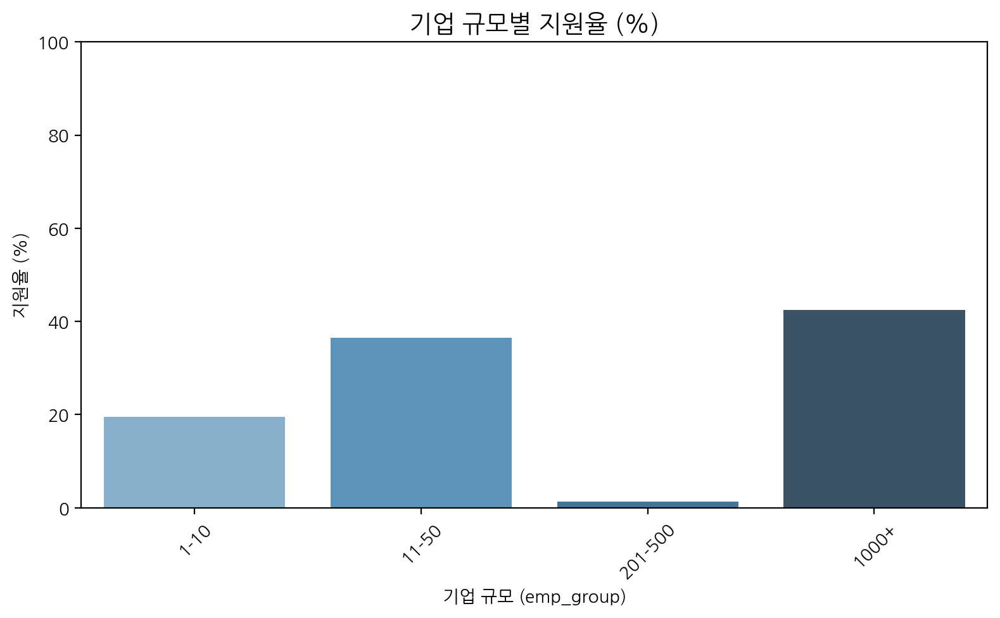

In [198]:
plt.figure(figsize=(8, 5))
sns.barplot(data=apply_by_emp, x='emp_group', y='proportion', palette='Blues_d')

plt.title('기업 규모별 지원율 (%)', fontsize=14)
plt.xlabel('기업 규모 (emp_group)')
plt.ylabel('지원율 (%)')
plt.ylim(0, 100)
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

### 기업 규모별 리텐션 비교

In [199]:
# retention_month 1 이상이면 "재지원", 0이면 "초기 지원"
analyze_app_2022['is_retained'] = analyze_app_2022['retention_month'] > 0

# 기업 규모별 리텐션율
retention_by_emp = analyze_app_2022.groupby('emp_group')['is_retained'].mean().sort_values(ascending=False).loc[order].reset_index()
retention_by_emp.columns = ['emp_group', 'retention_rate']
retention_by_emp['retention_rate'] = retention_by_emp['retention_rate'] * 100
retention_by_emp

,emp_group,retention_rate
0,1-10,53.136301
1,11-50,50.324003
2,201-500,48.275862
3,1000+,50.924543


/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/2845857494.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(data=retention_by_emp, x='emp_group', y='retention_rate', palette='Blues_d')


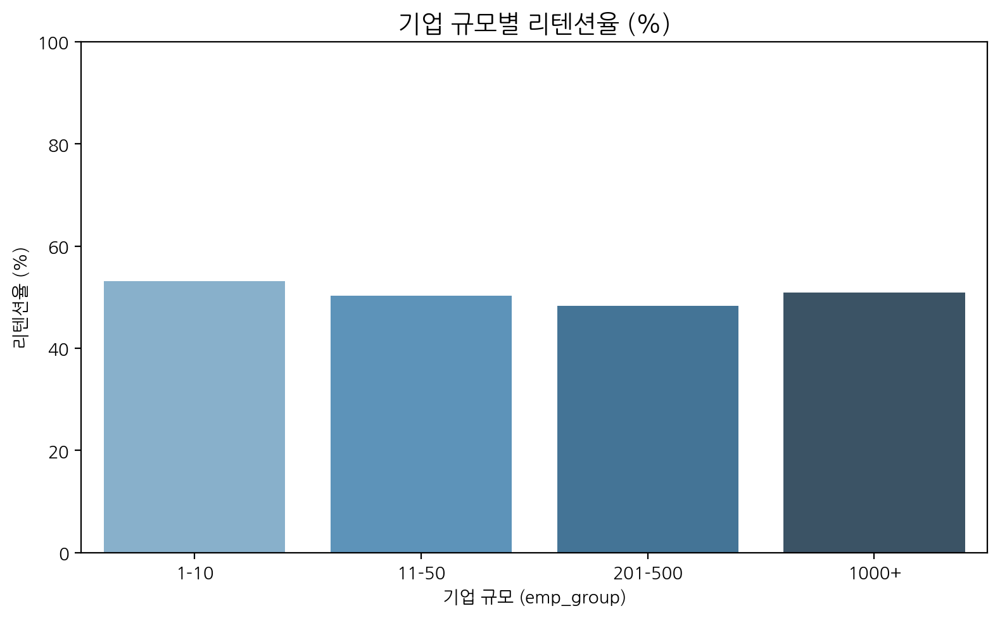

In [200]:
# 시각화
plt.figure(figsize=(8, 5))
sns.barplot(data=retention_by_emp, x='emp_group', y='retention_rate', palette='Blues_d')

plt.title('기업 규모별 리텐션율 (%)', fontsize=14)
plt.xlabel('기업 규모 (emp_group)')
plt.ylabel('리텐션율 (%)')
plt.ylim(0, 100)
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()

### 인사이트 💎

- 대기업(1000+)에 지원이 집중됨
    - 지원서 작성율: 1000+ 규모 기업의 전체의 42.5%를 차지해 가장 높은 지원 비중을 보임
    - 이는 구직다들이 상대적으로 높은 연봉, 안정성, 복지, 인지도 측면에서 대기업을 선호하는 경향이 있다는 걸 시사함
- 소기업(1-10)의 리텐션율이 가장 높음
    - 리텐션율: 1-10 규모 기업의 리텐션이 53.1%로 가장 높음.
    - 반면, 지원서 작성율은 19.6%로 낮음
    - 소기업은 관심은 적지만, 한 번 지원한 유저는 지속적으로 활동하는 경향을 의미
    - 이는 소기업이 구직자와 더 밀접한 소통을 하거나, 개인의 성장이 돋보일 수 있는 환경이어서일 가능성이 있음.
- 중견기업은 상대적으로 매력도가 낮음
    - 지원율: 1.35%로 가장 낮음
    - 리텐션율도 48.3%로 가장 낮은 수준
    - 이는 인지도는 낮고, 대기업 수준의 복지도 제공하지 못하는 중견기업의 브랜드 경쟁력 약화 가능성을 시사함

## 연봉공개에 따른 리텐션

In [201]:
job_df.head(1)

,cdate,mdate,job_field,career_type_string,start_date,end_date,allow_remote,can_show_salary,job_uuid,company_uuid
0,2020-11-25 10:32:10,2020-11-25 10:32:10,SW 개발,"신입,경력,인턴",NaT,2020-11-25,1,0,764292b0-53f8-4f14-ac83-6eafc7a6a18d,daa34559-fc42-47f6-b5c6-cc6171404f37


In [202]:
application_ret = application_df.copy()

application_ret = application_ret[application_ret['Year'] == 2022]
application_ret['application_month'] = application_ret['cdate'].dt.to_period('M')

first_app_month = application_ret.groupby('user_uuid')['application_month'].min().reset_index()
first_app_month.columns = ['user_uuid', 'first_month']

application_ret = application_ret.merge(first_app_month, on='user_uuid')
application_ret['month_diff'] = (application_ret['application_month'] - application_ret['first_month']).apply(lambda x: x.n)

In [203]:
application_ret.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,application_month,first_month,month_diff
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0


In [204]:
retention_df = application_ret.groupby(['first_month', 'month_diff'])['user_uuid'].nunique().reset_index()
cohort_size_df = retention_df[retention_df['month_diff'] == 0][['first_month', 'user_uuid']]
cohort_size_df.columns = ['first_month', 'cohort_size']

In [205]:
retention_df = retention_df.merge(cohort_size_df, on='first_month')
retention_df['retention_rate'] = retention_df['user_uuid'] / retention_df['cohort_size']

In [206]:
# 이제 이 데이터 프레임을 copy해서 각 요인을 분석
retention_df.head(20)

,first_month,month_diff,user_uuid,cohort_size,retention_rate
0,2022-01,0,866,866,1.000000
1,2022-01,1,242,866,0.279446
2,2022-01,2,128,866,0.147806
3,2022-01,3,95,866,0.109700
4,2022-01,4,82,866,0.094688
5,2022-01,5,60,866,0.069284
6,2022-01,6,56,866,0.064665
7,2022-01,7,49,866,0.056582
8,2022-01,8,47,866,0.054273
9,2022-01,9,46,866,0.053118


In [207]:
application_ret_copy = application_ret.copy()

In [208]:
application_ret_copy = application_ret_copy.merge(
    job_df[['job_uuid', 'can_show_salary']],
    on='job_uuid',
    how='left'
)

In [209]:
first_salary_df = application_ret_copy[application_ret_copy['month_diff'] == 0][['user_uuid', 'can_show_salary']]
first_salary_df = first_salary_df.rename(columns={'can_show_salary': 'can_show_salary_first'})

In [210]:
first_salary_df

,user_uuid,can_show_salary_first
0,2ece8d7d-79b6-4522-928b-8dbae8843fab,1.0
1,2ece8d7d-79b6-4522-928b-8dbae8843fab,1.0
2,2ece8d7d-79b6-4522-928b-8dbae8843fab,1.0
3,2ece8d7d-79b6-4522-928b-8dbae8843fab,1.0
6,2ece8d7d-79b6-4522-928b-8dbae8843fab,1.0
...,...,...
42599,6b23abd1-589b-4bf2-bbc3-4c7c475687a2,1.0
42600,bdfebb58-6ebe-4124-8679-de9d5c266dbb,0.0
42601,dc1fb548-59dd-47bc-82aa-99d92e70f793,0.0
42602,1e311075-359d-40fd-b606-f74cb1819499,1.0


In [211]:
application_ret_copy = application_ret_copy.merge(first_salary_df, on='user_uuid', how='left')

In [212]:
application_ret_copy

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,application_month,first_month,month_diff,can_show_salary,can_show_salary_first
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,1.0,1.0
1,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,1.0,1.0
2,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,1.0,1.0
3,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,1.0,1.0
4,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,1.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2145934,2022-07-09 15:26:41.074115,2022,7,0ea7ae45-4d19-4cdc-b2ce-1ee6b9189fbb,4413312a-84b4-490f-aa9b-b5f919146469,6b23abd1-589b-4bf2-bbc3-4c7c475687a2,149e930b-2da2-4c8f-8931-bb90a9556763,2022-07,2022-07,0,1.0,1.0
2145935,2022-06-28 12:35:20.601121,2022,6,1f78ba83-0862-400a-9450-7438de6dd53c,0baa07ef-5808-4ced-8719-aa928b91cafd,bdfebb58-6ebe-4124-8679-de9d5c266dbb,64c29614-9b79-4462-9fd6-e4d93a0cd8dc,2022-06,2022-06,0,0.0,0.0
2145936,2022-03-20 22:21:29.175182,2022,3,214c0ee9-4fc9-46be-ba8a-2a0368510e80,a82d7bd3-87ee-4eaf-9519-1b60a331a474,dc1fb548-59dd-47bc-82aa-99d92e70f793,0ab0adef-da09-4381-baf7-a3fb017c19ea,2022-03,2022-03,0,0.0,0.0
2145937,2022-04-07 09:41:05.036134,2022,4,565e7499-1070-49c5-a3b9-a27e5ca27a9e,744ab632-8193-406a-bd51-3e2c9ddd4544,1e311075-359d-40fd-b606-f74cb1819499,bbd1050f-3729-45d9-8404-c8ad75dc5131,2022-04,2022-04,0,1.0,1.0


In [213]:
# 월별 리텐션 계산 (연봉 공개 여부 기준)
retention_by_salary = (
    application_ret_copy.groupby(['month_diff', 'can_show_salary_first'])['user_uuid'].nunique().reset_index().rename(columns={'user_uuid': 'retained_users'})
)

In [214]:
retention_by_salary

,month_diff,can_show_salary_first,retained_users
0,0,0.0,4215
1,0,1.0,3578
2,1,0.0,1007
3,1,1.0,914
4,2,0.0,426
5,2,1.0,401
6,3,0.0,263
7,3,1.0,251
8,4,0.0,191
9,4,1.0,179


In [215]:
# 0개월차 유저 수로 나눠 비율 계산
cohort_sizes = retention_by_salary[retention_by_salary['month_diff'] == 0][['can_show_salary_first', 'retained_users']]
cohort_sizes = cohort_sizes.rename(columns={'retained_users': 'cohort_size'})

In [216]:
cohort_sizes

,can_show_salary_first,cohort_size
0,0.0,4215
1,1.0,3578


In [217]:
retention_by_salary = retention_by_salary.merge(cohort_sizes, on='can_show_salary_first')
retention_by_salary['retention_rate'] = retention_by_salary['retained_users'] / retention_by_salary['cohort_size']

In [218]:
retention_by_salary

,month_diff,can_show_salary_first,retained_users,cohort_size,retention_rate
0,0,0.0,4215,4215,1.000000
1,0,1.0,3578,3578,1.000000
2,1,0.0,1007,4215,0.238909
3,1,1.0,914,3578,0.255450
4,2,0.0,426,4215,0.101068
5,2,1.0,401,3578,0.112074
6,3,0.0,263,4215,0.062396
7,3,1.0,251,3578,0.070151
8,4,0.0,191,4215,0.045314
9,4,1.0,179,3578,0.050028


In [219]:
print(retention_by_salary['can_show_salary_first'].unique())
print(retention_by_salary['can_show_salary_first'].dtype)


[0. 1.]
float64


In [220]:
retention_by_salary['can_show_salary_first'] = retention_by_salary['can_show_salary_first'].astype(bool)

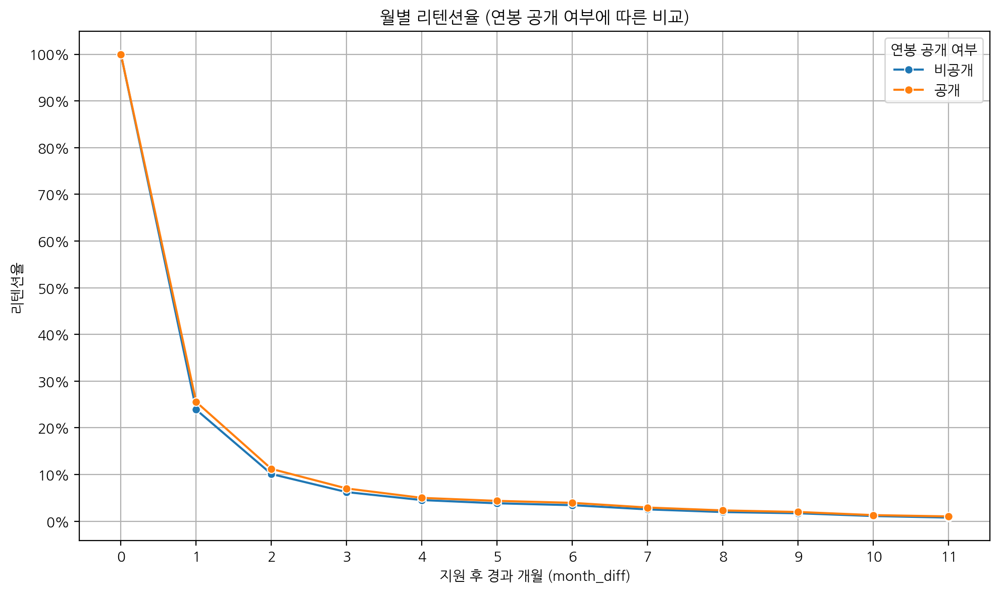

In [221]:
plt.figure(figsize=(10, 6))

# seaborn 으로 라인 그래프 그리기
sns.lineplot(
    data=retention_by_salary,
    x='month_diff',
    y='retention_rate',
    hue='can_show_salary_first',
    marker='o',
    estimator='mean'
)

plt.title('월별 리텐션율 (연봉 공개 여부에 따른 비교)')
plt.xlabel('지원 후 경과 개월 (month_diff)')
plt.ylabel('리텐션율')
plt.xticks(range(retention_by_salary['month_diff'].max() + 1))
plt.yticks([i/10 for i in range(11)], ['{:.0%}'.format(i/10) for i in range(11)])
plt.grid(True)
plt.tight_layout()

# 범례 라벨 수동 설정 (False → 비공개, True → 공개)
handles, labels = plt.gca().get_legend_handles_labels()
labels = ['비공개' if label == 'False' else '공개' for label in labels]
plt.legend(handles=handles, labels=labels, title='연봉 공개 여부')

plt.show()

### 인사이트 💎

- **연봉 공개**를 했을 때, **유저의 다음 지원서 작성율**이 연봉 공개를 하지 않은 유저보다 **약간 높은 추세**를 보임. 그러나 시간이 경과함에 따라 **연봉 공개 여부에 따른 리텐션**은 점차 **비슷한 수준**으로 수렴
- 이를 통해 **연봉 공개 여부**는 **초기 리텐션에 긍정적인 영향을 미치지만**, 시간이 지나면서 **장기적인 리텐션**에는 다른 요인들이 더 중요한 역할을 한다는 것을 알 수 있음

## 근무지에 따른 지원서 작성률 리텐션


In [222]:
company_address_df['address'].unique()

array(['서울 구로구', '서울특별시 구로구',
       '158 Hoàng Hoa Thám, Phường 12, Tân Bình, Hồ Chí Minh, 베트남',
       '서울특별시 서초구', '서울특별시 종로구', '서울특별시 강남구', '수원시', '서울특별시 마포구', '제주시',
       '서울특별시 광진구', '서울특별시 동대문구', '서울특별시 용산구',
       'Main Building, University Street, National University of Mongolia, Ulaanbaatar 14201, Mongolia',
       'Baga Toiruu-20, P.O.Box 349, Ulaanbaatar 210646 몽고', '서울특별시 관악구',
       '고양시 동구', '서울특별시 중구', '부산광역시 영도구', '서울특별시 금천구', '용인시', '성남시',
       '서울특별시 성동구', '대전광역시 유성구', '포항시 남구', '경상남도 하동군', '고양시 서구', 'Seoul',
       '서울특별시 영등포구', '서울특별시 강서구', '서울특별시 서대문구', '서울특별시 송파구', '안산시',
       '미국 뉴욕 뉴욕', '영국 런던',
       '11/17 Soi Ruam Ruedi, Khwaeng Lumphini, Khet Pathum Wan, Krung Thep Maha Nakhon 10330 태국',
       '싱가포르', '서울특별시', '서귀포시', '부산광역시 금정구', '시흥시', '화성시', '서울특별시 양천구',
       '오산시', '대구광역시 동구', '천안시 남구', '미국 일리노이 시카고',
       '1450 2nd St, Santa Monica, CA 90401 미국',
       '400 Fang Chun Lu, Pudong Xinqu, Shanghai Shi, 중국',
       '1-chōme-6-5 Jinnan, Shibuy

In [223]:
seoul_keywords = ['서울', '서울특별시', '서울시']
gyeonggi_keywords = ['경기도', '고양시', '성남시', '수원시', '용인시', '부천시', '안산시', '안양시',
                     '남양주시', '화성시', '평택시', '의정부시', '시흥시', '파주시', '김포시',
                     '광명시', '군포시', '하남시', '이천시', '오산시', '의왕시', '양주시', '구리시',
                     '포천시', '동두천시', '가평군', '연천군']
incheon_keywords = ['인천', '인천광역시']


In [224]:
foreign_keywords = ['미국', '뉴욕', '시카고', '캘리포니아', '샌프란시스코', '산호세', '로스앤젤레스',
                    '일본', '도쿄', '요코하마',
                    '홍콩', '싱가포르',
                    '베트남', '하노이', '호치민',
                    '중국', '상하이', '칭다오', '베이징', '텐진',
                    '영국', '런던',
                    '프랑스', '파리',
                    '인도', '뭄바이',
                    '필리핀', '마닐라',
                    '덴마크', '캐나다', '몽골']


In [225]:
def classify_region(address):
    if any(kw in address for kw in seoul_keywords + gyeonggi_keywords + incheon_keywords):
        return '수도권'
    elif any(kw in address for kw in foreign_keywords):
        return '해외'
    else:
        return '비수도권'


In [226]:
company_address_df['region'] = company_address_df['address'].apply(classify_region)

In [227]:
company_address_df.sample(10)

,name,company_uuid,address,region
13390,난쟁이팩트 오피스,5635ff8d-48d6-4699-bb45-5e4c16b6e6ce,서울특별시 동대문구,수도권
13254,제주지사_플레이콘,242b27e1-e9c0-4e03-b712-f4b8aba488b4,제주시,비수도권
12214,(주)직뱅크,448ba55f-1c0a-4b52-aed0-8b0ce6a193d0,서울특별시 마포구,수도권
8523,사무실,d6de19c3-858d-42b8-a069-b4c08154df64,대구 북구,비수도권
4851,본사,4d7d43c1-5fe3-4536-9446-6212f9fddf59,서울특별시 구로구,수도권
10454,사무실,0b4c4aba-fe26-45be-9a94-fe6ae4828fd2,서울특별시 강남구,수도권
1841,고객사,8f92fb00-e38b-4889-a77c-632270b06f85,경기도,수도권
10232,사무실,b667bc5e-501a-444d-9e39-dfa714edcf59,성남시,수도권
9885,사무실,70a185c9-b65b-4096-85a2-429791454380,서울특별시 강남구,수도권
2287,본사,91ec596a-373d-4c89-b6bd-e839d40f0304,서울특별시 강남구,수도권


In [228]:
company_region = company_address_df[['company_uuid', 'region']]

In [229]:
application_ret_copy = application_ret.copy()

In [230]:
application_ret_copy = application_ret_copy.merge(company_region, on='company_uuid', how='left')

In [231]:
application_ret_copy.sample(5)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,application_month,first_month,month_diff,region
57202,2022-06-20 16:05:02.968586,2022,6,d6605c58-d8d3-43d4-a538-fe1284c62512,cafee3fa-1505-43a6-9c6d-e6798a166003,fb945f6b-6b2b-4a9b-9eed-381cf0fc0e29,a16a61c9-ae13-404a-b2dd-ab418f37113f,2022-06,2022-05,1,수도권
11168,2022-04-13 01:00:10.301950,2022,4,dbec7b61-52cb-427e-bd3c-513c9eb7848e,d92a96bd-7c83-49df-8dd0-bf724404b3f6,52d7ca77-1d7c-464b-8040-a098af51a6c2,ad617a76-54b2-45af-b18a-34f2716122ef,2022-04,2022-01,3,수도권
9649,2022-09-25 08:43:34.442162,2022,9,de4b3596-b4ab-47cd-b8ea-6f9e14170064,9cecae71-02a9-441a-b53b-a1ab5a0488ca,984ff251-1115-47ee-afe0-334fffaea6ad,6e4452e5-dd08-4e40-9d84-6008efc71247,2022-09,2022-09,0,수도권
45778,2022-02-24 10:55:35.525338,2022,2,3e3a4b94-e0b7-47c9-9b5c-020160b3ad06,abc1cfee-0c40-4111-86d5-d31e9fa707a7,15aca9cd-219b-48bb-ab89-863c8e86b9fa,767907f8-5ffe-4fe5-bebc-a46f92723610,2022-02,2022-02,0,수도권
32608,2022-06-27 09:27:23.746895,2022,6,e694d52b-36b0-4ab0-99bd-00ccd1135442,e10bbc83-52af-4d78-b3b0-74cfcf081e94,7b4f5da9-3851-4662-b405-2241e751a28f,0c2bbb19-f77c-4590-b768-b7a2b213ddc0,2022-06,2022-06,0,수도권


In [232]:
retention = application_ret_copy.groupby(['region', 'first_month', 'month_diff'])['user_uuid'].nunique().reset_index()
retention

,region,first_month,month_diff,user_uuid
0,비수도권,2022-01,0,164
1,비수도권,2022-01,1,68
2,비수도권,2022-01,2,44
3,비수도권,2022-01,3,32
4,비수도권,2022-01,4,20
...,...,...,...,...
227,해외,2022-10,1,8
228,해외,2022-10,2,4
229,해외,2022-11,0,33
230,해외,2022-11,1,15


In [233]:
initial_users = retention[retention['month_diff'] == 0][['region', 'first_month', 'user_uuid']]
initial_users.rename(columns={'user_uuid': 'initial_users'}, inplace=True)

In [234]:
initial_users

,region,first_month,initial_users
0,비수도권,2022-01,164
12,비수도권,2022-02,113
23,비수도권,2022-03,119
33,비수도권,2022-04,127
42,비수도권,2022-05,108
50,비수도권,2022-06,94
57,비수도권,2022-07,102
63,비수도권,2022-08,84
68,비수도권,2022-09,68
72,비수도권,2022-10,79


In [235]:
retention = retention.merge(initial_users, on=['region', 'first_month'])
retention['retention_rate'] = retention['user_uuid'] / retention['initial_users']

In [236]:
retention

,region,first_month,month_diff,user_uuid,initial_users,retention_rate
0,비수도권,2022-01,0,164,164,1.000000
1,비수도권,2022-01,1,68,164,0.414634
2,비수도권,2022-01,2,44,164,0.268293
3,비수도권,2022-01,3,32,164,0.195122
4,비수도권,2022-01,4,20,164,0.121951
...,...,...,...,...,...,...
227,해외,2022-10,1,8,26,0.307692
228,해외,2022-10,2,4,26,0.153846
229,해외,2022-11,0,33,33,1.000000
230,해외,2022-11,1,15,33,0.454545


### 기업 근무지별 지원 비율

In [237]:
apply_by_region = application_ret_copy['region'].value_counts(normalize=True).reset_index()
apply_by_region['proportion'] = apply_by_region['proportion'] * 100
apply_by_region

,region,proportion
0,수도권,88.605523
1,비수도권,9.022606
2,해외,2.371871


/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/1081741212.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(


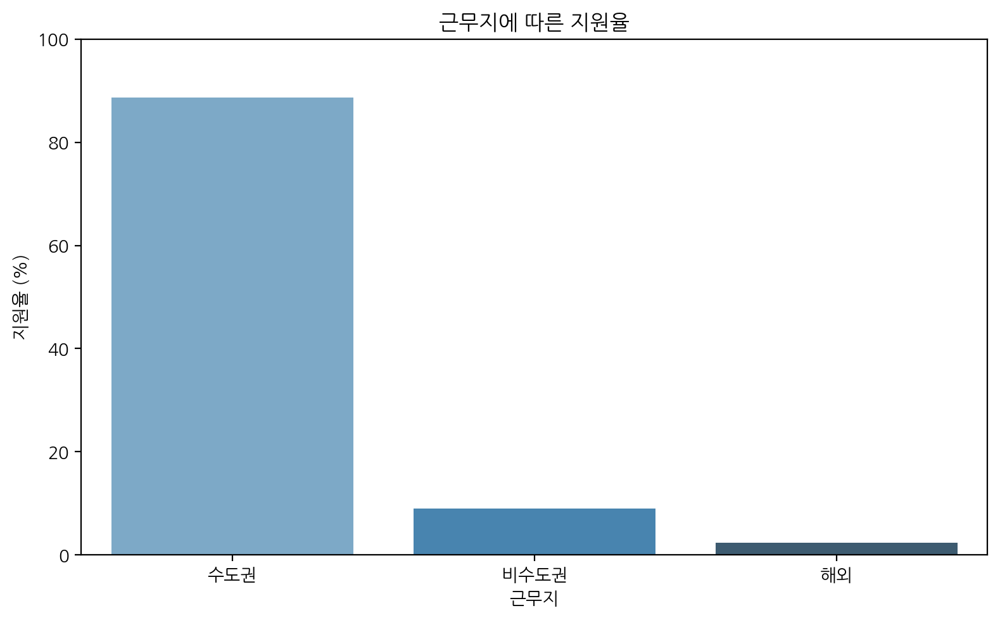

In [238]:
plt.figure(figsize=(8, 5))

sns.barplot(
    data=apply_by_region,
    x='region',
    y='proportion',
    palette='Blues_d'
)
plt.title('근무지에 따른 지원율')
plt.xlabel('근무지')
plt.ylabel('지원율 (%)')
plt.ylim(0, 100)
plt.tight_layout()
plt.show()

In [239]:
retention

,region,first_month,month_diff,user_uuid,initial_users,retention_rate
0,비수도권,2022-01,0,164,164,1.000000
1,비수도권,2022-01,1,68,164,0.414634
2,비수도권,2022-01,2,44,164,0.268293
3,비수도권,2022-01,3,32,164,0.195122
4,비수도권,2022-01,4,20,164,0.121951
...,...,...,...,...,...,...
227,해외,2022-10,1,8,26,0.307692
228,해외,2022-10,2,4,26,0.153846
229,해외,2022-11,0,33,33,1.000000
230,해외,2022-11,1,15,33,0.454545


### 기업 근무지별 리텐션 비교

/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/4126236502.py:6: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


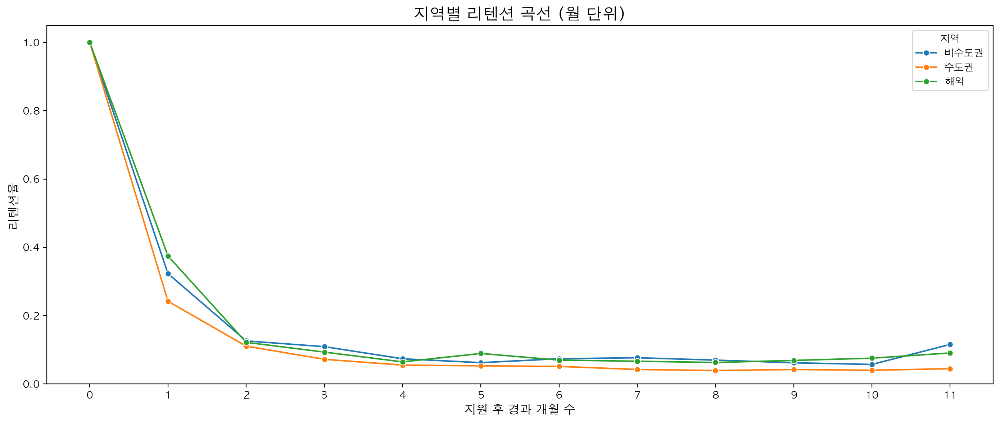

In [240]:
plt.rcParams['font.family'] = 'AppleGothic'
plt.rcParams['axes.unicode_minus'] = False  # 마이너스 부호 깨짐 방지

plt.figure(figsize=(14, 6))

sns.lineplot(
    data=retention,
    x="month_diff",
    y="retention_rate",
    hue="region",
    marker="o",
    estimator="mean",
    ci=None
)

plt.title("지역별 리텐션 곡선 (월 단위)", fontsize=16)
plt.xlabel("지원 후 경과 개월 수", fontsize=12)
plt.ylabel("리텐션율", fontsize=12)
plt.legend(title="지역", fontsize=10)
plt.xticks(range(retention["month_diff"].max()+1))
plt.ylim(0, 1.05)
plt.tight_layout()
plt.show()

### 인사이트 💎

1. 수도권 기업 비중은 매우 높지만, 리텐션은 가장 낮다
- 지원 비율: 약 88.6%로 압도적
- 그러나 1개월 후 평균 리텐션율은 비교적 낮은 편
- 수도권 채용공고가 많아 유입은 되지만, 지속적인 관심이나 재지원까지 이어지는 비율은 낮음
- 지금 현재 상황은 서울의 물가, 부동산 가격이 다른 비수도권보다 매우 비싼 경향이 있음.
- 따라서 지원자들이 그것이 부담이 되어 서울이 아닌 다른 지역으로 눈 돌리는 상황이 있을것이라고 예상이 됨

2. 비수도권은 지원 비중은 낮지만, 리텐션은 중간 이상
- 비수도권 기업에 대한 **지원 비중은 약 9.0%**로 낮은 편이다.
- 이는 비수도권 공고 수 자체가 수도권보다 적기 때문에 자연스럽게 발생한 결과로 보인다.
- 그러나 1개월 후 리텐션율은 수도권보다 높은 수준으로, 유입된 사용자 중 상당수가 이후에도 해당 지역 공고에 지속적으로 관심을 가지는 경향이 확인된다.
- 이는 비수도권 거주자들이 실질적인 근무 가능성을 고려해 자발적으로 공고를 탐색하고 지원한 결과로 해석될 수 있다.
- 즉, 지리적 제약이나 거주 기반의 실질적 선호도가 반영된 사용자 행동이 리텐션으로 이어진 것으로 보임.

3. 해외 기업 근무지는 지원 비중은 적지만, 리텐션은 가장 높음
- 지원 비율: 약 2.4%로 극소수
- 그러나 1개월 후 평균 리텐션율은 가장 높음
- 관심 있는 사용자가 명확하게 타겟팅 되어 있음
- 해외 기업을 찾는 유저는 명확한 목적을 가진 충성도 높은 유저!

## 채용형태애 따른 지원서 작성률 리텐션

### 채용 형태별 지원 비율

In [241]:
application_ret_copy2 = application_ret.copy()

In [242]:
job_df.head(1)

,cdate,mdate,job_field,career_type_string,start_date,end_date,allow_remote,can_show_salary,job_uuid,company_uuid
0,2020-11-25 10:32:10,2020-11-25 10:32:10,SW 개발,"신입,경력,인턴",NaT,2020-11-25,1,0,764292b0-53f8-4f14-ac83-6eafc7a6a18d,daa34559-fc42-47f6-b5c6-cc6171404f37


In [243]:
application_ret_copy2 = application_ret_copy2.merge(job_df[['job_uuid', 'career_type_string']], on='job_uuid', how='left')

In [244]:
application_ret_copy2.head()

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,application_month,first_month,month_diff,career_type_string
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,경력
1,2022-01-10 06:27:37.459987,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,332926ba-57aa-4b8f-ad55-316f56911c5a,2022-01,2022-01,0,"신입,경력"
2,2022-01-10 07:19:30.924181,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,dd4a186d-1e73-4123-8097-5c33b128ffb2,2022-01,2022-01,0,"신입,경력"
3,2022-01-10 10:59:26.452561,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,4d5bedd2-5b63-4d05-a7b3-d74e45f61cd0,2022-01,2022-01,0,"신입,경력"
4,2022-08-21 08:48:00.305915,2022,8,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,067bb1a8-ee8f-4bd2-97fa-0e39321ab797,2022-08,2022-01,7,"신입,경력"


In [245]:
apply_by_career_type = application_ret_copy2['career_type_string'].value_counts(normalize=True).reset_index()
apply_by_career_type['proportion'] = apply_by_career_type['proportion'] * 100
apply_by_career_type

,career_type_string,proportion
0,"신입,경력",40.692932
1,경력,37.297855
2,"신입,경력,인턴",12.462210
3,신입,4.522770
4,인턴,2.644081
5,"신입,인턴",2.255387
6,"경력,인턴",0.124766


/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/3067693736.py:2: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.barplot(


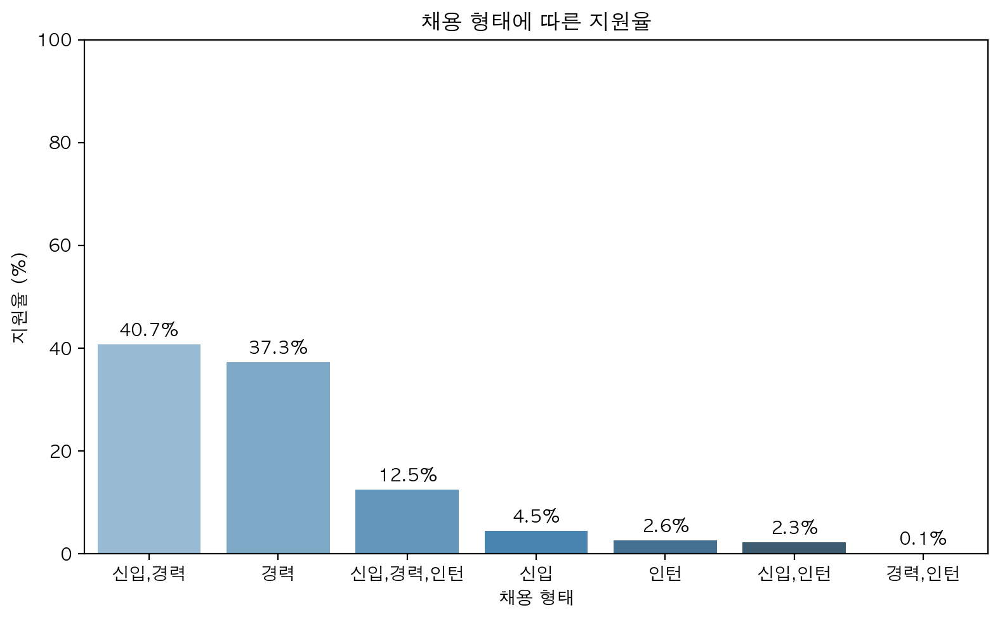

In [246]:
plt.figure(figsize=(8, 5))
ax = sns.barplot(
    data=apply_by_career_type,
    x='career_type_string',
    y='proportion',
    palette='Blues_d'
)

# ▶ 모든 바 위에 값 수동 표시
for patch in ax.patches:
    height = patch.get_height()
    ax.text(
        patch.get_x() + patch.get_width() / 2,
        height + 1,
        f'{height:.1f}%',
        ha='center',
        va='bottom',
        fontsize=10
    )

plt.title('채용 형태에 따른 지원율')
plt.xlabel('채용 형태')
plt.ylabel('지원율 (%)')
plt.ylim(0, 100)
plt.tight_layout()
plt.show()


### 채용 형태별 리텐션 비교

In [247]:
application_ret_copy2.head()

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,application_month,first_month,month_diff,career_type_string
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,경력
1,2022-01-10 06:27:37.459987,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,332926ba-57aa-4b8f-ad55-316f56911c5a,2022-01,2022-01,0,"신입,경력"
2,2022-01-10 07:19:30.924181,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,dd4a186d-1e73-4123-8097-5c33b128ffb2,2022-01,2022-01,0,"신입,경력"
3,2022-01-10 10:59:26.452561,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,4d5bedd2-5b63-4d05-a7b3-d74e45f61cd0,2022-01,2022-01,0,"신입,경력"
4,2022-08-21 08:48:00.305915,2022,8,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,067bb1a8-ee8f-4bd2-97fa-0e39321ab797,2022-08,2022-01,7,"신입,경력"


In [248]:
retention_by_carrer = application_ret_copy2.groupby(['career_type_string', 'first_month', 'month_diff'])['user_uuid'].nunique().reset_index()
retention_by_carrer

,career_type_string,first_month,month_diff,user_uuid
0,경력,2022-01,0,450
1,경력,2022-01,1,138
2,경력,2022-01,2,85
3,경력,2022-01,3,59
4,경력,2022-01,4,51
...,...,...,...,...
471,인턴,2022-10,1,6
472,인턴,2022-10,2,1
473,인턴,2022-11,0,38
474,인턴,2022-11,1,6


In [249]:
initial_users_by_carrer = retention_by_carrer[retention_by_carrer['month_diff'] == 0][['career_type_string', 'first_month', 'user_uuid']]
initial_users_by_carrer.rename(columns={'user_uuid': 'initial_users'}, inplace=True)

In [250]:
retention_by_carrer = retention_by_carrer.merge(initial_users_by_carrer, on=['career_type_string', 'first_month'])
retention_by_carrer

,career_type_string,first_month,month_diff,user_uuid,initial_users
0,경력,2022-01,0,450,450
1,경력,2022-01,1,138,450
2,경력,2022-01,2,85,450
3,경력,2022-01,3,59,450
4,경력,2022-01,4,51,450
...,...,...,...,...,...
470,인턴,2022-10,1,6,34
471,인턴,2022-10,2,1,34
472,인턴,2022-11,0,38,38
473,인턴,2022-11,1,6,38


In [251]:
retention_by_carrer['retention_rate'] = retention_by_carrer['user_uuid'] / retention_by_carrer['initial_users']
retention_by_carrer

,career_type_string,first_month,month_diff,user_uuid,initial_users,retention_rate
0,경력,2022-01,0,450,450,1.000000
1,경력,2022-01,1,138,450,0.306667
2,경력,2022-01,2,85,450,0.188889
3,경력,2022-01,3,59,450,0.131111
4,경력,2022-01,4,51,450,0.113333
...,...,...,...,...,...,...
470,인턴,2022-10,1,6,34,0.176471
471,인턴,2022-10,2,1,34,0.029412
472,인턴,2022-11,0,38,38,1.000000
473,인턴,2022-11,1,6,38,0.157895


In [252]:
retention_by_carrer = retention_by_carrer[retention_by_carrer['career_type_string'] != '경력,인턴']

In [253]:
retention_by_carrer

,career_type_string,first_month,month_diff,user_uuid,initial_users,retention_rate
0,경력,2022-01,0,450,450,1.000000
1,경력,2022-01,1,138,450,0.306667
2,경력,2022-01,2,85,450,0.188889
3,경력,2022-01,3,59,450,0.131111
4,경력,2022-01,4,51,450,0.113333
...,...,...,...,...,...,...
470,인턴,2022-10,1,6,34,0.176471
471,인턴,2022-10,2,1,34,0.029412
472,인턴,2022-11,0,38,38,1.000000
473,인턴,2022-11,1,6,38,0.157895


In [254]:
first_month_retention = retention_by_carrer[retention_by_carrer['month_diff'] == 1]


/var/folders/02/v1rq6jm14fg164k6r6ddjgvw0000gn/T/ipykernel_8068/48901259.py:3: FutureWarning: 

The `ci` parameter is deprecated. Use `errorbar=None` for the same effect.

  sns.lineplot(


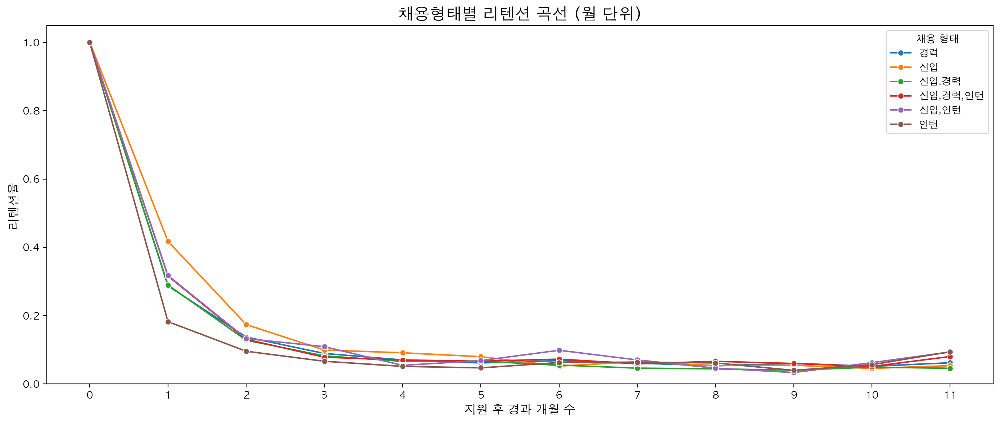

In [255]:
plt.figure(figsize=(14, 6))

sns.lineplot(
    data=retention_by_carrer,
    x="month_diff",
    y="retention_rate",
    hue="career_type_string",
    marker="o",
    estimator="mean",
    ci=None
)

plt.title("채용형태별 리텐션 곡선 (월 단위)", fontsize=16)
plt.xlabel("지원 후 경과 개월 수", fontsize=12)
plt.ylabel("리텐션율", fontsize=12)
plt.legend(title="채용 형태", fontsize=10)
plt.xticks(range(retention["month_diff"].max()+1))
plt.ylim(0, 1.05)
plt.tight_layout()
plt.show()

In [256]:
job_counts = job_df.explode('career_type_string').groupby('career_type_string')['job_uuid'].count().reset_index(name='공고 수')
job_counts

,career_type_string,공고 수
0,경력,74682
1,"경력,인턴",1101
2,신입,3274
3,"신입,경력",36529
4,"신입,경력,인턴",20928
5,"신입,인턴",3373
6,인턴,4360


In [257]:
# job_id에 따라 career_type_string을 연결
job_app = application_df.merge(job_df[['job_uuid', 'career_type_string']])

# 복수형태 처리
job_app = job_app.explode('career_type_string')
application_counts = job_app.groupby('career_type_string')['job_uuid'].count().reset_index(name='지원서 수')

In [258]:
application_counts

,career_type_string,지원서 수
0,경력,133964
1,"경력,인턴",1489
2,신입,9327
3,"신입,경력",119464
4,"신입,경력,인턴",49835
5,"신입,인턴",8436
6,인턴,8673


In [259]:
result = pd.merge(job_counts, application_counts, on='career_type_string', how='outer')
result['공고당 평균 지원서 수'] = result['지원서 수'] / result['공고 수']
result = result.sort_values('공고당 평균 지원서 수', ascending=False)
result

,career_type_string,공고 수,지원서 수,공고당 평균 지원서 수
3,"신입,경력",36529,119464,3.270388
2,신입,3274,9327,2.848809
5,"신입,인턴",3373,8436,2.501038
4,"신입,경력,인턴",20928,49835,2.381260
6,인턴,4360,8673,1.989220
0,경력,74682,133964,1.793792
1,"경력,인턴",1101,1489,1.352407


### 인사이트 💎


- **혼합형태**(신입+경력) 공고의 지원 집중도가 가장 높다.
    
    → 지원자들이 경력자 중심 공고보다 문이 더 넓은 형태에 매력을 느낀다고 해석할 수 있음
    
- 순수 경력 공고는 공고 수는 가장 많지만, 공고당 지원서 수는 가장 낮은 축이다.
    
    → 기업 입장에서 경력자 채용은 수요가 크지만, 지원자는 분산되어 있음을 의미함.
    
- 인턴 단독 공고는 그 자체만 놓고 보면 평균 지원서 수는 낮지만,
    
    신입 + 인턴 즉 채용 연계형 혼합된 공고에서는 비교적 높은 수치를 기록함
    
- 혼합 형태가 리텐션 측면에서도 더 우수한 경향이 있음.
- 지원자들이 지속적으로 공고를 탐색하고, 나중에라도 다시 지원할 가능성이 있는 형태가 혼합형!

## 북마크 여부에 따른 지원서 작성률 리텐션

In [260]:
application_ret_by_bookmark = application_ret.copy()

In [261]:
job_bookmark_df.head(1)

,cdate,job_uuid,user_uuid
0,2018-02-11 22:17:43,e9d423cb-2b66-4c9a-83a2-4f808bb9c8db,2a4f7d22-716c-4417-b00f-e081cd33296b


In [262]:
bookmark_flag = job_bookmark_df[['user_uuid', 'job_uuid']]
bookmark_flag['bookmarked'] = 1

In [263]:
retention_by_bookmark = application_ret_by_bookmark.merge(bookmark_flag, on=['user_uuid', 'job_uuid'], how='left')
retention_by_bookmark

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,application_month,first_month,month_diff,bookmarked
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,NaN
1,2022-01-10 06:27:37.459987,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,332926ba-57aa-4b8f-ad55-316f56911c5a,2022-01,2022-01,0,NaN
2,2022-01-10 07:19:30.924181,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,dd4a186d-1e73-4123-8097-5c33b128ffb2,2022-01,2022-01,0,NaN
3,2022-01-10 10:59:26.452561,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,4d5bedd2-5b63-4d05-a7b3-d74e45f61cd0,2022-01,2022-01,0,NaN
4,2022-08-21 08:48:00.305915,2022,8,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,067bb1a8-ee8f-4bd2-97fa-0e39321ab797,2022-08,2022-01,7,NaN
...,...,...,...,...,...,...,...,...,...,...,...
42599,2022-07-09 15:26:41.074115,2022,7,0ea7ae45-4d19-4cdc-b2ce-1ee6b9189fbb,4413312a-84b4-490f-aa9b-b5f919146469,6b23abd1-589b-4bf2-bbc3-4c7c475687a2,149e930b-2da2-4c8f-8931-bb90a9556763,2022-07,2022-07,0,NaN
42600,2022-06-28 12:35:20.601121,2022,6,1f78ba83-0862-400a-9450-7438de6dd53c,0baa07ef-5808-4ced-8719-aa928b91cafd,bdfebb58-6ebe-4124-8679-de9d5c266dbb,64c29614-9b79-4462-9fd6-e4d93a0cd8dc,2022-06,2022-06,0,NaN
42601,2022-03-20 22:21:29.175182,2022,3,214c0ee9-4fc9-46be-ba8a-2a0368510e80,a82d7bd3-87ee-4eaf-9519-1b60a331a474,dc1fb548-59dd-47bc-82aa-99d92e70f793,0ab0adef-da09-4381-baf7-a3fb017c19ea,2022-03,2022-03,0,NaN
42602,2022-04-07 09:41:05.036134,2022,4,565e7499-1070-49c5-a3b9-a27e5ca27a9e,744ab632-8193-406a-bd51-3e2c9ddd4544,1e311075-359d-40fd-b606-f74cb1819499,bbd1050f-3729-45d9-8404-c8ad75dc5131,2022-04,2022-04,0,1.0


In [264]:
retention_by_bookmark['bookmarked'] = retention_by_bookmark['bookmarked'].fillna(0)
retention_by_bookmark.head(5)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid,application_month,first_month,month_diff,bookmarked
0,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a,2022-01,2022-01,0,0.0
1,2022-01-10 06:27:37.459987,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,332926ba-57aa-4b8f-ad55-316f56911c5a,2022-01,2022-01,0,0.0
2,2022-01-10 07:19:30.924181,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,dd4a186d-1e73-4123-8097-5c33b128ffb2,2022-01,2022-01,0,0.0
3,2022-01-10 10:59:26.452561,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,4d5bedd2-5b63-4d05-a7b3-d74e45f61cd0,2022-01,2022-01,0,0.0
4,2022-08-21 08:48:00.305915,2022,8,de4b3596-b4ab-47cd-b8ea-6f9e14170064,d4462e55-8358-4464-a85f-133138fbaf05,2ece8d7d-79b6-4522-928b-8dbae8843fab,067bb1a8-ee8f-4bd2-97fa-0e39321ab797,2022-08,2022-01,7,0.0


In [265]:
retention_by_bookmark = retention_by_bookmark.groupby(['bookmarked', 'first_month', 'month_diff'])['user_uuid'].nunique().reset_index()
retention_by_bookmark

,bookmarked,first_month,month_diff,user_uuid
0,0.0,2022-01,0,753
1,0.0,2022-01,1,212
2,0.0,2022-01,2,123
3,0.0,2022-01,3,92
4,0.0,2022-01,4,78
...,...,...,...,...
151,1.0,2022-10,1,19
152,1.0,2022-10,2,12
153,1.0,2022-11,0,94
154,1.0,2022-11,1,29


In [266]:
initial_users_by_bookmark = retention_by_bookmark[retention_by_bookmark['month_diff'] == 0][['bookmarked', 'first_month', 'user_uuid']]
initial_users_by_bookmark.rename(columns={'user_uuid': 'initial_users'}, inplace=True)
initial_users_by_bookmark

,bookmarked,first_month,initial_users
0,0.0,2022-01,753
12,0.0,2022-02,491
23,0.0,2022-03,513
33,0.0,2022-04,489
42,0.0,2022-05,439
50,0.0,2022-06,379
57,0.0,2022-07,335
63,0.0,2022-08,346
68,0.0,2022-09,280
72,0.0,2022-10,273


In [267]:
retention_by_bookmark = retention_by_bookmark.merge(initial_users_by_bookmark, on=['bookmarked', 'first_month'], how='left')

In [268]:
retention_by_bookmark['retention_rate'] = retention_by_bookmark['user_uuid'] / retention_by_bookmark['initial_users'] * 100
retention_by_bookmark

,bookmarked,first_month,month_diff,user_uuid,initial_users,retention_rate
0,0.0,2022-01,0,753,753,100.000000
1,0.0,2022-01,1,212,753,28.154050
2,0.0,2022-01,2,123,753,16.334661
3,0.0,2022-01,3,92,753,12.217795
4,0.0,2022-01,4,78,753,10.358566
...,...,...,...,...,...,...
151,1.0,2022-10,1,19,84,22.619048
152,1.0,2022-10,2,12,84,14.285714
153,1.0,2022-11,0,94,94,100.000000
154,1.0,2022-11,1,29,94,30.851064


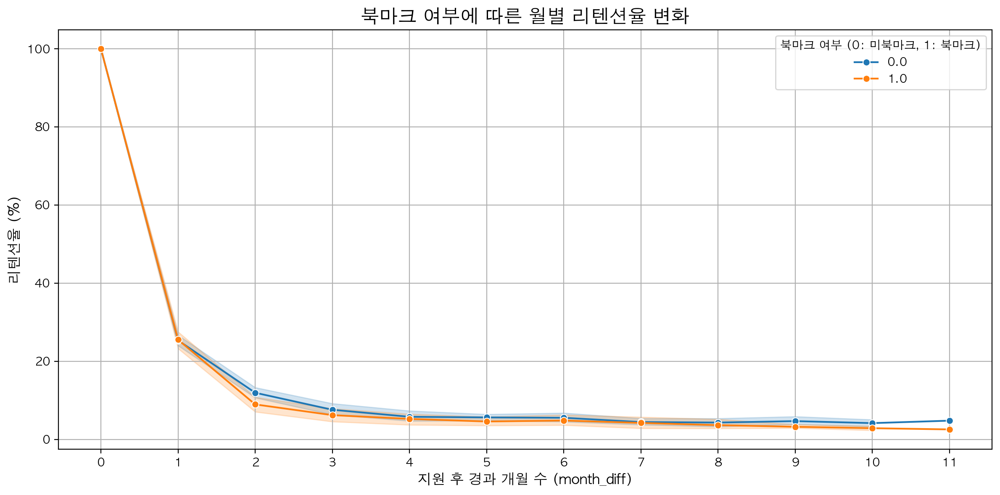

In [269]:
plt.figure(figsize=(12, 6))
sns.lineplot(data=retention_by_bookmark, x='month_diff', y='retention_rate', hue='bookmarked', marker='o', estimator='mean')

# 레이블 및 제목
plt.title('북마크 여부에 따른 월별 리텐션율 변화', fontsize=16)
plt.xlabel('지원 후 경과 개월 수 (month_diff)', fontsize=12)
plt.ylabel('리텐션율 (%)', fontsize=12)
plt.legend(title='북마크 여부 (0: 미북마크, 1: 북마크)')
plt.grid(True)
plt.xticks(range(retention_by_bookmark['month_diff'].max() + 1))  # month_diff 범위 지정
plt.tight_layout()
plt.show()

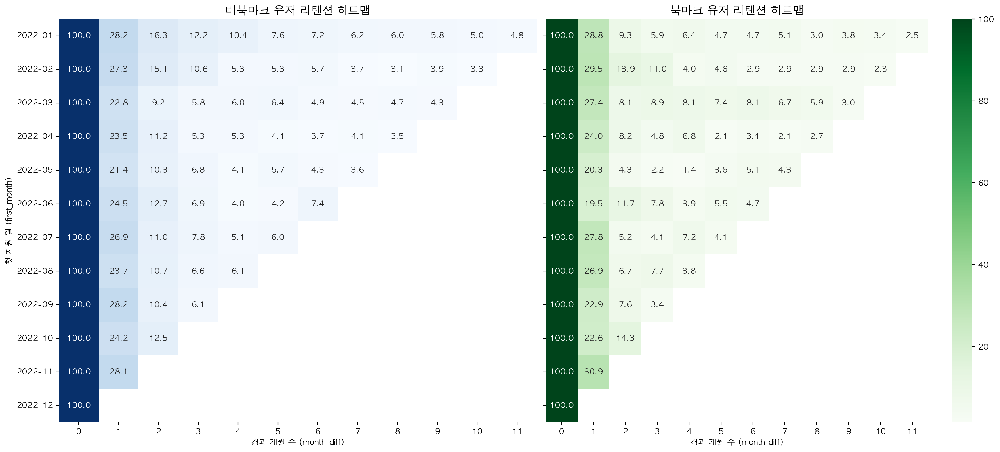

In [270]:
pivot_0 = retention_by_bookmark[retention_by_bookmark['bookmarked'] == 0].pivot(index='first_month', columns='month_diff', values='retention_rate')
pivot_1 = retention_by_bookmark[retention_by_bookmark['bookmarked'] == 1].pivot(index='first_month', columns='month_diff', values='retention_rate')


fig, axes = plt.subplots(1, 2, figsize=(18, 8), sharey=True)

sns.heatmap(pivot_0, ax=axes[0], cmap='Blues', annot=True, fmt='.1f', cbar=False)
axes[0].set_title('비북마크 유저 리텐션 히트맵', fontsize=14)
axes[0].set_xlabel('경과 개월 수 (month_diff)')
axes[0].set_ylabel('첫 지원 월 (first_month)')

sns.heatmap(pivot_1, ax=axes[1], cmap='Greens', annot=True, fmt='.1f')
axes[1].set_title('북마크 유저 리텐션 히트맵', fontsize=14)
axes[1].set_xlabel('경과 개월 수 (month_diff)')
axes[1].set_ylabel('')

plt.tight_layout()
plt.show()

### 인사이트 💎

- 1개월 경과 시점까지는

    → 북마크 여부에 따라 리텐션율이 거의 비슷하거나 큰 차이가 없음
- 2개월차 이후부터는 점차 미세한 차이 발생
    
    → 북마크를 하지 않은 사용자들의 리텐션이 북마크를 한 사용자보다 조금 더 높은 경향을 보임
- 북마크 여부는 초기 관심도의 지표일 수는 있지만, 지속 이용과는 연결되지 않음
    - 북마크가 충성도 있는 행동이 아니라 일시적인 관심 표현일 수 있음

# 퍼널 분석

In [271]:
log_df['date'].max()

'2023-12-31'

In [272]:
log_df_copy = log_df.copy()

## 1단계. 전체 방문자수

In [273]:
total_visitors_by_funnel = log_df_copy['user_uuid'].nunique()
total_visitors_by_funnel

21348

## 2단게. 상세페이지 진입 유저수

In [274]:
detail_page_df = log_df_copy[log_df_copy['URL'].str.contains(r'jobs/id/id_title')]

In [275]:
detail_page_users = detail_page_df['user_uuid'].nunique()
detail_page_users

16413

## 3단계. 지원서 작성 유저수

In [276]:
apply_start_df = log_df_copy[log_df_copy["URL"].str.contains('/apply/step1', na=False)]
apply_start_df

,user_uuid,URL,timestamp,date,response_code,method
45,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/jobs/id/apply/step1,2022-06-22 16:26:30.617417+00:00,2022-06-23,200,POST
50,8a7e70cd-1630-4a8a-8303-0706af3a7908,jobs/id/apply/step1,2022-06-22 16:21:29.687333+00:00,2022-06-23,200,GET
170,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/jobs/id/apply/step1,2022-06-22 16:34:10.840796+00:00,2022-06-23,200,POST
192,8a7e70cd-1630-4a8a-8303-0706af3a7908,jobs/id/apply/step1,2022-06-22 16:26:40.444614+00:00,2022-06-23,200,GET
515,d7c84302-545f-4714-bcd1-0cc4328a0f89,api/jobs/id/apply/step1,2022-08-12 05:12:36.950432+00:00,2022-08-12,200,POST
...,...,...,...,...,...,...
17241258,5672a6a1-a31f-4bdb-8c8c-2b8983f18151,jobs/id/apply/step1,2023-11-14 06:01:17.383668+00:00,2023-11-14,200,GET
17241268,5672a6a1-a31f-4bdb-8c8c-2b8983f18151,continue?next=/jobs/147031/apply/step1,2023-11-14 06:01:17.170425+00:00,2023-11-14,302,GET
17241638,45b042c6-f606-40ec-9018-d10e691c4a64,jobs/id/apply/step1,2023-11-08 10:00:49.740559+00:00,2023-11-08,200,GET
17241667,c427e3fa-bdd3-4382-b25e-c1f8c5a77923,continue?next=/jobs/146634/apply/step1,2023-11-08 00:29:37.304417+00:00,2023-11-08,302,GET


In [277]:
apply_start_users = apply_start_df['user_uuid'].nunique()
apply_start_users

11592

## 4단계 지원서 제출완료

In [278]:
application_copy = application_df.copy()

In [279]:
application_copy = application_copy[(application_copy['Year'] == 2022) | (application_copy['Year'] == 2023)]

In [280]:
application_copy.head(1)

,cdate,Year,Month,company_uuid,job_uuid,user_uuid,application_uuid
163,2022-01-23 10:50:16.154941,2022,1,de4b3596-b4ab-47cd-b8ea-6f9e14170064,bc4a29a5-644b-479a-8280-b55c55e0f145,2ece8d7d-79b6-4522-928b-8dbae8843fab,183af487-0e1f-44c8-9253-c0335de1310a


In [281]:
submitted_users_df = pd.merge(
    apply_start_df[['user_uuid']],
    application_copy[['user_uuid']],
    on='user_uuid',
    how='inner'
)

In [282]:
submitted_users_df

,user_uuid
0,8a7e70cd-1630-4a8a-8303-0706af3a7908
1,8a7e70cd-1630-4a8a-8303-0706af3a7908
2,8a7e70cd-1630-4a8a-8303-0706af3a7908
3,8a7e70cd-1630-4a8a-8303-0706af3a7908
4,d7c84302-545f-4714-bcd1-0cc4328a0f89
...,...
20583675,5672a6a1-a31f-4bdb-8c8c-2b8983f18151
20583676,5672a6a1-a31f-4bdb-8c8c-2b8983f18151
20583677,5672a6a1-a31f-4bdb-8c8c-2b8983f18151
20583678,5672a6a1-a31f-4bdb-8c8c-2b8983f18151


In [283]:
'''
apply_success_df = application_df[(application_df['Year'] == 2022) | (application_df['Year'] == 2023)]
apply_success_df.sample(4)
'''

"\napply_success_df = application_df[(application_df['Year'] == 2022) | (application_df['Year'] == 2023)]\napply_success_df.sample(4)\n"

In [284]:
apply_success_users = submitted_users_df['user_uuid'].nunique()
apply_success_users

10259

## 전환율!

In [285]:
step0_conversion_rate = total_visitors_by_funnel / total_visitors_by_funnel * 100
step1_conversion_rate = detail_page_users / total_visitors_by_funnel * 100
step2_conversion_rate = apply_start_users / detail_page_users * 100
step3_conversion_rate = apply_success_users / apply_start_users * 100
step1_conversion_rate, step2_conversion_rate, step3_conversion_rate

(76.88308038223721, 70.62694205812465, 88.50069013112491)

In [286]:
# 단계별 값 (0부터 시작하는 값)
funnel_data = {
    "Step": ['전체 방문자', '상세페이지 진입', '지원서 작성 시작', '지원서 제출 완료'],
    "Conversion Rate (%)": [
        step0_conversion_rate,
        step1_conversion_rate,
        step2_conversion_rate,
        step3_conversion_rate
    ],
}

# 데이터프레임 생성
funnel_df = pd.DataFrame(funnel_data)

# 단계 순서대로 설정
funnel_df['Step'] = pd.Categorical(funnel_df['Step'], categories=['전체 방문자', '상세페이지 진입', '지원서 작성 시작', '지원서 제출 완료'], ordered=True)

# 퍼널 차트 그리기
fig = px.funnel(funnel_df, x="Conversion Rate (%)", y="Step", title="전체 유저의 퍼널 전환율")
fig.update_layout(yaxis={'categoryorder':'array'}, title_x=0.5)
fig.show()

# 북마크를 안한 유저 퍼널분석

In [287]:
job_bookmark_df.head(1)

,cdate,job_uuid,user_uuid
0,2018-02-11 22:17:43,e9d423cb-2b66-4c9a-83a2-4f808bb9c8db,2a4f7d22-716c-4417-b00f-e081cd33296b


In [288]:
job_bookmark_df['year'] = job_bookmark_df['cdate'].dt.year

In [289]:
job_bookmark_df.head(1)

,cdate,job_uuid,user_uuid,year
0,2018-02-11 22:17:43,e9d423cb-2b66-4c9a-83a2-4f808bb9c8db,2a4f7d22-716c-4417-b00f-e081cd33296b,2018


In [290]:
funnel_bookmark_df = job_bookmark_df[(job_bookmark_df['year'] == 2022) | (job_bookmark_df['year'] == 2023)]

In [291]:
funnel_bookmark_df

,cdate,job_uuid,user_uuid,year
47,2022-07-04 10:27:32,0b179f5f-dc22-462b-ac7f-9bd19a87c5ad,06d05db7-3c5f-4616-896f-286414ea3e6f,2022
96,2023-02-03 03:28:55,7ad4ea23-e022-4589-8d89-756153675ef1,0eec3780-6ee8-4ec6-9802-52c0e2a4f47d,2023
143,2023-02-03 03:30:59,62af11b9-0254-4d62-a920-baf97d157075,0eec3780-6ee8-4ec6-9802-52c0e2a4f47d,2023
150,2023-02-23 05:48:02,82c3ca55-971d-4a65-9055-bb5534976b67,0eec3780-6ee8-4ec6-9802-52c0e2a4f47d,2023
213,2023-02-23 05:42:08,00d1236a-7cc0-4fcb-be3a-d3b8c95ea8cf,0eec3780-6ee8-4ec6-9802-52c0e2a4f47d,2023
...,...,...,...,...
413838,2022-06-04 10:07:16,49304510-00cf-455f-9bde-de088fab214c,5b5e6457-de3f-42f4-9083-37331519f119,2022
413840,2022-01-12 08:24:51,7dc96475-b8fa-4f95-98c8-95cc5966b0a2,155f7b93-d521-465d-b7a5-6a7ec2d2db93,2022
413859,2022-03-29 05:25:10,ccb1878f-5dba-4bde-a0af-29f6d9ee8432,6050cb4f-27b5-4c80-9a55-68a999012262,2022
413860,2022-06-07 09:23:28,03f1d118-22e3-4659-aa66-565d3e963176,4974ae24-d946-4bd2-9114-94c2a5970338,2022


In [292]:
# 북마크한 유저 리스트 추출
bookmark_users = funnel_bookmark_df['user_uuid'].unique()

# 북마크 안 한 유저만 필터링
non_bookmark_df = log_df[~log_df['user_uuid'].isin(bookmark_users)]

## 1단계. 전체 방문자수

In [ ]:
total_visitors_by_non_book = non_bookmark_df['user_uuid'].nunique()
print(total_visitors_by_non_book)

14433


## 2단계. 상세페이지 진입 유저수

In [294]:
detail_page_by_non_book = non_bookmark_df[non_bookmark_df['URL'].str.contains(r'jobs/id/id_title')]

In [295]:
detail_page_by_non_book_users = detail_page_by_non_book['user_uuid'].nunique()
detail_page_by_non_book_users

9610

## 3단계. 지원서 작성 유저수

In [296]:
apply_start_by_non_book = non_bookmark_df[non_bookmark_df['URL'].str.contains('/apply/step1', na=False)]

In [297]:
apply_start_by_non_book_users = apply_start_by_non_book['user_uuid'].nunique()
apply_start_by_non_book_users

5436

## 4단계. 지원서 제출완료 유저수

In [298]:
# 지원서 제출을 한 유저 리스트 추출
application_users = application_copy['user_uuid'].unique()

In [299]:
# 북마크 안하고 지원서을 제출한 유저 필터링
apply_success_by_non_book = non_bookmark_df[non_bookmark_df['user_uuid'].isin(application_users)]
apply_success_by_non_book

,user_uuid,URL,timestamp,date,response_code,method
0,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/search/language?name=한국어&_=1655915651225,2022-06-22 16:42:48.247454+00:00,2022-06-23,200,GET
1,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/signup/form,2022-06-22 16:19:07.770741+00:00,2022-06-23,200,POST
2,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/template,2022-06-22 16:41:54.449837+00:00,2022-06-23,200,POST
3,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/template,2022-06-23 02:53:47.040932+00:00,2022-06-23,200,POST
4,8a7e70cd-1630-4a8a-8303-0706af3a7908,api/users/id/phone/verify/template?_=165591488...,2022-06-22 16:21:58.154299+00:00,2022-06-23,200,GET
...,...,...,...,...,...,...
17241853,37ba477a-ff00-4501-bc3f-7640cf63c009,api/recommend_specialty,2023-11-14 01:06:24.053732+00:00,2023-11-14,200,POST
17241854,37ba477a-ff00-4501-bc3f-7640cf63c009,api/users/id/form,2023-11-14 01:04:23.287191+00:00,2023-11-14,200,POST
17241855,37ba477a-ff00-4501-bc3f-7640cf63c009,api/users/id/form,2023-11-14 01:05:27.225697+00:00,2023-11-14,200,POST
17241856,37ba477a-ff00-4501-bc3f-7640cf63c009,api/users/id/template,2023-11-14 01:06:24.125595+00:00,2023-11-14,200,POST


In [300]:
apply_success_by_non_book_users = apply_success_by_non_book['user_uuid'].nunique()
apply_success_by_non_book_users

4682

## 전환율!

In [301]:
step0_conversion_rate_by_non_book = total_visitors_by_non_book / total_visitors_by_non_book * 100
step1_conversion_rate_by_non_book = detail_page_by_non_book_users / total_visitors_by_non_book * 100
step2_conversion_rate_by_non_book = apply_start_by_non_book_users / detail_page_by_non_book_users * 100
step3_conversion_rate_by_non_book = apply_success_by_non_book_users / apply_start_by_non_book_users * 100
step0_conversion_rate_by_non_book, step1_conversion_rate_by_non_book, step2_conversion_rate_by_non_book, step3_conversion_rate_by_non_book

(100.0, 66.58352386891153, 56.56607700312175, 86.12950699043415)

In [302]:
# 단계별 값 (0부터 시작하는 값)
funnel_data = {
    "Step": ['전체 방문자', '상세페이지 진입', '지원서 작성 시작', '지원서 제출 완료'],
    "Conversion Rate (%)": [
        step0_conversion_rate_by_non_book,
        step1_conversion_rate_by_non_book,
        step2_conversion_rate_by_non_book,
        step3_conversion_rate_by_non_book
    ],
}

# 데이터프레임 생성
funnel_df = pd.DataFrame(funnel_data)

# 단계 순서대로 설정
funnel_df['Step'] = pd.Categorical(funnel_df['Step'], categories=['전체 방문자', '상세페이지 진입', '지원서 작성 시작', '지원서 제출 완료'], ordered=True)

# 퍼널 차트 그리기
fig = px.funnel(funnel_df, x="Conversion Rate (%)", y="Step", title="북마크하지 않은 유저의 퍼널 전환율")
fig.update_layout(yaxis={'categoryorder':'array'}, title_x=0.5)
fig.show()

# 북마크를 한 유저 퍼널분석

## 1단계. 전체 방문자수

In [303]:
bookmark_df = log_df[log_df['user_uuid'].isin(bookmark_users)]

In [314]:
total_visitors_by_book = bookmark_df['user_uuid'].nunique()
print(total_visitors_by_book)

6915


## 2단계. 상세페이지 진입 유저수

In [305]:
detail_page_by_book = bookmark_df[bookmark_df['URL'].str.contains(r'jobs/id/id_title')]

In [306]:
detail_page_by_book_users = detail_page_by_book['user_uuid'].nunique()
detail_page_by_book_users

6803

## 3단계. 지원서 작성 유저수

In [307]:
apply_start_by_book = bookmark_df[bookmark_df['URL'].str.contains('/apply/step1', na=False)]

In [308]:
apply_start_by_book_users = apply_start_by_book['user_uuid'].nunique()
apply_start_by_book_users

6156

## 4단계. 지원서 제출완료 유저수

In [312]:
apply_success_by_book = bookmark_df[bookmark_df['user_uuid'].isin(application_users)]
apply_success_by_book

,user_uuid,URL,timestamp,date,response_code,method
507,d7c84302-545f-4714-bcd1-0cc4328a0f89,api/search/product?name=바이브&_=1655940066721,2022-06-22 23:23:01.449884+00:00,2022-06-23,200,GET
508,d7c84302-545f-4714-bcd1-0cc4328a0f89,api/search/product?name=바이브러리-모바일우&_=165594006...,2022-06-22 23:23:11.424866+00:00,2022-06-23,200,GET
509,d7c84302-545f-4714-bcd1-0cc4328a0f89,api/search/specialty?name=스,2022-06-22 23:23:54.240517+00:00,2022-06-23,200,GET
510,d7c84302-545f-4714-bcd1-0cc4328a0f89,api/users/id/project,2022-06-22 23:24:53.908412+00:00,2022-06-23,200,POST
511,d7c84302-545f-4714-bcd1-0cc4328a0f89,api/users/id/career/id,2022-06-22 23:22:32.257595+00:00,2022-06-23,200,PUT
...,...,...,...,...,...,...
17241690,91db7a82-57dd-449b-9cf3-b806745a3027,api/current_guided_action/id,2023-11-08 06:13:35.492481+00:00,2023-11-08,200,POST
17241691,91db7a82-57dd-449b-9cf3-b806745a3027,api/users/id/template,2023-11-08 06:13:35.806698+00:00,2023-11-08,200,POST
17241806,139e6f4b-4b60-437f-bf16-1ced345f6c3c,setting?utm_source=notification&utm_medium=ema...,2023-11-14 07:53:43.463910+00:00,2023-11-14,200,GET
17241808,139e6f4b-4b60-437f-bf16-1ced345f6c3c,api/users/email/settings,2023-11-14 07:53:53.600804+00:00,2023-11-14,200,POST


In [313]:
apply_success_by_book_users = apply_success_by_book['user_uuid'].nunique()
apply_success_by_book_users

5602

## 전환율!

In [315]:
step0_conversion_rate_by_book = total_visitors_by_book / total_visitors_by_book * 100
step1_conversion_rate_by_book = detail_page_by_book_users / total_visitors_by_book * 100
step2_conversion_rate_by_book = apply_start_by_book_users / detail_page_by_book_users * 100
step3_conversion_rate_by_book = apply_success_by_book_users / apply_start_by_book_users * 100
step0_conversion_rate_by_book, step1_conversion_rate_by_book, step2_conversion_rate_by_book, step3_conversion_rate_by_book

(100.0, 98.38033261026753, 90.48948993091284, 91.0006497725796)

In [316]:
# 단계별 값 (0부터 시작하는 값)
funnel_data = {
    "Step": ['전체 방문자', '상세페이지 진입', '지원서 작성 시작', '지원서 제출 완료'],
    "Conversion Rate (%)": [
        step0_conversion_rate_by_book,
        step1_conversion_rate_by_book,
        step2_conversion_rate_by_book,
        step3_conversion_rate_by_book
    ],
}

# 데이터프레임 생성
funnel_df = pd.DataFrame(funnel_data)

# 단계 순서대로 설정
funnel_df['Step'] = pd.Categorical(funnel_df['Step'], categories=['전체 방문자', '상세페이지 진입', '지원서 작성 시작', '지원서 제출 완료'], ordered=True)

# 퍼널 차트 그리기
fig = px.funnel(funnel_df, x="Conversion Rate (%)", y="Step", title="북마크 유저의 퍼널 전환율")
fig.update_layout(yaxis={'categoryorder':'array'}, title_x=0.5)
fig.show()